# Bond Risk Premia with Machine Learning

This project aims to replicate the findings of the paper "Bond Risk Premia with Machine Learning" by Daniele Bianchi, Matthias Büchner, and Andrea Tamoni (2019). The paper explores the use of various machine learning methods for predicting bond excess returns and measuring bond risk premia.

## Overview

The main objectives of this project are:

1. Implement and compare different machine learning methods for predicting bond excess returns, including:
   - Principal Component Regression (PCR)
   - Partial Least Squares (PLS)
   - Penalized Linear Regressions (Ridge, Lasso, Elastic Net)
   - Regression Trees and Random Forests
   - Neural Networks (Shallow and Deep)

2. Evaluate the out-of-sample predictive performance of these methods using mean squared prediction error (MSPE) and out-of-sample R-squared (R2_oos).

3. Investigate the economic significance of the predictability by calculating Sharpe ratios based on the predicted bond excess returns.

4. Analyze the relative importance of macroeconomic variables in predicting bond excess returns using neural networks.

## Data

The project uses the following datasets:

1. Yield curve data: U.S. Treasury bond yields for different maturities (1-year, 2-year, 3-year, 4-year, 5-year).
2. Macroeconomic variables: A large panel of macroeconomic and financial variables.

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

import os
import joblib
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.cross_decomposition import PLSRegression
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, ExtraTreesRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error
from tqdm import tqdm
from sklearn.pipeline import Pipeline


import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable

# Set the device to CUDA if available, else CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

os.makedirs("Graph", exist_ok=True)

This cell loads a dataset from 'bondprice.dat', converts date information to a 'Year-Month' format, and renames the columns to reflect the bond maturity terms, preparing the data for further analysis.

In [2]:
file_path = 'bondprice.dat'
df = pd.read_csv(file_path, delim_whitespace=True, comment='%', names=['qdate', 'price1', 'price2', 'price3', 'price4', 'price5'])
df['qdate'] = pd.to_datetime(df['qdate'], format='%Y%m%d')
df['qdate'] = df['qdate'].dt.strftime('%Y-%m')
df.columns = ['date', '1 Yr', '2 Yr', '3 Yr', '4 Yr', '5 Yr']
df

,date,1 Yr,2 Yr,3 Yr,4 Yr,5 Yr
0,1952-06,98.178,96.253,94.247,92.634,90.418
1,1952-07,98.095,96.031,93.931,92.309,89.852
2,1952-08,98.058,95.975,93.782,92.146,89.572
3,1952-09,98.031,95.910,93.755,92.096,89.168
4,1952-10,98.111,95.974,93.758,91.929,89.725
...,...,...,...,...,...,...
614,2003-08,98.715,96.142,92.627,88.351,83.881
615,2003-09,98.948,97.113,94.231,90.683,86.577
616,2003-10,98.774,96.417,93.033,89.165,84.796
617,2003-11,98.563,95.991,92.543,88.660,84.416


This cell computes transformed features from bond price data, including log prices, one-period yields, and excess returns for various maturities. It then consolidates these features with the original data, handles any missing values, formats the 'date' column, and sets it as the index for the final `preprocessed_data` DataFrame, ready for time-series analysis.

In [3]:
# List of required bond maturities
required_maturities = ['1 Yr', '2 Yr', '3 Yr', '4 Yr', '5 Yr']

# List of feature columns including bond prices and yields
feature_cols = ['1 Yr', '2 Yr', '3 Yr', '4 Yr', '5 Yr']

# Calculate bond prices for each maturity and add them to the dataframe
bond_prices = pd.DataFrame()
for col in required_maturities:
    years = int(col.split(' ')[0])
    bond_prices[col + '_price'] = np.log(1 / ((1 + df[col] / 100) ** years))
    feature_cols.append(col + '_price')

# Calculate one-period yields for each maturity and add them to the dataframe
one_period_yields = pd.DataFrame()
for col in required_maturities:
    years = int(col.split(' ')[0])
    one_period_yields[col + '_yield'] = bond_prices[col + '_price'] / (-years)
    feature_cols.append(col + '_yield')

# Calculate bond excess returns for each maturity and add them to the dataframe
bond_excess_returns = pd.DataFrame()
for col in required_maturities[1:]:
    years = int(col.split(' ')[0])
    bond_excess_returns[col + '_excess_return'] = -((bond_prices[f'{(years-1)} Yr_price'].shift(-12) - bond_prices[col + '_price'] - one_period_yields['1 Yr_yield']) / years) * 100

# Concatenate all dataframes to create the preprocessed data
preprocessed_data = pd.concat([df, bond_prices, one_period_yields, bond_excess_returns], axis=1)

# Drop rows with missing values
preprocessed_data.dropna(inplace=True)

# Convert 'date' column to datetime format and set it as the index
preprocessed_data['date'] = pd.to_datetime(preprocessed_data['date'])
preprocessed_data['date'] = preprocessed_data['date'].dt.strftime('%Y-%m')
preprocessed_data.set_index('date', inplace=True)

# Display the preprocessed data
preprocessed_data

# forward_rates = pd.DataFrame()
# for i in range(len(required_maturities) - 1):
#     forward_rates[f'{required_maturities[i]}_to_{required_maturities[i+1]}_fwd'] = bond_prices[required_maturities[i] + '_price'] / bond_prices[required_maturities[i+1] + '_price'] - 1

,1 Yr,2 Yr,3 Yr,4 Yr,5 Yr,1 Yr_price,2 Yr_price,3 Yr_price,4 Yr_price,5 Yr_price,1 Yr_yield,2 Yr_yield,3 Yr_yield,4 Yr_yield,5 Yr_yield,2 Yr_excess_return,3 Yr_excess_return,4 Yr_excess_return,5 Yr_excess_return
date,,,,,,,,,,,,,,,,,,,
1952-06,98.178,96.253,94.247,92.634,90.418,-0.683995,-1.348469,-1.991881,-2.622487,-3.220257,0.683995,0.674234,0.663960,0.655622,0.644051,0.832080,1.004698,0.974013,0.923141
1952-07,98.095,96.031,93.931,92.309,89.852,-0.683577,-1.346205,-1.986997,-2.615733,-3.205373,0.683577,0.673103,0.662332,0.653933,0.641075,0.957707,1.227264,1.159937,1.234256
1952-08,98.058,95.975,93.782,92.146,89.572,-0.683390,-1.345634,-1.984691,-2.612341,-3.197994,0.683390,0.672817,0.661564,0.653085,0.639599,0.955946,1.343590,1.222996,1.315183
1952-09,98.031,95.910,93.755,92.096,89.168,-0.683253,-1.344970,-1.984273,-2.611300,-3.187327,0.683253,0.672485,0.661424,0.652825,0.637465,1.067984,1.447673,1.303777,1.884665
1952-10,98.111,95.974,93.758,91.929,89.725,-0.683657,-1.345624,-1.984319,-2.607821,-3.202027,0.683657,0.672812,0.661440,0.651955,0.640405,1.145840,1.644498,1.735386,1.878591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2002-08,98.273,95.861,92.631,88.723,84.847,-0.684475,-1.344470,-1.966819,-2.540441,-3.071791,0.684475,0.672235,0.655606,0.635110,0.614358,1.335303,2.166444,2.769764,2.904631
2002-09,98.580,96.690,94.076,90.868,87.514,-0.686022,-1.352917,-1.989239,-2.585648,-3.143417,0.686022,0.676459,0.663080,0.646412,0.628683,1.048888,1.799896,2.300205,2.487479
2002-10,98.672,96.733,93.816,90.370,86.607,-0.686485,-1.353355,-1.985217,-2.575197,-3.119173,0.686485,0.676677,0.661739,0.643799,0.623835,1.006438,1.713579,2.109013,2.342196


In [4]:
prices = preprocessed_data[required_maturities]
prices

,1 Yr,2 Yr,3 Yr,4 Yr,5 Yr
date,,,,,
1952-06,98.178,96.253,94.247,92.634,90.418
1952-07,98.095,96.031,93.931,92.309,89.852
1952-08,98.058,95.975,93.782,92.146,89.572
1952-09,98.031,95.910,93.755,92.096,89.168
1952-10,98.111,95.974,93.758,91.929,89.725
...,...,...,...,...,...
2002-08,98.273,95.861,92.631,88.723,84.847
2002-09,98.580,96.690,94.076,90.868,87.514
2002-10,98.672,96.733,93.816,90.370,86.607


This extensive cell defines a set of machine learning models and a training and forecasting procedure to apply these models to financial data for recursive forecasting. It includes classes for an Autoencoder and a Variational Autoencoder (VAE), each with their own architecture and forward pass definitions. It also contains functions to train these models and traditional `sklearn` models, handling file paths and model saving/loading for efficient re-use. Finally, it sets up a dictionary of different models, including PCA, regression models, ensemble methods, neural networks, and the aforementioned autoencoders. A recursive forecasting function is then applied to predict future returns, computing Mean Squared Prediction Errors (MSPE) and out-of-sample R2 scores (R2_oos), storing the results for further analysis.

## Autoencoder and Variational Autoencoder Neural Network Classes

These classes define the architecture for autoencoder and variational autoencoder (VAE) neural networks using PyTorch.

### Autoencoder Class

- **`Autoencoder(input_dim, encoding_dim)`**: Initializes an autoencoder instance with the specified input and encoding dimensions.
    - `input_dim`: Dimensionality of the input data.
    - `encoding_dim`: Dimensionality of the encoding layer.

- **`forward(x)`**: Defines the forward pass of the autoencoder.
    - `x`: Input data tensor.
    - The input passes through the encoder and decoder layers sequentially, returning the reconstructed input.

### Variational Autoencoder Class

- **`VAE(input_dim, latent_dim)`**: Initializes a variational autoencoder instance with the specified input and latent dimensions.
    - `input_dim`: Dimensionality of the input data.
    - `latent_dim`: Dimensionality of the latent space.

- **`reparameterize(mu, log_var)`**: Reparameterization trick for VAE.
    - `mu`: Mean tensor.
    - `log_var`: Log variance tensor.
    - Samples from the latent space using the reparameterization trick.

- **`forward(x)`**: Defines the forward pass of the VAE.
    - `x`: Input data tensor.
    - The input passes through the encoder, obtaining the mean and log variance of the latent space.
    - Samples are drawn from the latent space using the reparameterization trick.
    - The samples pass through the decoder, returning the reconstructed input.

## Training Functions

These functions train the autoencoder and variational autoencoder models, as well as other sklearn models.

### `train_autoencoder_model(X_train, y_train, desc, model, model_path, epochs, lr)`

Trains an autoencoder or variational autoencoder model.

- `X_train`: Input training data.
- `y_train`: Target training data.
- `desc`: Description of the model (e.g., "Autoencoder", "VarAutoencoder").
- `model`: Autoencoder or VAE model instance.
- `model_path`: Path to save or load the trained model.
- `epochs`: Number of training epochs.
- `lr`: Learning rate.

### `train_sklearn_model(X_train, y_train, model, desc, model_path, is_pipeline=False)`

Trains sklearn models.

- `X_train`: Input training data.
- `y_train`: Target training data.
- `model`: Sklearn model instance.
- `desc`: Description of the model.
- `model_path`: Path to save or load the trained model.
- `is_pipeline`: Flag indicating whether the model is a pipeline.

### `recursive_forecast(X, y, model, train_size=0.7, desc=None, epochs=100, lr=1e-3)`

Performs recursive forecasting using the trained models.

- `X`: Input data for forecasting.
- `y`: Target data for forecasting.
- `model`: Trained model instance.
- `train_size`: Proportion of data to use for training.
- `desc`: Description of the model.
- `epochs`: Number of training epochs (for autoencoders).
- `lr`: Learning rate (for autoencoders).

The function returns mean squared error (MSE), R-squared (R2) value, predicted values, and corresponding dates.

In [12]:
# Autoencoder neural network class
class Autoencoder(nn.Module):
    def __init__(self, input_dim, encoding_dim):
        super(Autoencoder, self).__init__()
        # Encoder layers
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, encoding_dim),
            nn.ReLU(True),
        )
        # Decoder layers
        self.decoder = nn.Sequential(
            nn.Linear(encoding_dim, input_dim),
        )

    def forward(self, x):
        # Encoder pass
        x = self.encoder(x)
        # Decoder pass
        x = self.decoder(x)
        return x


# Variational Autoencoder neural network class
class VAE(nn.Module):
    def __init__(self, input_dim, latent_dim):
        super(VAE, self).__init__()
        # Encoder layers
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, latent_dim),
            nn.ReLU(True),
        )
        # Variance layers
        self.mu = nn.Linear(latent_dim, latent_dim)
        self.log_var = nn.Linear(latent_dim, latent_dim)
        # Decoder layers
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, input_dim),
        )

    # Reparameterization trick for VAE
    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        # Encoder pass
        x = self.encoder(x)
        # Obtain mean and log variance
        mu = self.mu(x)
        log_var = self.log_var(x)
        # Reparameterize
        z = self.reparameterize(mu, log_var)
        # Decoder pass
        x_decoded = self.decoder(z)
        
        return x_decoded, mu, log_var


# Function to train an Autoencoder or Variational Autoencoder model
def train_autoencoder_model(X_train, y_train, desc, model, model_path, epochs, lr):
    """
    Function to train an Autoencoder or Variational Autoencoder model.
    """
    # Convert data to tensors and move to device
    X_train_tensor = Variable(torch.from_numpy(X_train.values)).float().to(device)
    # Load existing model or initialize new one
    if os.path.exists(model_path):
        model.load_state_dict(torch.load(model_path))
        model.to(device)
    else:
        model.to(device)
        # Define optimizer
        optimizer = optim.Adam(model.parameters(), lr=lr)
        # Training loop
        for epoch in range(epochs):
            optimizer.zero_grad()
            # Forward pass
            if 'VarAutoencoder' in desc:
                X_decoded, mu, log_var = model(X_train_tensor)
                kl_loss = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
                loss = nn.MSELoss()(X_decoded, X_train_tensor) + kl_loss
            else:
                X_decoded = model(X_train_tensor)
                loss = nn.MSELoss()(X_decoded, X_train_tensor)
            # Backpropagation
            loss.backward()
            optimizer.step()
        # Save trained model
        torch.save(model.state_dict(), model_path)
    return model


# Function to train sklearn models
def train_sklearn_model(X_train, y_train, model, desc, model_path, is_pipeline=False):
    """
    Function to train sklearn models.
    """
    # Load existing model or train new one
    if os.path.exists(model_path):
        model = joblib.load(model_path)
    else:
        # Train model
        if is_pipeline:
            pipeline_model = Pipeline([(desc, model), ('LR', LinearRegression())])
            pipeline_model.fit(X_train, y_train)
            joblib.dump(pipeline_model, model_path)
            return pipeline_model
        else:
            model.fit(X_train, y_train)
            joblib.dump(model, model_path)
            return model


# Function for recursive forecasting
def recursive_forecast(X, y, model, train_size=0.7, desc=None, epochs=100, lr=1e-3):
    """
    Function for recursive forecasting.
    """
    # Initialize variables
    n_samples = X.shape[0]
    train_end = int(n_samples * train_size)
    start_month = X.index[train_end]
    monthLst = np.sort(pd.unique(X.index))
    start_idx = np.where(start_month == monthLst)[0][0]
    y_pred_list = []
    date_list = []
    model_folder = f"Model/{desc}"
    os.makedirs(model_folder, exist_ok=True)

    # Iterate over months for forecasting
    with tqdm(total=len(monthLst)-start_idx-1, desc=desc) as pbar:
        for i in range(start_idx, len(monthLst)-1):
            # Train-test split for each month
            X_train, y_train = X.loc[X.index <= monthLst[i]], y.loc[y.index <= monthLst[i]]
            X_test, y_test = X.loc[X.index == monthLst[i+1]], y.loc[y.index == monthLst[i+1]]
            start_date, end_date = monthLst[0], monthLst[i]
            model_name = f"{desc}_{start_date}_{end_date}"
            model_path = os.path.join(model_folder, f"{model_name}.m")
            
            # Train model and make predictions
            if 'Autoencoder' in desc or 'VarAutoencoder' in desc:
                model = train_autoencoder_model(X_train, y_train, desc, model, model_path, epochs, lr)
                X_train_tensor = Variable(torch.from_numpy(X_train.values)).float().to(device)
                X_test_tensor = Variable(torch.from_numpy(X_test.values)).float().to(device)
                X_test_transformed = model.encoder(X_test_tensor).detach().cpu().numpy()
                lr_model = LinearRegression()
                lr_model.fit(model.encoder(X_train_tensor).detach().cpu().numpy(), y_train)
                y_pred = lr_model.predict(X_test_transformed)
            elif 'PCA' in desc:
                if os.path.exists(model_path):
                    modelfitted = joblib.load(model_path)
                else:
                    modelfitted = train_sklearn_model(X_train, y_train, model, desc, model_path, is_pipeline=True)
                y_pred = modelfitted.predict(X_test)
            else:
                if os.path.exists(model_path):
                    modelfitted = joblib.load(model_path)
                else:
                    modelfitted = train_sklearn_model(X_train, y_train, model, desc, model_path)
                y_pred = modelfitted.predict(X_test)
            
            # Append predictions and update progress bar
            y_pred_list.append(y_pred)
            date_list.append(end_date)
            pbar.set_postfix({'Month': end_date})
            pbar.update(1)
    
    # Concatenate predictions and calculate evaluation metrics
    y_pred = np.concatenate(y_pred_list)
    y_true = y.loc[y.index > start_month]
    mse = mean_squared_error(y_true, y_pred)
    r2 = 1 - mse / np.var(y_true)
    
    return mse, r2, y_pred, date_list

In [6]:
# Dictionary containing models to be evaluated
models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=15, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=15, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=15, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=15, latent_dim=5),
}


# Dictionary to store results
results = {}

# Iterate over required maturities for bond excess returns
for maturity in required_maturities[1:]:
    # Copying target variable and feature columns
    y = preprocessed_data[f'{maturity}_excess_return'].copy()
    X = preprocessed_data[feature_cols].copy()
    
    # Initialize results dictionary for current maturity
    results[maturity] = {}
    
    # Iterate over models
    for model_name, model in models.items():
        # Perform recursive forecasting and store results
        mse, r2, _, _ = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name}')
        results[maturity][model_name] = {'MSPE': mse, 'R2_oos': r2}

5 Yr - VarAutoencoder_5: 100%|██████████| 182/182 [00:29<00:00,  6.13it/s, Month=2002-11]


This cell defines a function `plot_results_table_plotly` to create a Plotly table visualization of the results from machine learning models. It organizes the mean squared prediction error (MSPE) and out-of-sample R2 scores (R2_oos) into a tabular format, making it easy to compare the performance across different model configurations and maturity periods. The function then generates and displays this table with a specified layout and styling.

In [7]:
import plotly.graph_objects as go

def plot_results_table_plotly(results):
    # Create the table data
    table_data = []
    for main_key in results:
        for sub_key in results[main_key]:
            mspe = results[main_key][sub_key]['MSPE']
            r2_oos = results[main_key][sub_key]['R2_oos']
            table_data.append([main_key, sub_key, mspe, r2_oos])

    # Create the table trace
    table_trace = go.Table(
        header=dict(values=['Maturity', 'Method', 'MSPE', 'R2_oos'],
                    fill_color='lightgray',
                    align='center'),
        cells=dict(values=[list(x) for x in zip(*table_data)],
                   fill_color='white',
                   align='center'))

    # Create the layout
    layout = go.Layout(
        title='Out-of-Sample Results',
        font=dict(size=12),
        width=800,
        height=600
    )

    # Create the figure and display the plot
    fig = go.Figure(data=[table_trace], layout=layout)
    fig.show()

plot_results_table_plotly(results)

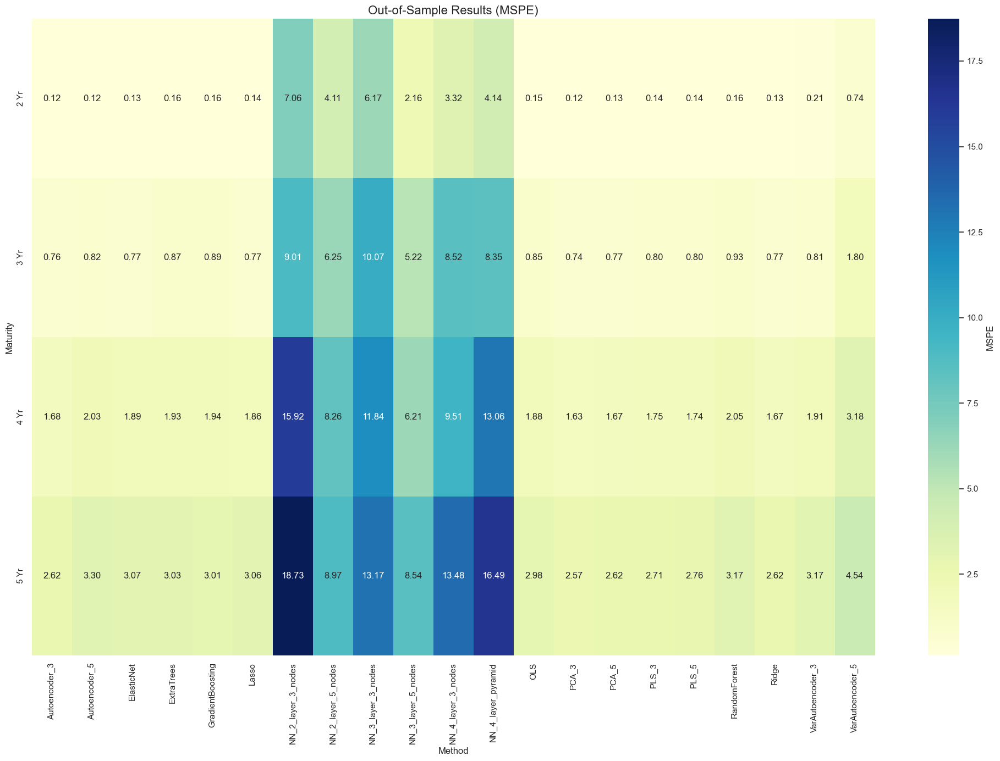

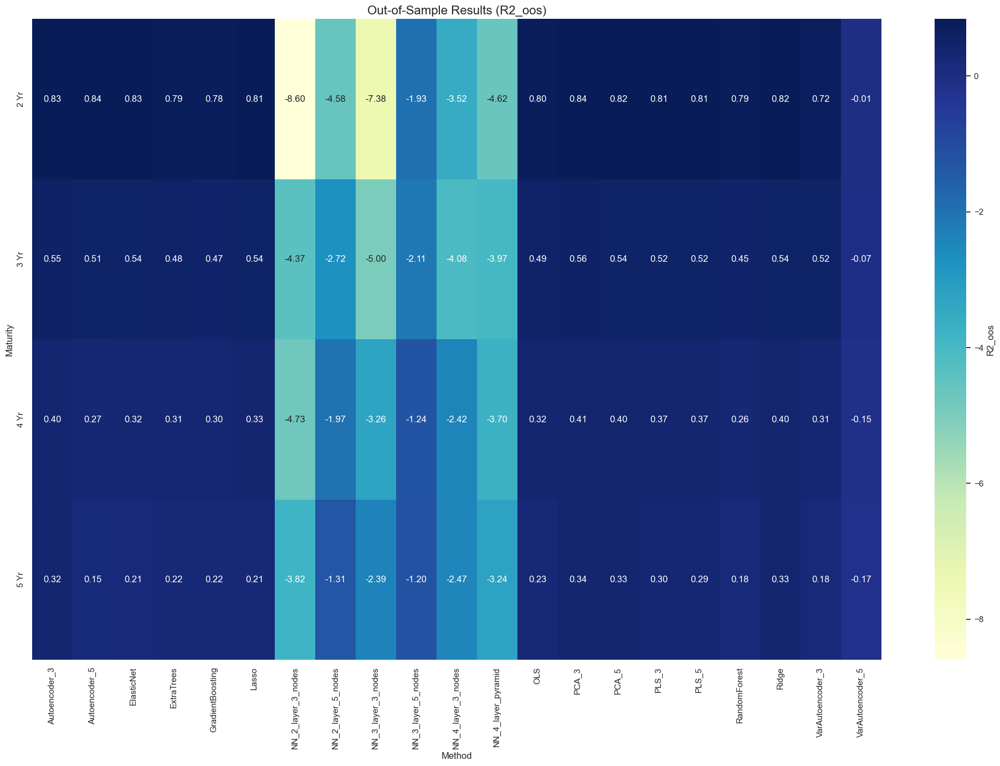

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_results_table_seaborn(results, desc):
    # Create the table data
    table_data = []
    for main_key in results:
        for sub_key in results[main_key]:
            mspe = results[main_key][sub_key]['MSPE']
            r2_oos = results[main_key][sub_key]['R2_oos']
            table_data.append([main_key, sub_key, mspe, r2_oos])

    # Create a DataFrame
    df = pd.DataFrame(table_data, columns=['Maturity', 'Method', 'MSPE', 'R2_oos'])

    # Set the figure size and style
    plt.figure(figsize=(20, 14))
    sns.set(style='whitegrid')

    # Create the heatmap
    sns.heatmap(df.pivot_table(index='Maturity', columns='Method', values='MSPE'),
                cmap='YlGnBu', annot=True, fmt='.2f', cbar_kws={'label': 'MSPE'})

    # Set the plot title and labels
    plt.title('Out-of-Sample Results (MSPE)', fontsize=16)
    plt.xlabel('Method')
    plt.ylabel('Maturity')

    # Adjust the plot layout and display
    plt.tight_layout()
    plt.show()

    # Set the figure size and style
    plt.figure(figsize=(20, 14))
    sns.set(style='whitegrid')

    # Create the heatmap
    sns.heatmap(df.pivot_table(index='Maturity', columns='Method', values='R2_oos'),
                cmap='YlGnBu', annot=True, fmt='.2f', cbar_kws={'label': 'R2_oos'})

    # Set the plot title and labels
    plt.title('Out-of-Sample Results (R2_oos)', fontsize=16)
    plt.xlabel('Method')
    plt.ylabel('Maturity')

    # Adjust the plot layout and display
    plt.tight_layout()
    plt.savefig(f'Graph/{desc}_table_results.png')
    plt.show()

plot_results_table_seaborn(results, desc='')

This cell provides a function `plot_feature_importance` that uses SHAP (SHapley Additive exPlanations) to calculate and plot the feature importance for various machine learning models. It handles both deep learning models (like autoencoders) and traditional `sklearn` models, including those packaged in pipelines. The function first selects the relevant time period, then prepares the data for the model, computes SHAP values, and finally generates a bar chart summarizing the importance of each feature in the dataset for the specified model and time frame.

In [51]:
import shap
import matplotlib.pyplot as plt

def plot_feature_importance(X, desc, start_month, end_month):
    X = X.loc[(X.index >= start_month) & (X.index <= end_month)]
    # Assuming 'device' is defined globally
    if 'Autoencoder' in desc or 'VarAutoencoder' in desc:
        X_tensor = Variable(torch.from_numpy(X)).float().to(device)
        X_transformed = model.encoder(X_tensor).detach().cpu().numpy()
        explainer = shap.KernelExplainer(model, X_transformed)
        shap_values = explainer.shap_values(X_transformed)
    else:
        model_path = f'Model/{desc}/{desc}_{start_month}_{end_month}.m'
        model = joblib.load(model_path)
        
        if isinstance(model, Pipeline):
            # If the model is a pipeline, use the last step (estimator) for explanation
            estimator = model.steps[-1][1]
            X = model.steps[0][1].fit_transform(X)
            explainer = shap.KernelExplainer(estimator.predict, X)
        else:
            # If the model is a single estimator, use it directly for explanation
            explainer = shap.KernelExplainer(model.predict, X)
        
        shap_values = explainer.shap_values(X)

    plt.figure(figsize=(8, 6))
    shap.summary_plot(shap_values, X, plot_type="bar", show=False)
    plt.title(f"Feature Importance - {desc}")
    plt.xlabel("SHAP Value")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.savefig(f'Graph/{desc}_feature_importance.png')
    plt.show()

Using 425 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 425/425 [00:08<00:00, 48.42it/s]


[[ 4.57002859 -0.16920396 -0.0194669 ]
 [ 4.43717642 -0.1578558   0.05069611]
 [ 4.37494005 -0.14706015  0.07697347]
 ...
 [-2.14861279  0.16389522  0.01359621]
 [-2.77313269  0.17472698 -0.05391768]
 [-2.09108292  0.22970408 -0.19527629]]


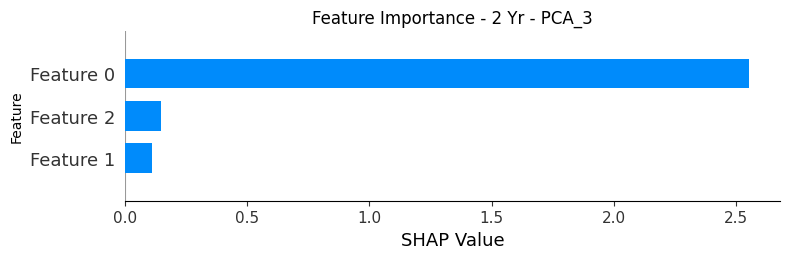

Using 425 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 425/425 [00:09<00:00, 46.43it/s]


[[ 8.79921678  0.18972667 -0.09528478]
 [ 8.54342078  0.17700209  0.24814266]
 [ 8.42358974  0.16489705  0.37676267]
 ...
 [-4.13697843 -0.18377403  0.0665495 ]
 [-5.3394405  -0.19591958 -0.26391129]
 [-4.02620937 -0.25756485 -0.95582048]]


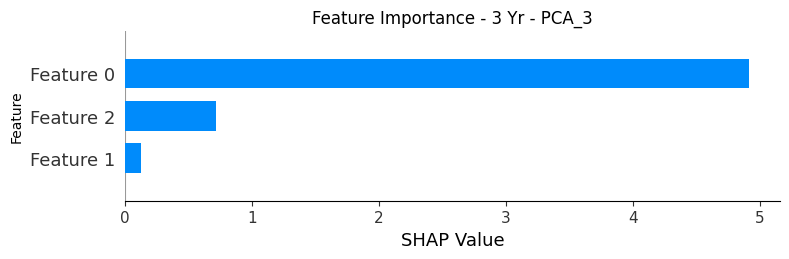

Using 425 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 425/425 [00:08<00:00, 47.28it/s]


[[12.89520426  1.04759804 -0.19623266]
 [12.52033662  0.9773378   0.51103329]
 [12.34472489  0.91049839  0.77591762]
 ...
 [-6.06271936 -1.01472986  0.13705426]
 [-7.82492097 -1.0817929  -0.54350772]
 [-5.9003879  -1.42217447 -1.96844861]]


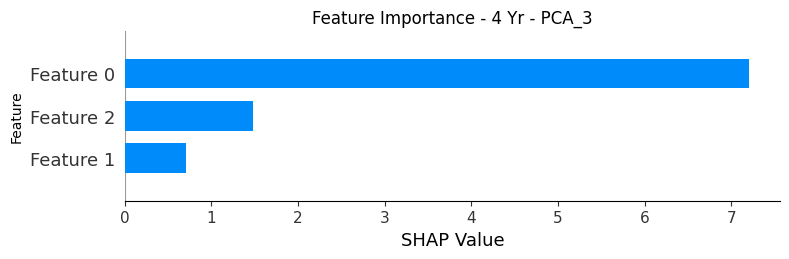

Using 425 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 425/425 [00:08<00:00, 48.02it/s]

[[16.34003223  1.99919002 -0.21472328]
 [15.86502235  1.86510846  0.55918694]
 [15.64249766  1.73755508  0.8490308 ]
 ...
 [-7.68231567 -1.93646583  0.14996861]
 [-9.91527224 -2.06444598 -0.59472138]
 [-7.47661895 -2.7140152  -2.15393163]]


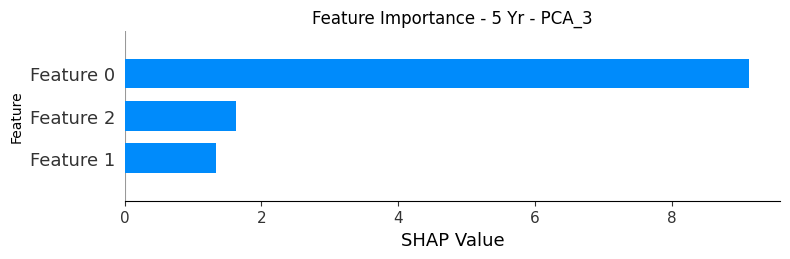

In [54]:
start_month = '1952-06'
end_month = '1987-10'


models = {
    'PCA_3': PCA(n_components=3),
    # 'PCA_5': PCA(n_components=5),
    # 'OLS': LinearRegression(),
    # 'Ridge': Ridge(),
    # 'Lasso': Lasso(),
    # 'ElasticNet': ElasticNet(),
    # 'PLS_3': PLSRegression(n_components=3),
    # 'PLS_5': PLSRegression(n_components=5),
    # 'GradientBoosting': GradientBoostingRegressor(),
    # 'RandomForest': RandomForestRegressor(),
    # 'ExtraTrees': ExtraTreesRegressor(),
    # 'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    # 'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    # 'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    # 'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    # 'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    # 'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    # 'Autoencoder_3': Autoencoder(input_dim=4, encoding_dim=3),
    # 'Autoencoder_5': Autoencoder(input_dim=4, encoding_dim=5),
    # 'VarAutoencoder_3': VAE(input_dim=4, latent_dim=3),
    # 'VarAutoencoder_5': VAE(input_dim=4, latent_dim=5),
}


X = preprocessed_data[feature_cols].copy()
for maturity in required_maturities[1:]:
    for model_name, model in models.items():
        desc = f'{maturity} - {model_name}'
        plot_feature_importance(X, desc, start_month, end_month)

In [6]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_pred_and_true_returns(data, maturities, model_name):
    # Convert the 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'])

    # Create a figure with subplots for each maturity
    fig, axes = plt.subplots(len(maturities), 1, figsize=(10, 4*len(maturities)), sharex=True)

    # Iterate over each maturity
    for i, maturity in enumerate(maturities):
        # Get the corresponding predicted return and true return columns
        pred_return_col = f'{model_name}_{maturity}_pred_return'
        true_return_col = f'{maturity}_excess_return'

        # Plot the predicted return and true return for the current maturity
        axes[i].plot(data['date'], data[pred_return_col], label=f'{maturity} Predicted Return')
        axes[i].plot(data['date'], data[true_return_col], label=f'{maturity} True Return')

        # Set the title and labels for the current subplot
        axes[i].set_title(f'{maturity} Returns by model {model_name}')
        axes[i].set_xlabel('Date')
        axes[i].set_ylabel('Return')

        # Add a legend to the current subplot
        axes[i].legend()

    # Adjust the spacing between subplots
    plt.tight_layout()

    # Display the plot
    plt.savefig(f"Graph/{model_name}_fit_curve.png")
    plt.show()

5 Yr - VarAutoencoder_5: 100%|██████████| 182/182 [00:03<00:00, 60.39it/s, Month=2002-11]


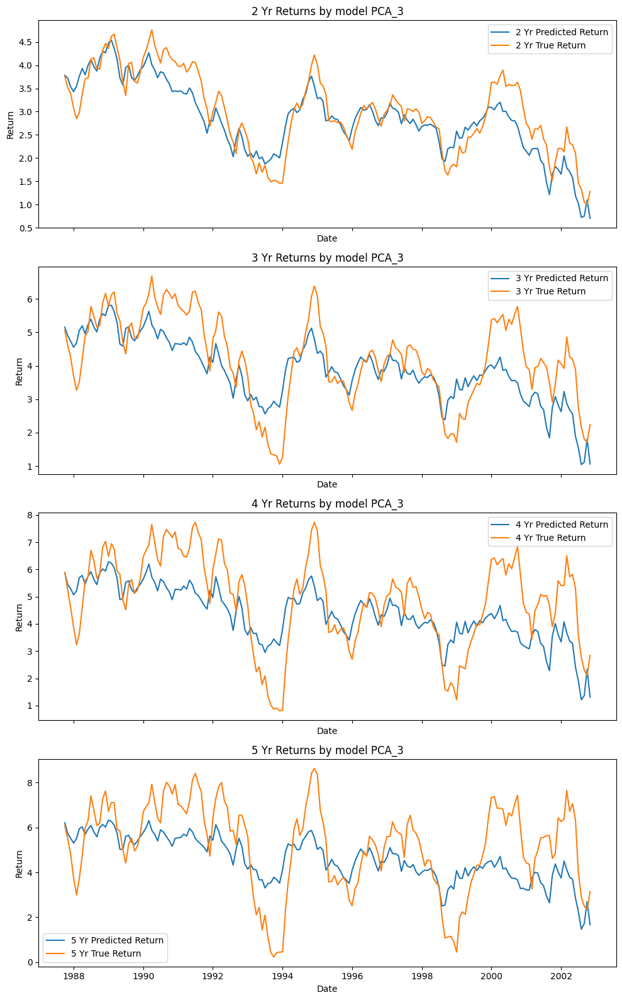

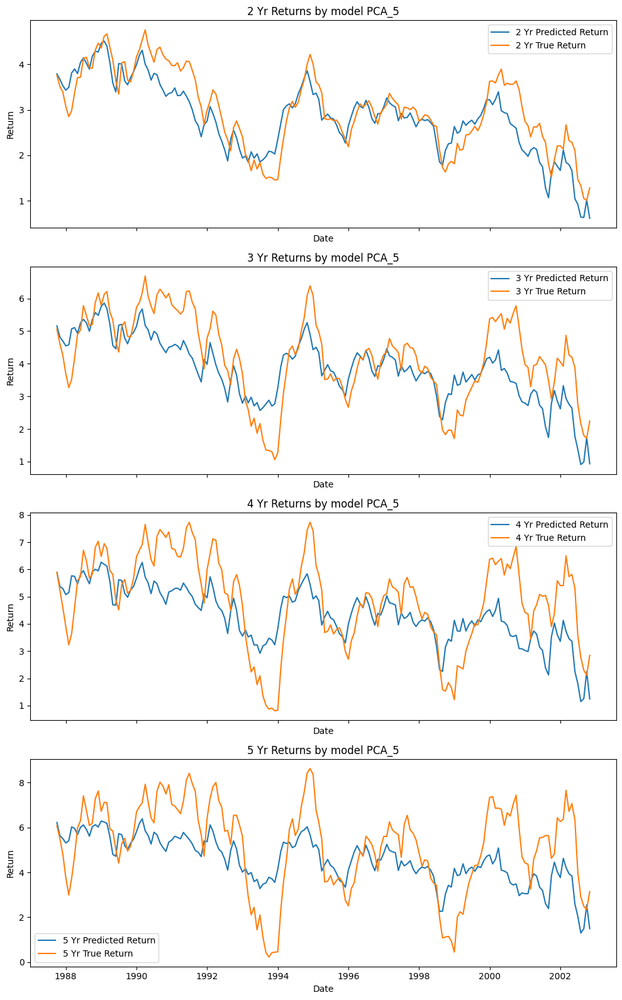

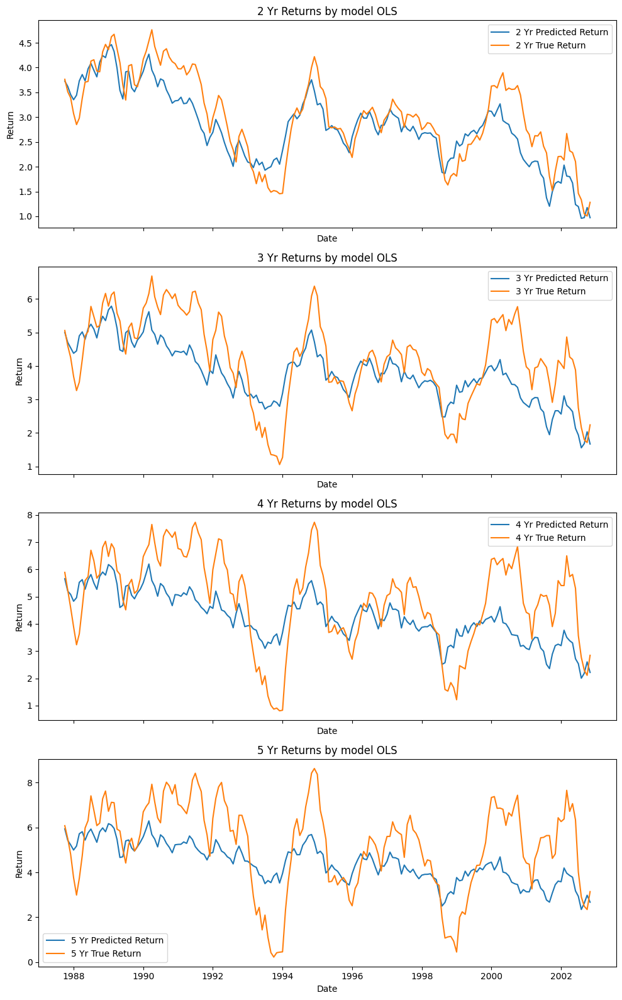

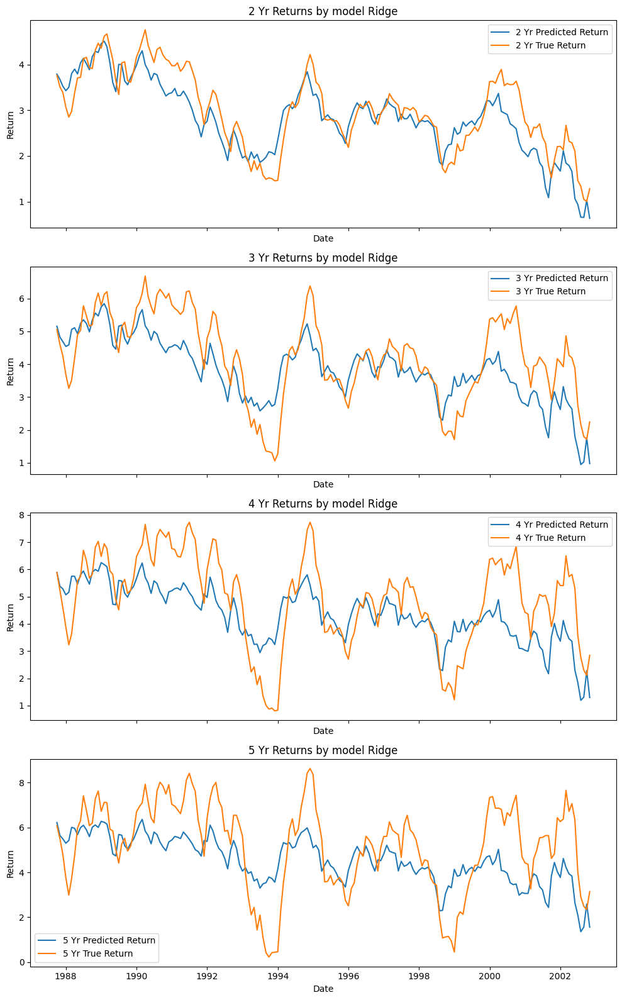

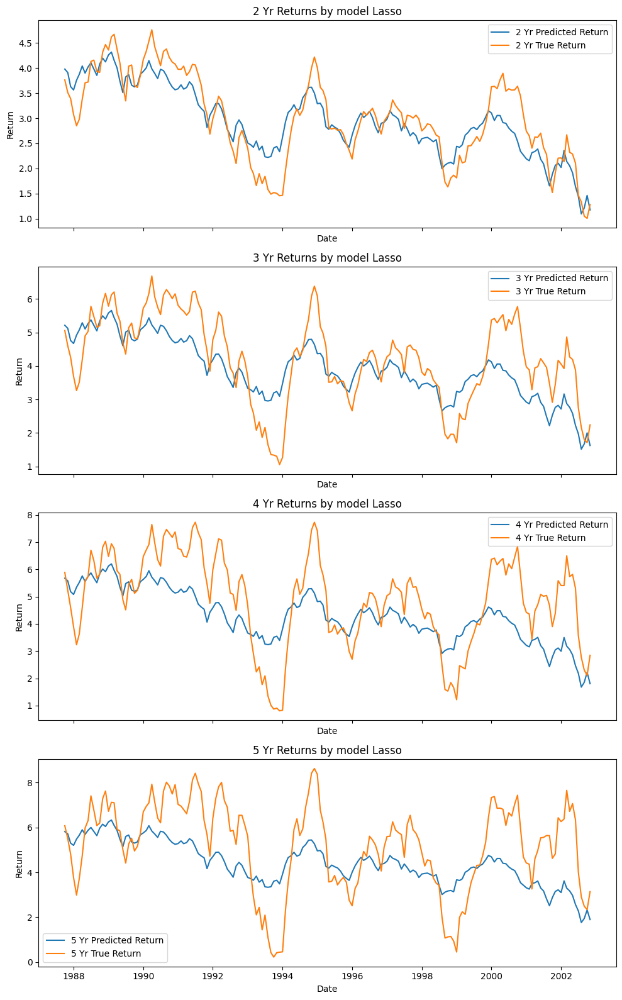

...

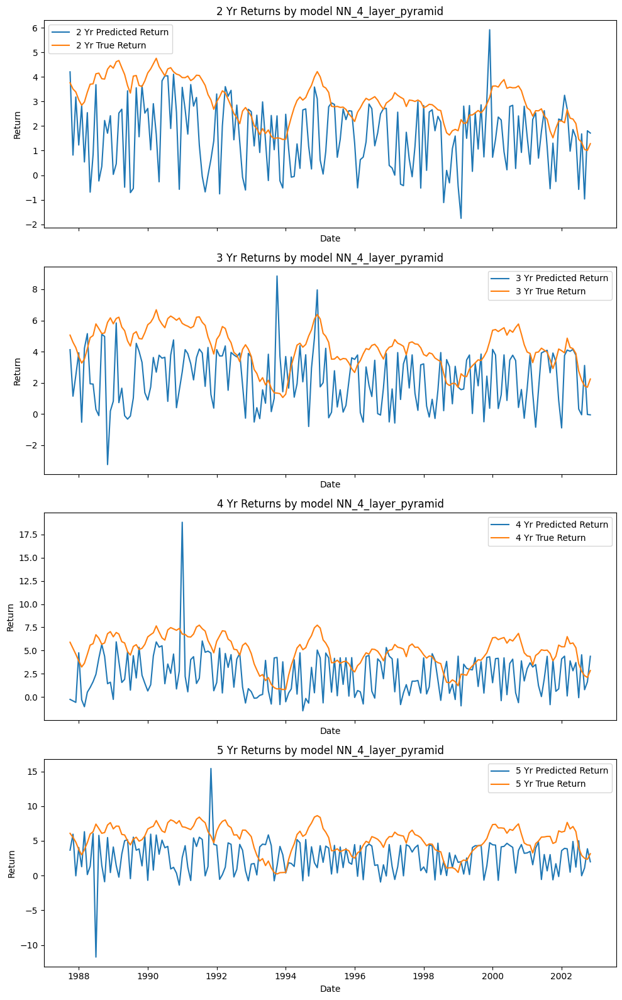

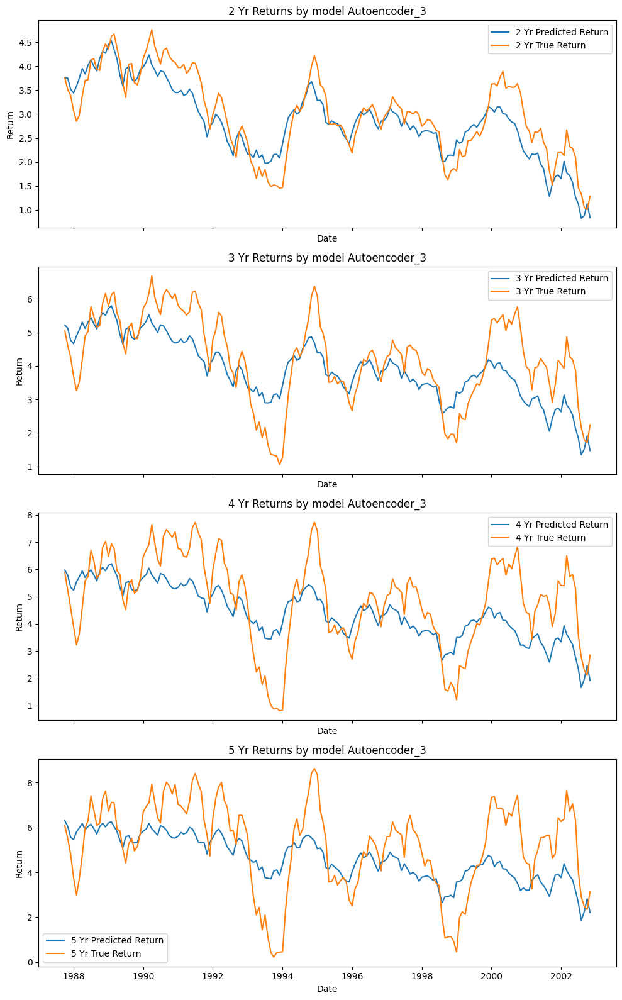

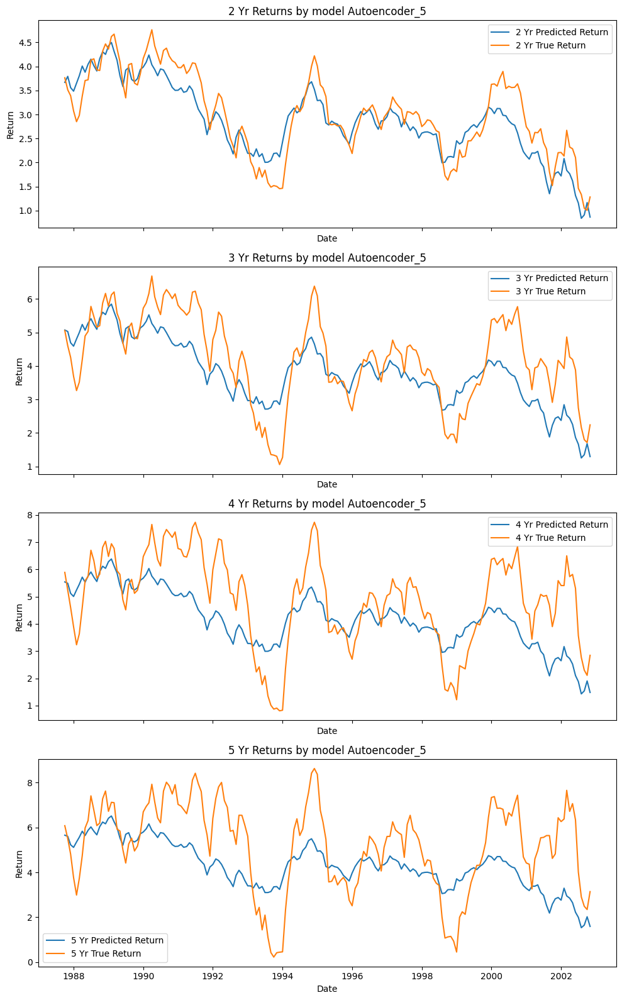

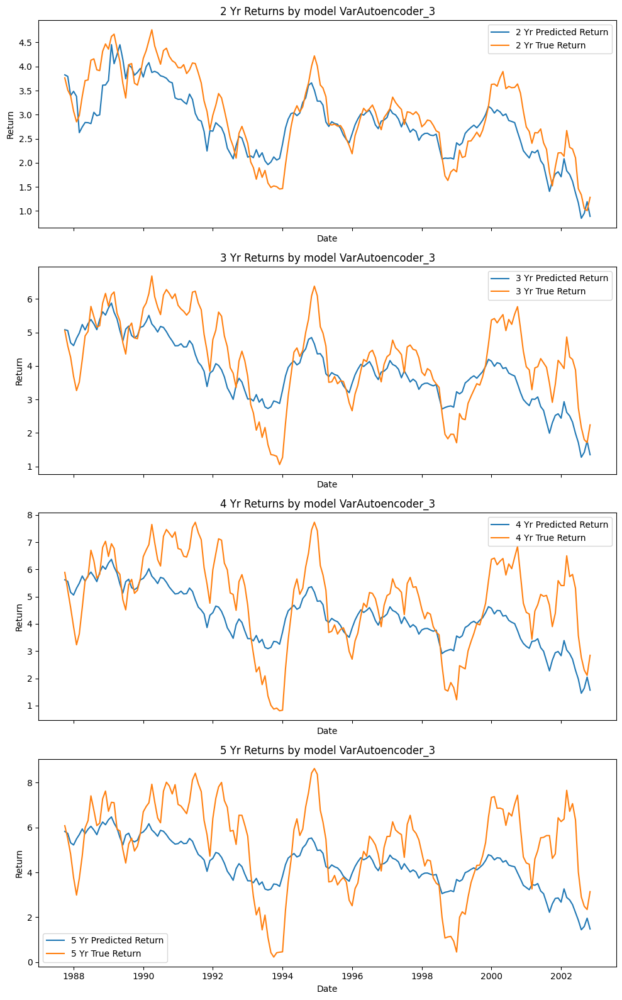

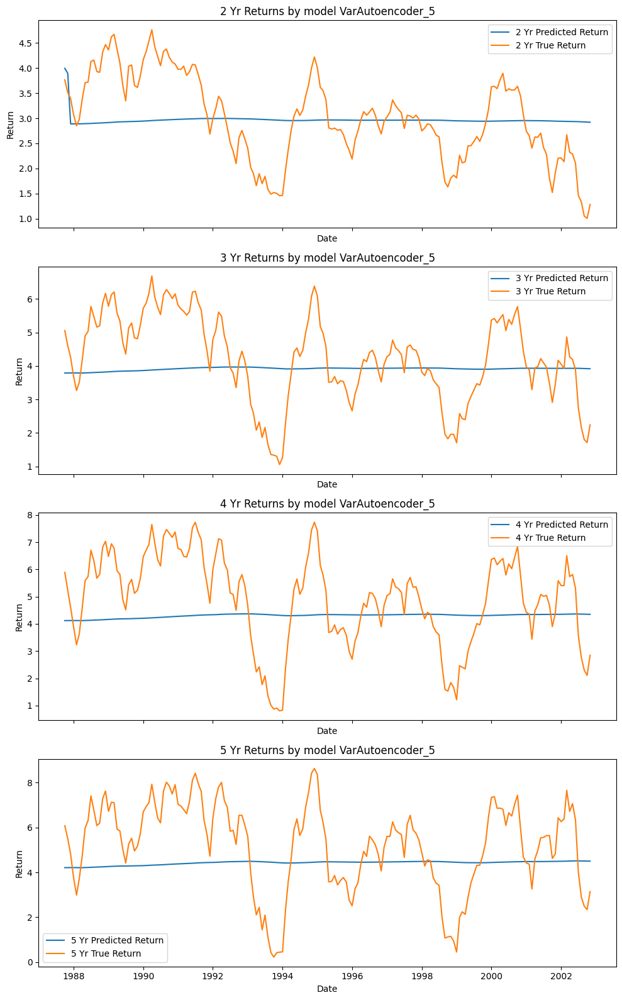

In [9]:
import pandas as pd
from functools import reduce

models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=15, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=15, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=15, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=15, latent_dim=5),
}


y_pred_lst = []

for maturity in required_maturities[1:]:
    y = preprocessed_data[f'{maturity}_excess_return'].copy()
    X = preprocessed_data[feature_cols].copy()
        
    for model_name, model in models.items():
        _, _, y_pred, dateLst = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name}')
        df_i = pd.DataFrame({
            'date': dateLst,
            f'{model_name}_{maturity}_pred_return': y_pred,
        })
        y_pred_lst.append(df_i)

# Assuming your list of DataFrames is named 'dfs'
pred_df = reduce(lambda left, right: pd.merge(left, right, on='date'), y_pred_lst)

excess_ret_df = preprocessed_data[[f'{maturity}_excess_return' for maturity in required_maturities[1:]]].reset_index(drop=False)

pred_df = pd.merge(pred_df, excess_ret_df, how='left', on='date')
pred_df.head()


for model_name, _ in models.items():
    plot_pred_and_true_returns(pred_df, required_maturities[1:], model_name)

Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 32755.28it/s]


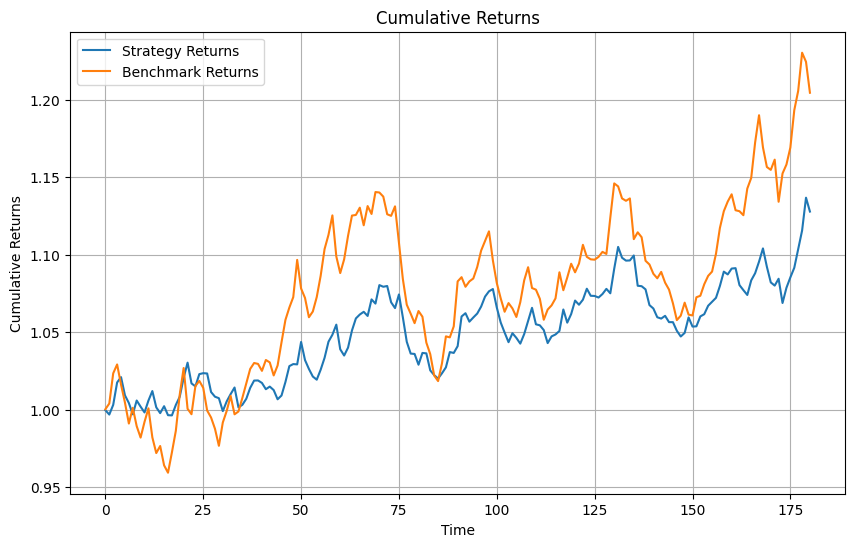

----------------------------------------------------------------
Strategy info by model PCA_3
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 36106.20it/s]


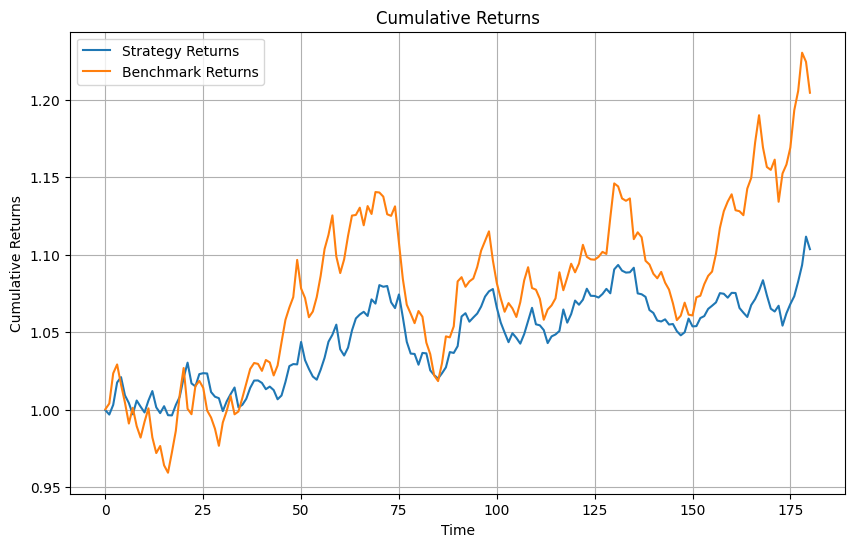

----------------------------------------------------------------
Strategy info by model PCA_5
Cumulative Return: 10.36%
Sharpe Ratio: 0.30
Max Drawdown: 5.59%
Win Ratio: 52.49%
Annual Return: 0.68%
Annual Volatility: 2.30%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 29728.20it/s]


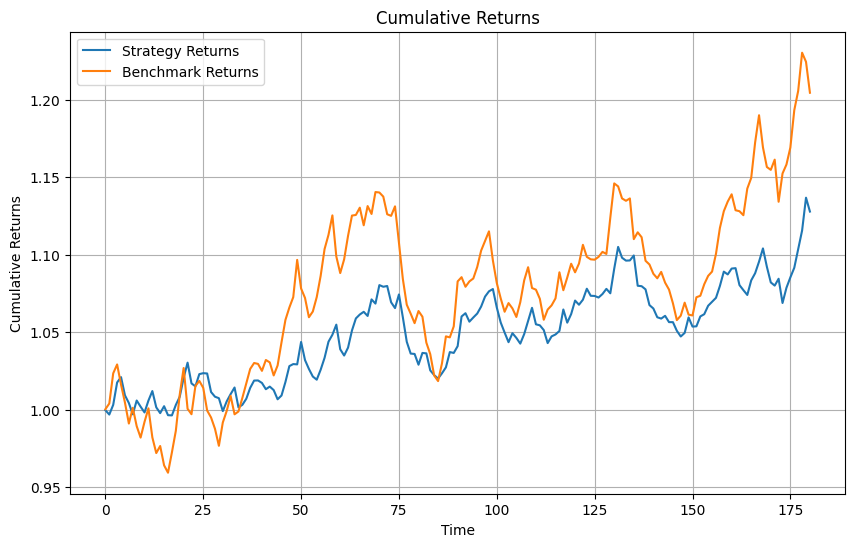

----------------------------------------------------------------
Strategy info by model OLS
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 34241.53it/s]


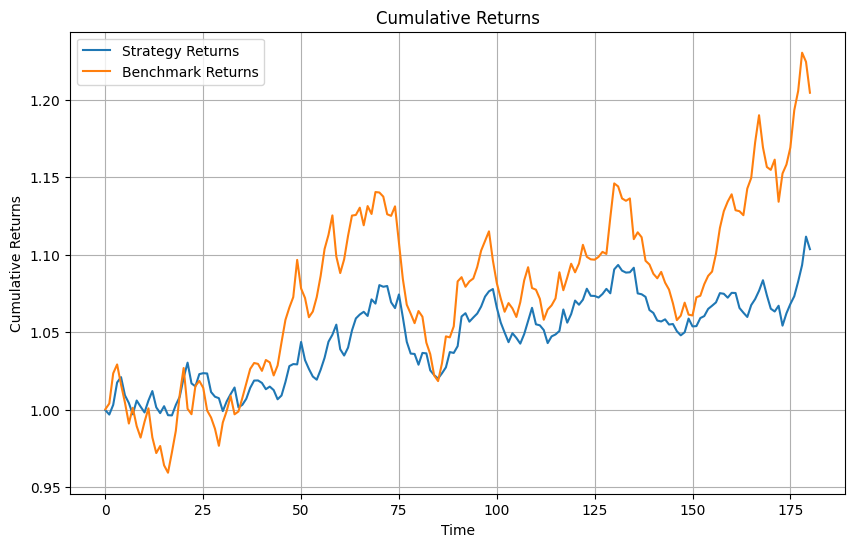

----------------------------------------------------------------
Strategy info by model Ridge
Cumulative Return: 10.36%
Sharpe Ratio: 0.30
Max Drawdown: 5.59%
Win Ratio: 52.49%
Annual Return: 0.68%
Annual Volatility: 2.30%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 29907.38it/s]


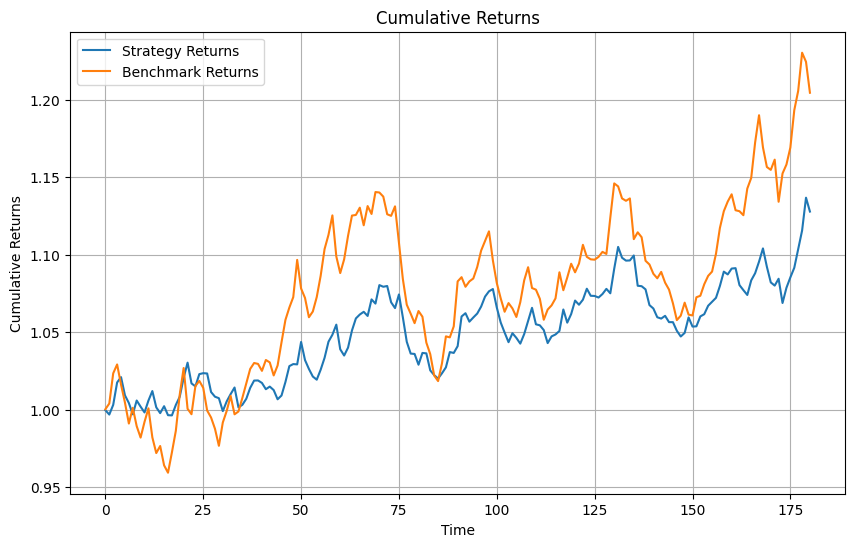

----------------------------------------------------------------
Strategy info by model Lasso
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 32932.89it/s]


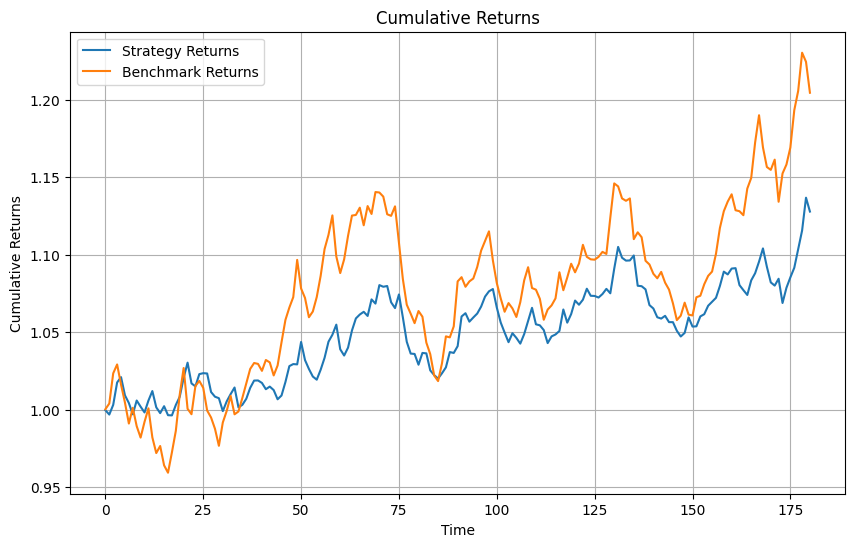

----------------------------------------------------------------
Strategy info by model ElasticNet
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 36786.79it/s]


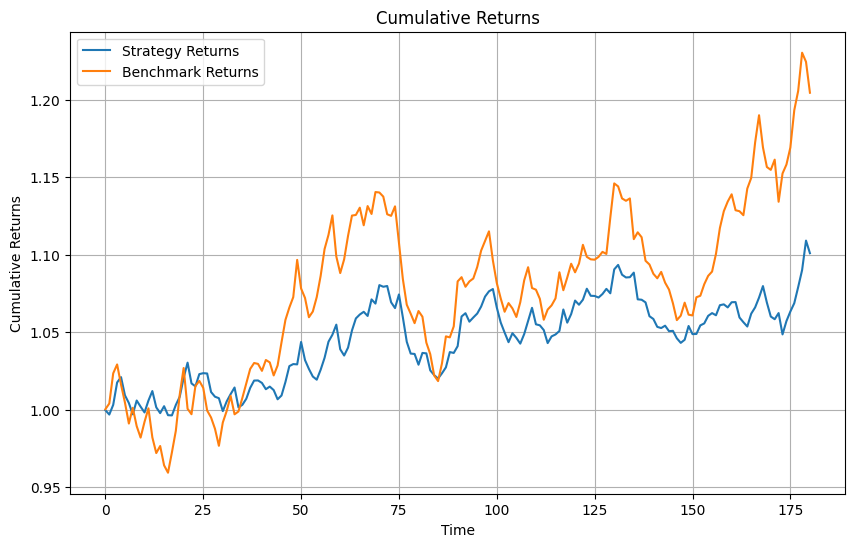

----------------------------------------------------------------
Strategy info by model PLS_3
Cumulative Return: 10.10%
Sharpe Ratio: 0.29
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.67%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 29920.35it/s]


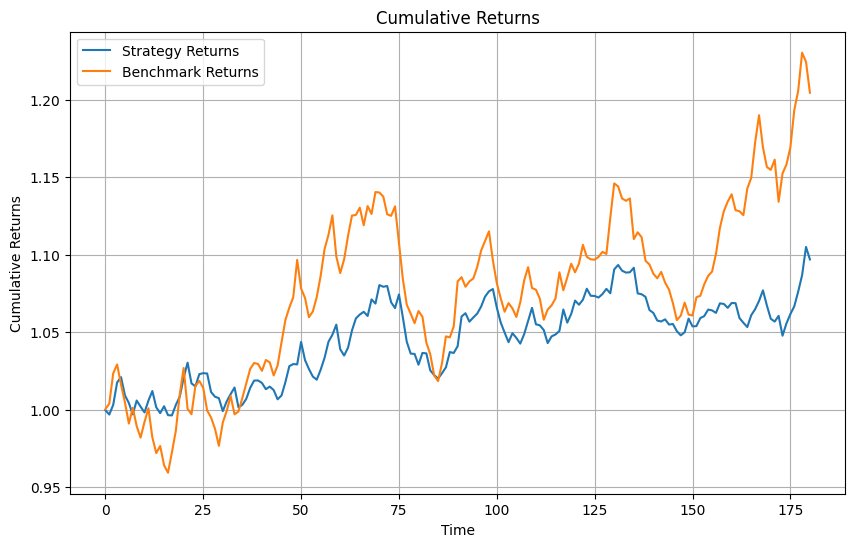

----------------------------------------------------------------
Strategy info by model PLS_5
Cumulative Return: 9.70%
Sharpe Ratio: 0.28
Max Drawdown: 5.59%
Win Ratio: 51.38%
Annual Return: 0.64%
Annual Volatility: 2.30%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 25838.77it/s]


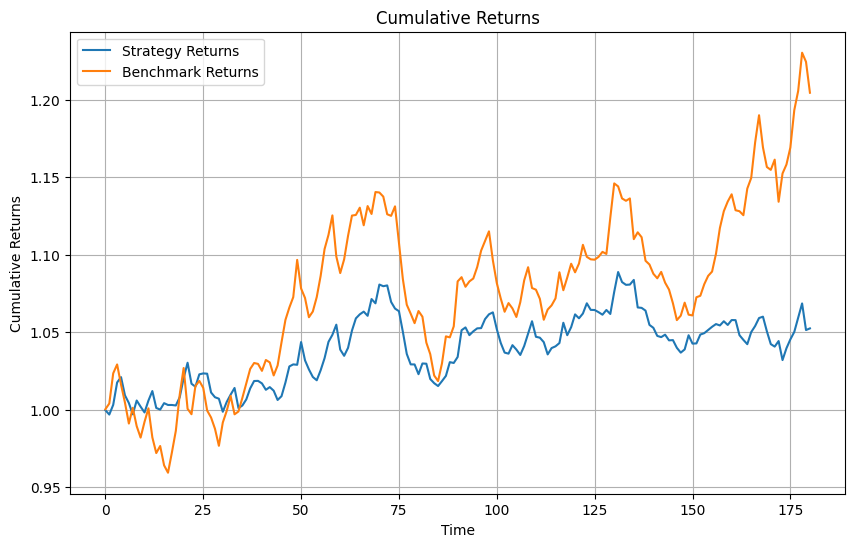

----------------------------------------------------------------
Strategy info by model GradientBoosting
Cumulative Return: 5.24%
Sharpe Ratio: 0.16
Max Drawdown: 6.06%
Win Ratio: 50.83%
Annual Return: 0.36%
Annual Volatility: 2.24%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 25896.06it/s]


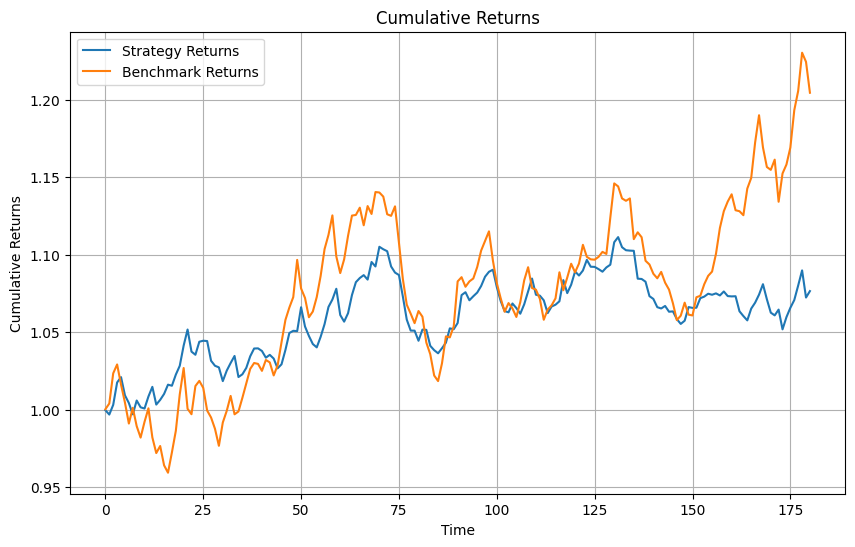

----------------------------------------------------------------
Strategy info by model RandomForest
Cumulative Return: 7.65%
Sharpe Ratio: 0.23
Max Drawdown: 6.22%
Win Ratio: 50.83%
Annual Return: 0.51%
Annual Volatility: 2.26%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 36123.38it/s]


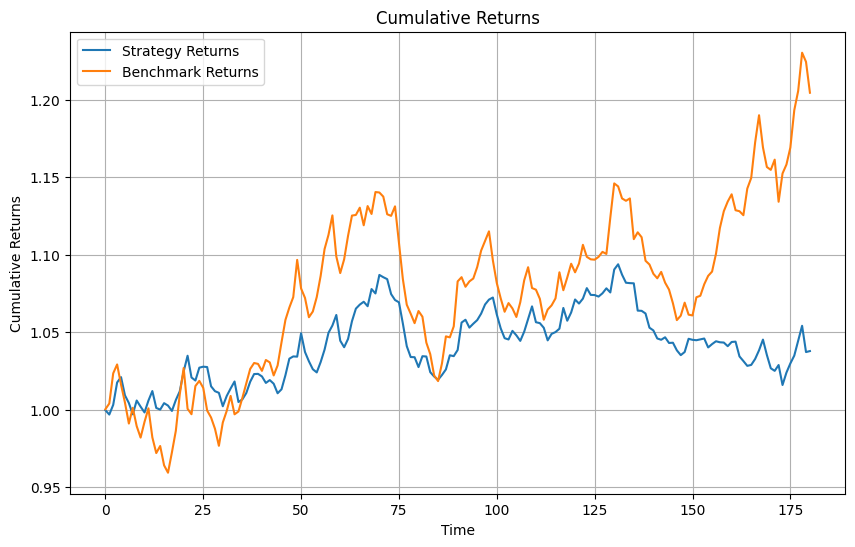

----------------------------------------------------------------
Strategy info by model ExtraTrees
Cumulative Return: 3.78%
Sharpe Ratio: 0.12
Max Drawdown: 7.13%
Win Ratio: 49.17%
Annual Return: 0.27%
Annual Volatility: 2.26%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 27810.43it/s]


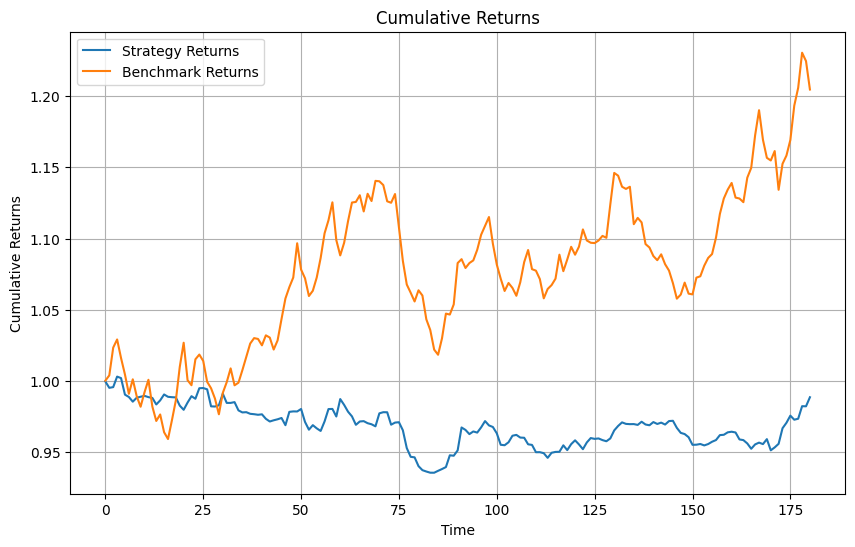

----------------------------------------------------------------
Strategy info by model NN_2_layer_3_nodes
Cumulative Return: -1.14%
Sharpe Ratio: -0.04
Max Drawdown: 6.73%
Win Ratio: 47.51%
Annual Return: -0.07%
Annual Volatility: 1.48%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 25566.41it/s]


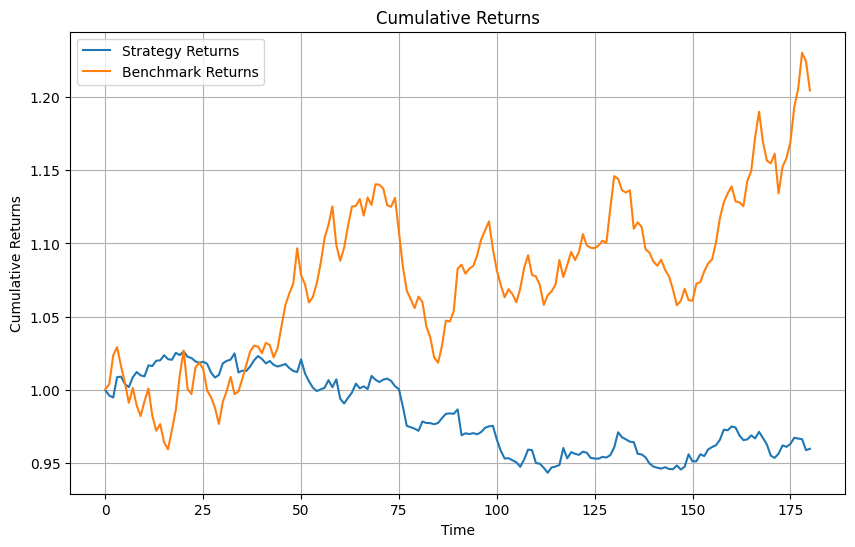

----------------------------------------------------------------
Strategy info by model NN_2_layer_5_nodes
Cumulative Return: -4.04%
Sharpe Ratio: -0.17
Max Drawdown: 8.08%
Win Ratio: 44.20%
Annual Return: -0.26%
Annual Volatility: 1.56%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 30122.17it/s]


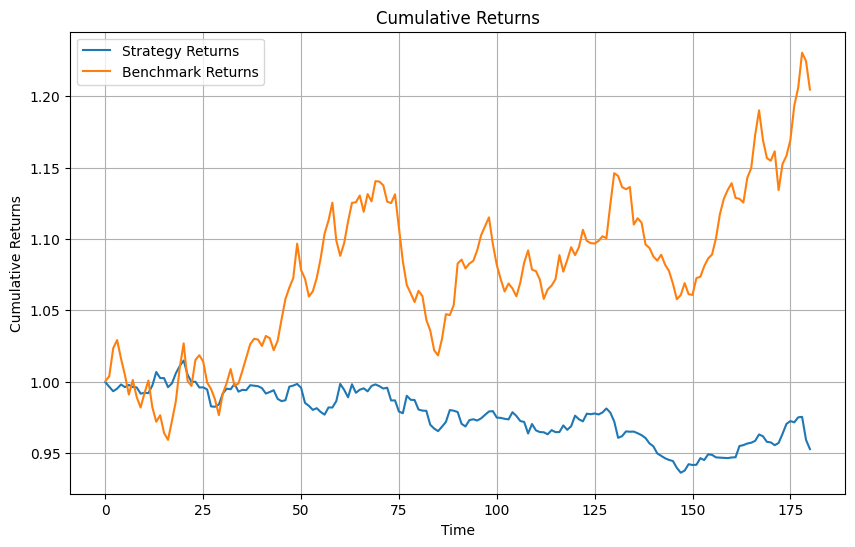

----------------------------------------------------------------
Strategy info by model NN_3_layer_3_nodes
Cumulative Return: -4.72%
Sharpe Ratio: -0.21
Max Drawdown: 7.75%
Win Ratio: 43.09%
Annual Return: -0.31%
Annual Volatility: 1.50%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 27787.01it/s]


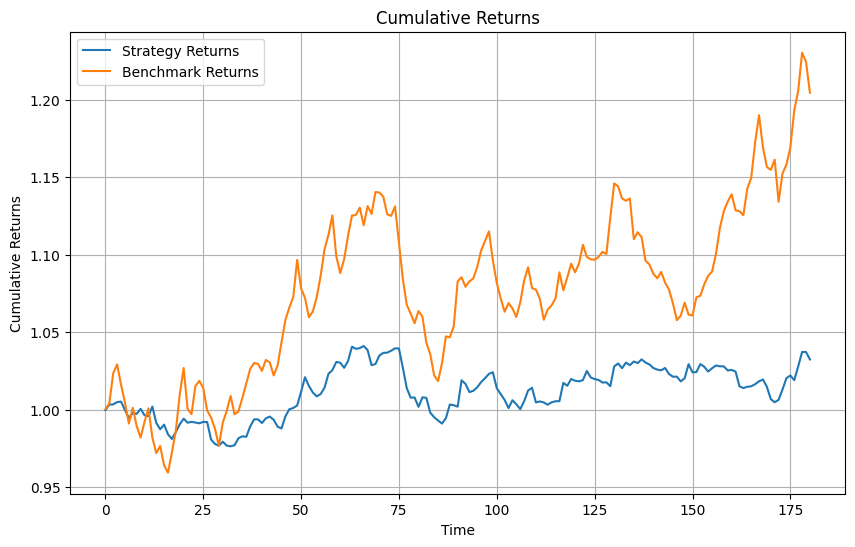

----------------------------------------------------------------
Strategy info by model NN_3_layer_5_nodes
Cumulative Return: 3.24%
Sharpe Ratio: 0.14
Max Drawdown: 4.81%
Win Ratio: 50.83%
Annual Return: 0.22%
Annual Volatility: 1.59%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 21278.95it/s]


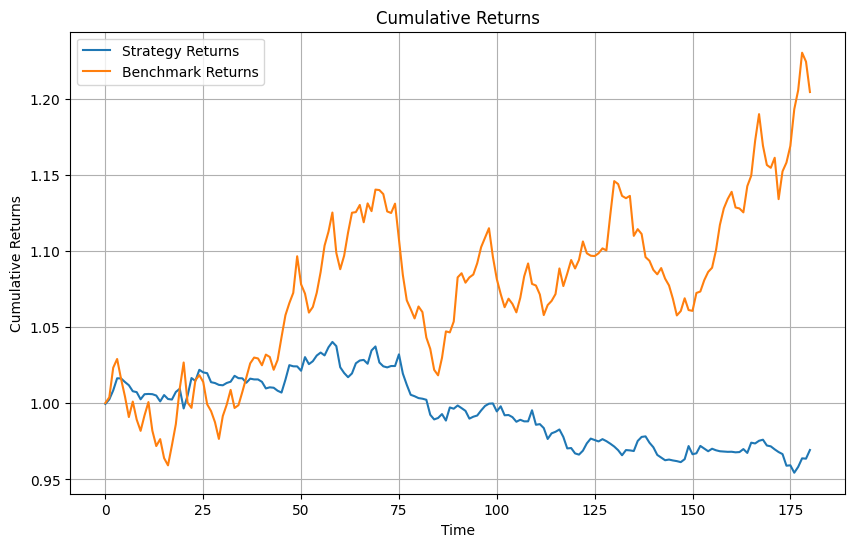

----------------------------------------------------------------
Strategy info by model NN_4_layer_3_nodes
Cumulative Return: -3.07%
Sharpe Ratio: -0.14
Max Drawdown: 8.26%
Win Ratio: 41.99%
Annual Return: -0.20%
Annual Volatility: 1.44%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 25186.42it/s]


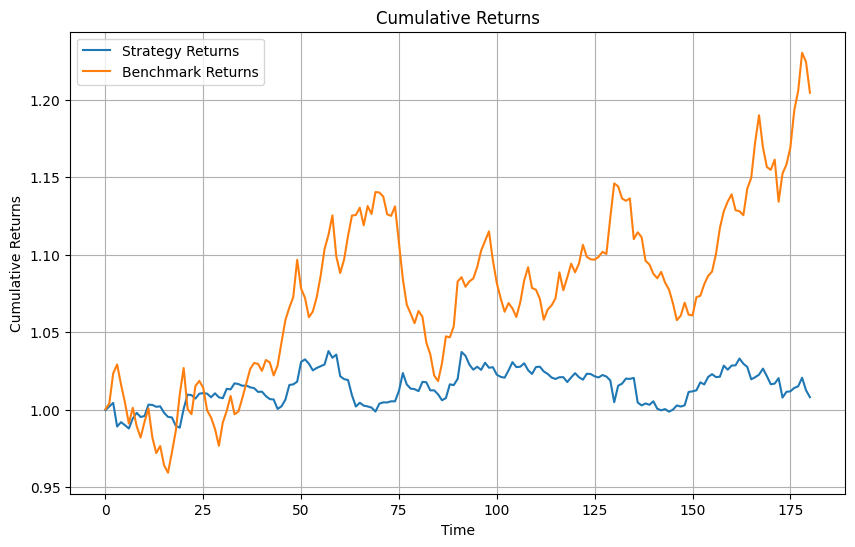

----------------------------------------------------------------
Strategy info by model NN_4_layer_pyramid
Cumulative Return: 0.80%
Sharpe Ratio: 0.04
Max Drawdown: 3.77%
Win Ratio: 47.51%
Annual Return: 0.07%
Annual Volatility: 1.59%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 30168.85it/s]


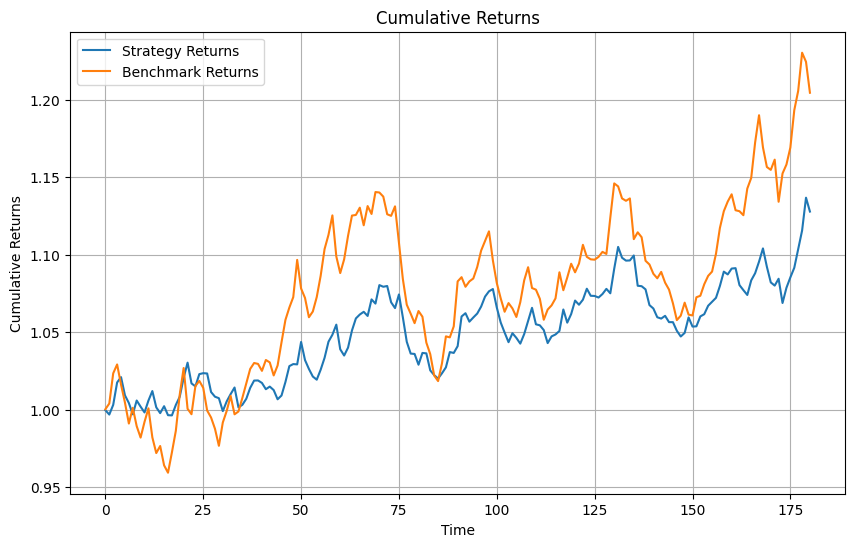

----------------------------------------------------------------
Strategy info by model Autoencoder_3
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 28328.26it/s]


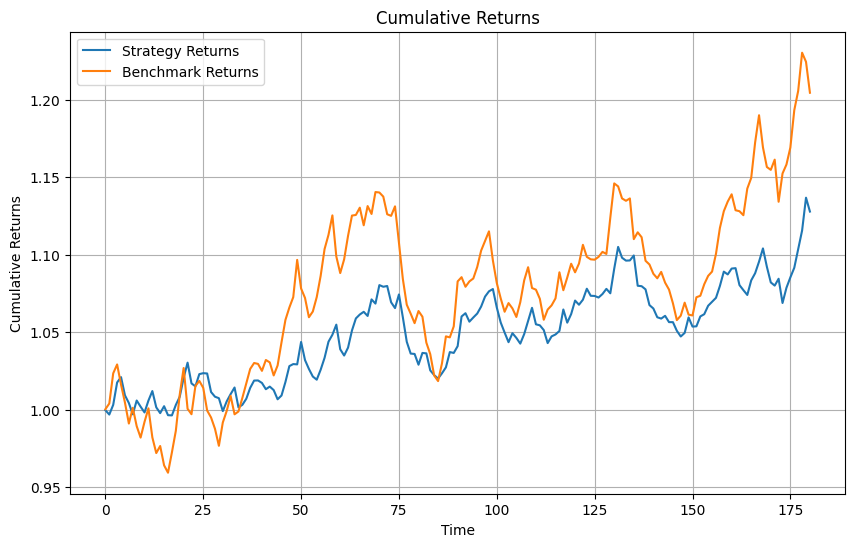

----------------------------------------------------------------
Strategy info by model Autoencoder_5
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 32820.42it/s]


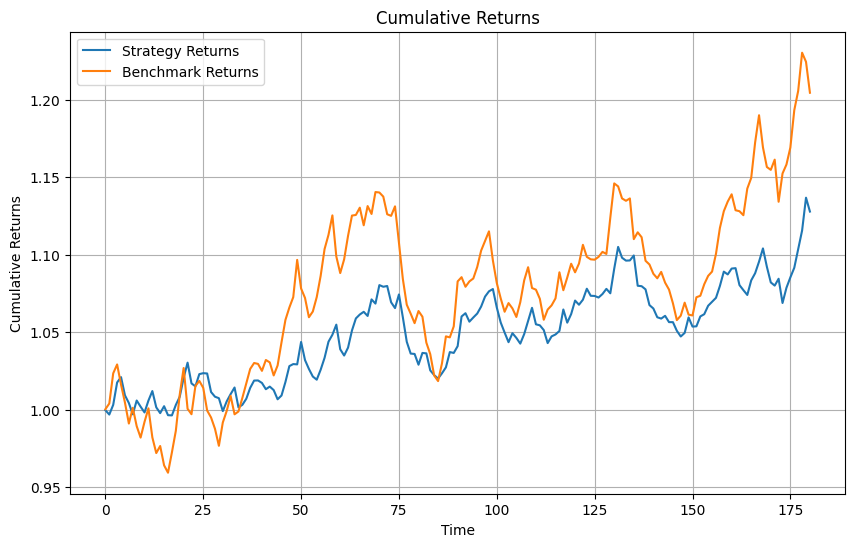

----------------------------------------------------------------
Strategy info by model VarAutoencoder_3
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


Calculating Benchmark Returns: 100%|██████████| 181/181 [00:00<00:00, 25276.99it/s]


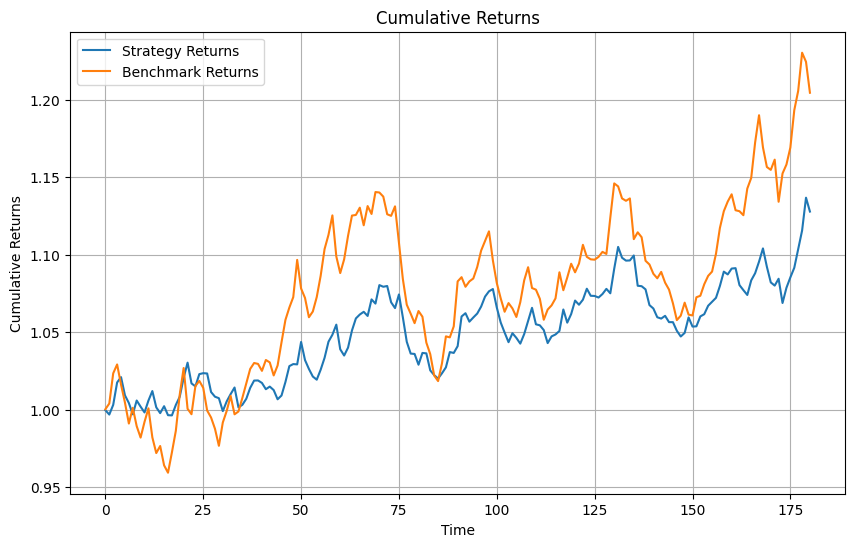

----------------------------------------------------------------
Strategy info by model VarAutoencoder_5
Cumulative Return: 12.79%
Sharpe Ratio: 0.34
Max Drawdown: 5.59%
Win Ratio: 53.04%
Annual Return: 0.83%
Annual Volatility: 2.42%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 20.46%
Sharpe Ratio: 0.35
Max Drawdown: 10.70%
Win Ratio: 53.59%
Annual Return: 1.30%
Annual Volatility: 3.72%


In [12]:
# Define your models
models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=15, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=15, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=15, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=15, latent_dim=5),
}

# Get the predicted excess returns
predicted_returns, dates = get_predicted_excess_returns(preprocessed_data, models, train_size=0.7, epochs=100, lr=1e-3)

for model_name, model in models.items():

    # Create an instance of the DirectBondTradeBacktester class
    backtester = DirectBondTradeBacktester(predicted_returns, dates, commission_rate=2e-4, bond_prices=prices, initial_capital=1000000)

    # Run the backtest
    backtester.run(model_name=model_name)

    # Analyze the results
    # backtester.display_log()
    backtester.save_log('backtest_log.txt')
    backtester.calculate_benchmark_returns()
    backtester.plot_cumulative_returns(desc=model_name)
    backtester.calculate_metrics()
    backtester.print_metrics()

## Macro economics Indicator

In [5]:
FRED = pd.read_csv("FRED_MD.csv").iloc[1:]
macro_cols = list(FRED.columns[1:])
FRED.head()

,sasdate,RPI,W875RX1,DPCERA3M086SBEA,CMRMTSPLx,RETAILx,INDPRO,IPFPNSS,IPFINAL,IPCONGD,...,DNDGRG3M086SBEA,DSERRG3M086SBEA,CES0600000008,CES2000000008,CES3000000008,UMCSENTx,DTCOLNVHFNM,DTCTHFNM,INVEST,VIXCLSx
1,1/1/1959,2583.560,2426.0,15.188,276676.8154,18235.77392,21.9665,23.3891,22.2688,31.7011,...,18.294,10.152,2.13,2.45,2.04,NaN,6476.0,12298.0,84.2043,NaN
2,2/1/1959,2593.596,2434.8,15.346,278713.9773,18369.56308,22.3966,23.7048,22.4617,31.9337,...,18.302,10.167,2.14,2.46,2.05,NaN,6476.0,12298.0,83.5280,NaN
3,3/1/1959,2610.396,2452.7,15.491,277775.2539,18523.05762,22.7193,23.8483,22.5719,31.9337,...,18.289,10.185,2.15,2.45,2.07,NaN,6508.0,12349.0,81.6405,NaN
4,4/1/1959,2627.446,2470.0,15.435,283362.7075,18534.46600,23.2032,24.1927,22.9026,32.4374,...,18.300,10.221,2.16,2.47,2.08,NaN,6620.0,12484.0,81.8099,NaN
5,5/1/1959,2642.720,2486.4,15.622,285307.2201,18679.66354,23.5528,24.3936,23.1231,32.5925,...,18.280,10.238,2.17,2.48,2.08,95.3,6753.0,12646.0,80.7315,NaN


In [6]:
FRED['sasdate'] = pd.to_datetime(FRED['sasdate'], format='%m/%d/%Y')
FRED['sasdate'] = FRED['sasdate'].dt.strftime('%Y-%m')
FRED.rename(columns={'sasdate': 'date'}, inplace=True)
FRED

,date,RPI,W875RX1,DPCERA3M086SBEA,CMRMTSPLx,RETAILx,INDPRO,IPFPNSS,IPFINAL,IPCONGD,...,DNDGRG3M086SBEA,DSERRG3M086SBEA,CES0600000008,CES2000000008,CES3000000008,UMCSENTx,DTCOLNVHFNM,DTCTHFNM,INVEST,VIXCLSx
1,1959-01,2583.560,2426.0,15.188,2.766768e+05,18235.77392,21.9665,23.3891,22.2688,31.7011,...,18.294,10.152,2.13,2.45,2.04,NaN,6476.00,12298.00,84.2043,NaN
2,1959-02,2593.596,2434.8,15.346,2.787140e+05,18369.56308,22.3966,23.7048,22.4617,31.9337,...,18.302,10.167,2.14,2.46,2.05,NaN,6476.00,12298.00,83.5280,NaN
3,1959-03,2610.396,2452.7,15.491,2.777753e+05,18523.05762,22.7193,23.8483,22.5719,31.9337,...,18.289,10.185,2.15,2.45,2.07,NaN,6508.00,12349.00,81.6405,NaN
4,1959-04,2627.446,2470.0,15.435,2.833627e+05,18534.46600,23.2032,24.1927,22.9026,32.4374,...,18.300,10.221,2.16,2.47,2.08,NaN,6620.00,12484.00,81.8099,NaN
5,1959-05,2642.720,2486.4,15.622,2.853072e+05,18679.66354,23.5528,24.3936,23.1231,32.5925,...,18.280,10.238,2.17,2.48,2.08,95.3,6753.00,12646.00,80.7315,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
777,2023-09,19111.748,15741.9,116.594,1.507530e+06,705304.00000,103.2096,101.0935,101.3665,102.1034,...,120.395,123.976,29.90,34.55,26.62,67.9,508808.61,913938.95,5074.6108,15.0424
778,2023-10,19145.402,15784.6,116.663,1.505477e+06,703528.00000,102.3722,100.5292,100.5527,101.1664,...,120.040,124.228,29.97,34.67,26.65,63.8,513229.64,918210.64,5015.5456,19.0462
779,2023-11,19213.108,15859.9,117.127,1.514733e+06,703336.00000,102.6710,100.9362,101.2159,101.8557,...,119.325,124.551,30.26,34.96,26.89,61.3,517434.30,922552.40,4999.7208,13.8563
780,2023-12,19251.946,15899.0,117.773,1.530296e+06,706180.00000,102.6715,100.8332,101.2843,101.9884,...,119.193,124.917,30.45,35.01,27.14,69.7,522366.13,928336.14,5077.4222,12.6960


In [7]:
def standardize_features(df, identifier_columns):
    """
    Standardizes the feature columns of the DataFrame using z-score.
    
    Parameters:
    df (pd.DataFrame): The DataFrame with features to standardize.
    identifier_columns (list): List of columns to exclude from standardization.
    
    Returns:
    pd.DataFrame: The DataFrame with standardized feature columns.
    """
    df = df.copy()
    feature_columns = [col for col in df.columns if col in identifier_columns]
    features_array = df[feature_columns].to_numpy()
    
    # Handle NaN and infinite values
    mean = np.nanmean(features_array, axis=1, keepdims=True)
    std = np.nanstd(features_array, axis=1, keepdims=True)
    valid_mask = np.isfinite(features_array)
    
    # Replace NaN and infinite values with 0 before standardization
    features_array[~valid_mask] = 0
    
    # Perform standardization
    standardized_features = (features_array - mean) / std
    standardized_features[~valid_mask] = 0  # Set standardized values for NaN/infinite to 0
    
    df[feature_columns] = standardized_features
    return df

In [8]:
preprocessed_data_macro = pd.merge(preprocessed_data, FRED, on='date', how='left')
preprocessed_data_macro.dropna(subset=macro_cols, how='all', inplace=True)
preprocessed_data_macro = preprocessed_data_macro.ffill()
preprocessed_data_macro = preprocessed_data_macro.fillna(0)
preprocessed_data_macro = standardize_features(preprocessed_data_macro, identifier_columns=feature_cols+macro_cols)
preprocessed_data_macro.set_index('date', inplace=True)
preprocessed_data_macro

,1 Yr,2 Yr,3 Yr,4 Yr,5 Yr,1 Yr_price,2 Yr_price,3 Yr_price,4 Yr_price,5 Yr_price,...,DNDGRG3M086SBEA,DSERRG3M086SBEA,CES0600000008,CES2000000008,CES3000000008,UMCSENTx,DTCOLNVHFNM,DTCTHFNM,INVEST,VIXCLSx
date,,,,,,,,,,,,,,,,,,,,,
1959-01,-0.222648,-0.222746,-0.222868,-0.222974,-0.223065,-0.225402,-0.225420,-0.225437,-0.225452,-0.225467,...,-0.224867,-0.225096,-0.225323,-0.225314,-0.225325,-0.225383,-0.042676,0.121579,-0.223007,-0.225383
1959-02,-0.223857,-0.223948,-0.224055,-0.224160,-0.224248,-0.226628,-0.226646,-0.226663,-0.226679,-0.226695,...,-0.226087,-0.226319,-0.226548,-0.226539,-0.226550,-0.226609,-0.042142,0.123696,-0.224229,-0.226609
1959-03,-0.227898,-0.228005,-0.228114,-0.228215,-0.228320,-0.230767,-0.230786,-0.230804,-0.230820,-0.230836,...,-0.230207,-0.230446,-0.230684,-0.230675,-0.230686,-0.230747,-0.038589,0.133874,-0.228337,-0.230747
1959-04,-0.229447,-0.229560,-0.229669,-0.229785,-0.229888,-0.232340,-0.232359,-0.232377,-0.232393,-0.232409,...,-0.231774,-0.232015,-0.232256,-0.232246,-0.232258,-0.232320,-0.034793,0.140176,-0.229879,-0.232320
1959-05,-0.229063,-0.229177,-0.229296,-0.229408,-0.229516,-0.231941,-0.231959,-0.231977,-0.231993,-0.232009,...,-0.231378,-0.231616,-0.231856,-0.231847,-0.231859,-0.229089,-0.031301,0.143769,-0.229522,-0.231921
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2002-08,-0.262568,-0.262583,-0.262603,-0.262627,-0.262652,-0.263186,-0.263190,-0.263194,-0.263198,-0.263201,...,-0.262699,-0.262749,-0.263079,-0.263066,-0.263086,-0.262634,1.006417,3.440097,-0.254543,-0.262949
2002-09,-0.262360,-0.262372,-0.262388,-0.262408,-0.262429,-0.262980,-0.262985,-0.262989,-0.262992,-0.262996,...,-0.262493,-0.262542,-0.262873,-0.262860,-0.262880,-0.262438,1.052532,3.438321,-0.254227,-0.262716
2002-10,-0.262380,-0.262392,-0.262410,-0.262431,-0.262455,-0.263001,-0.263005,-0.263009,-0.263013,-0.263016,...,-0.262512,-0.262561,-0.262894,-0.262880,-0.262900,-0.262493,1.021202,3.446730,-0.254063,-0.262738


In [13]:
models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=142, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=142, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=142, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=142, latent_dim=5),
}


results = {}

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()
    
    results[maturity] = {}
    
    for model_name, model in models.items():
        mse, r2, _, _ = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name} - macro')
        results[maturity][model_name] = {'MSPE': mse, 'R2_oos': r2}

5 Yr - VarAutoencoder_5 - macro: 100%|██████████| 158/158 [00:02<00:00, 62.73it/s, Month=2002-11]


5 Yr - VarAutoencoder_5 - macro: 100%|██████████| 158/158 [00:02<00:00, 60.27it/s, Month=2002-11]


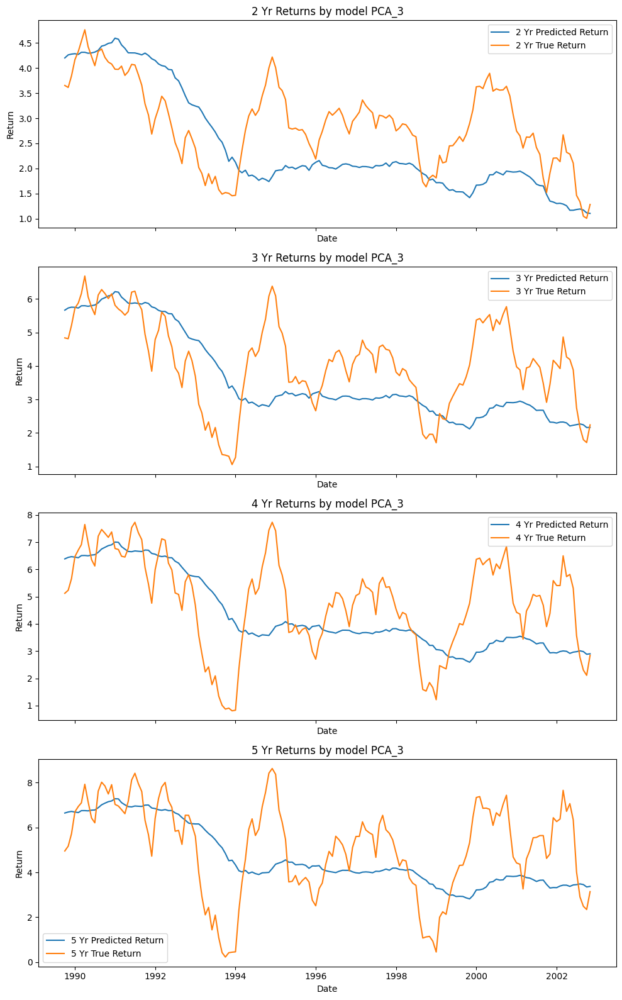

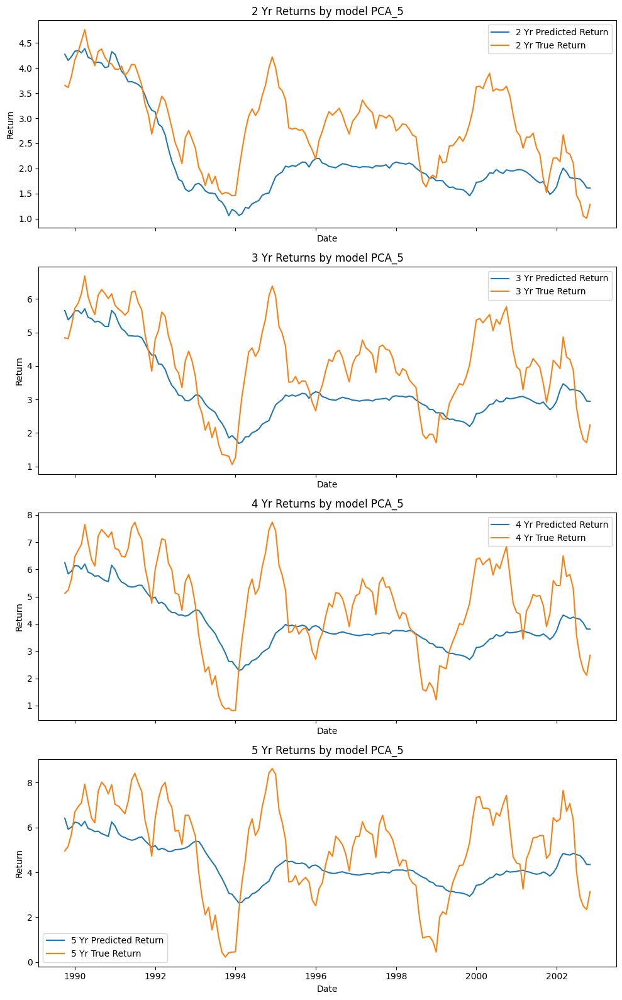

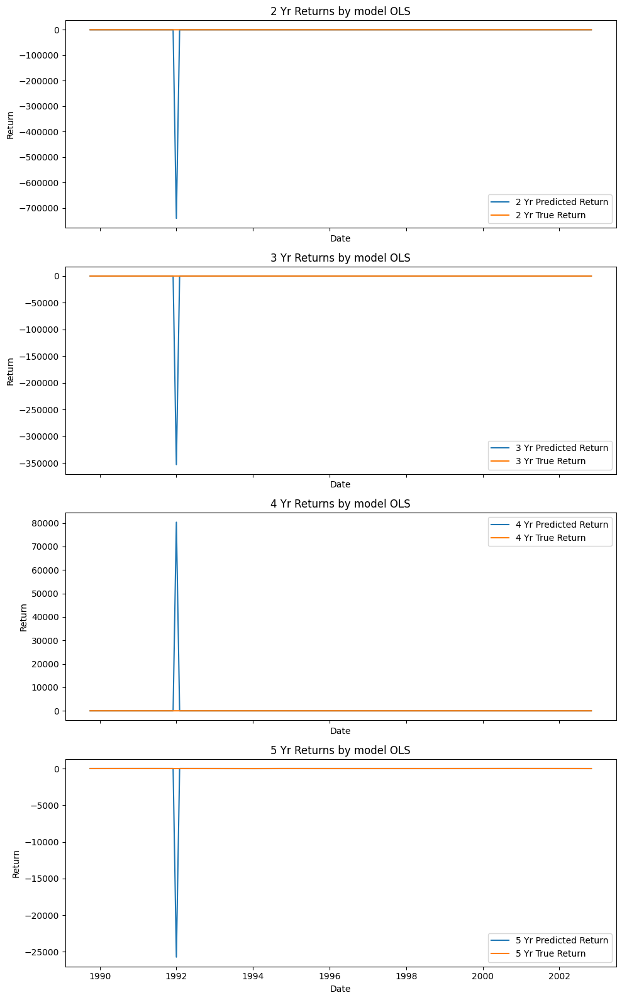

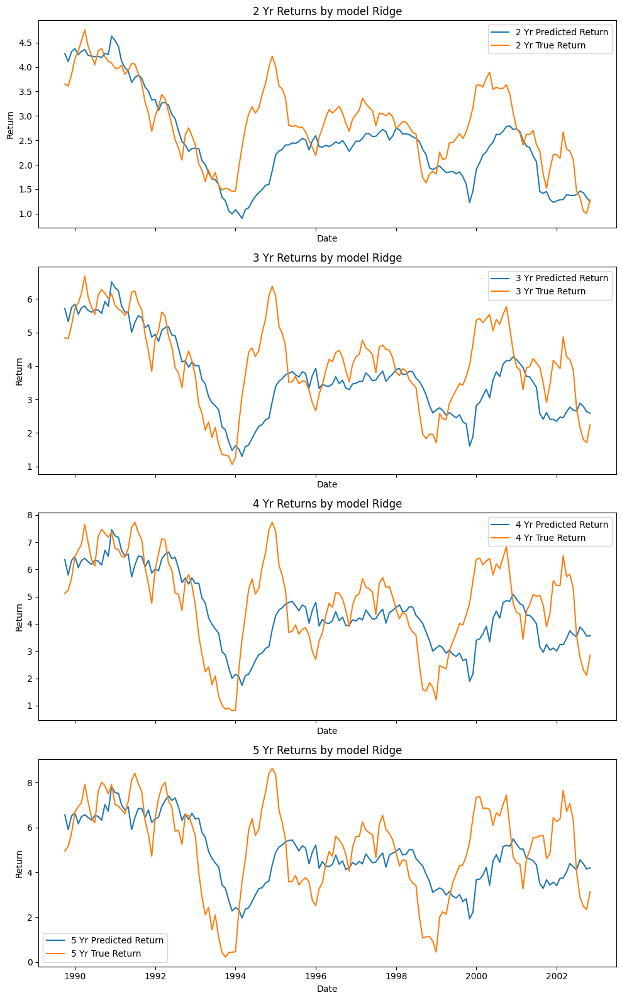

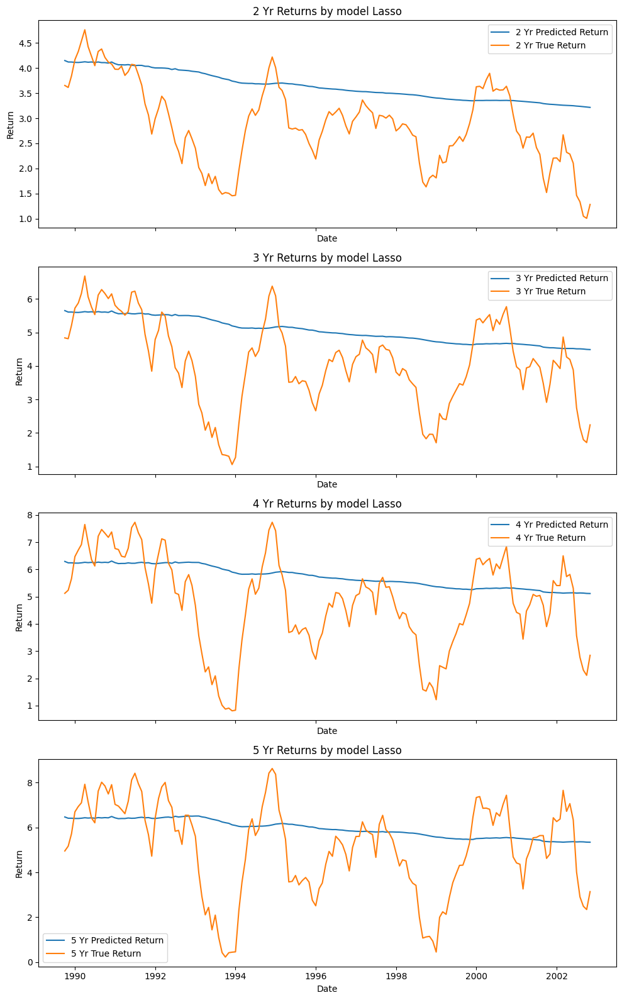

...

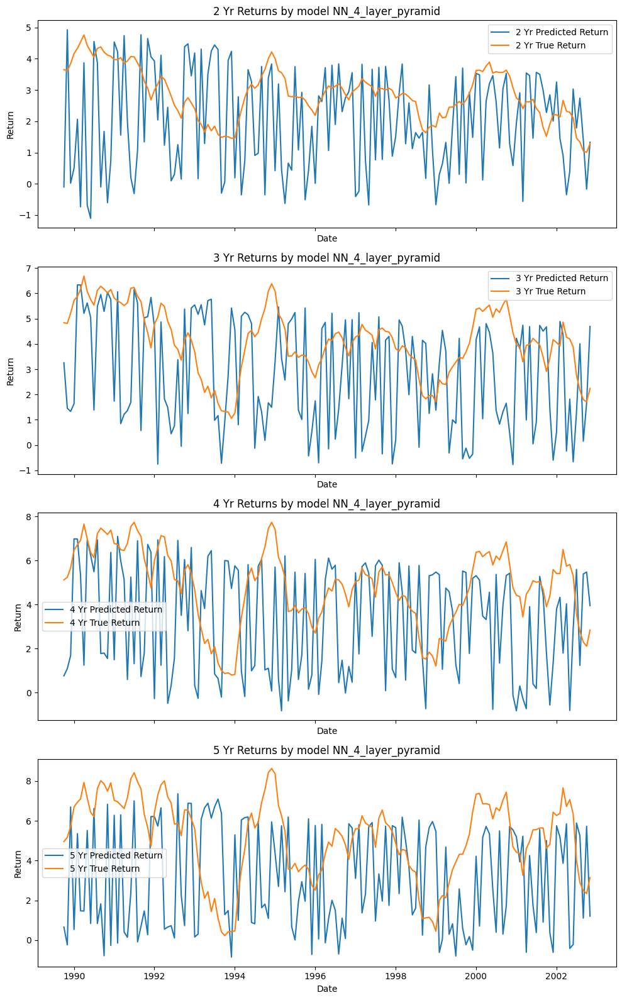

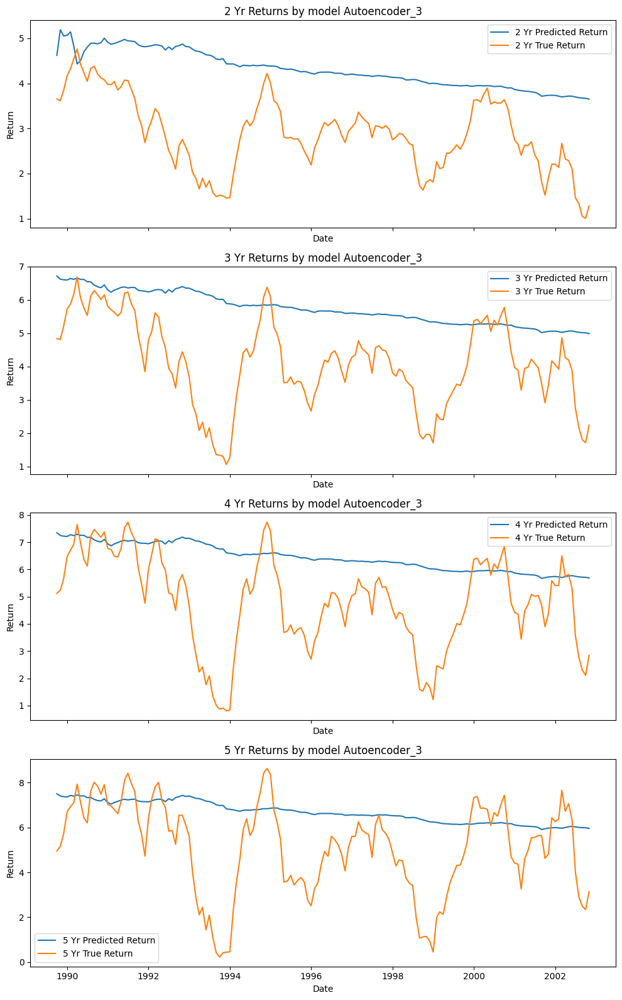

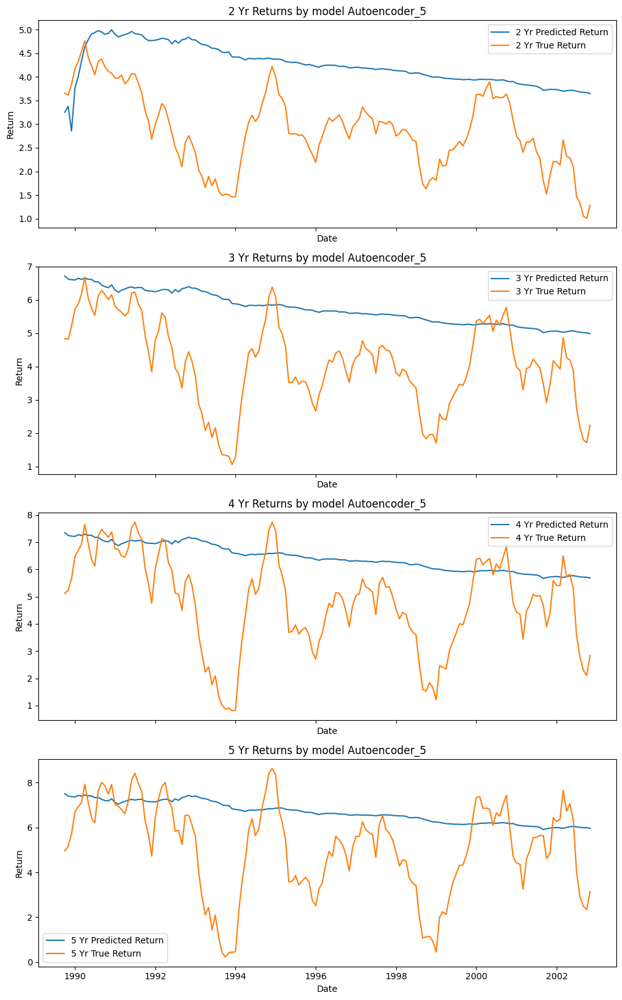

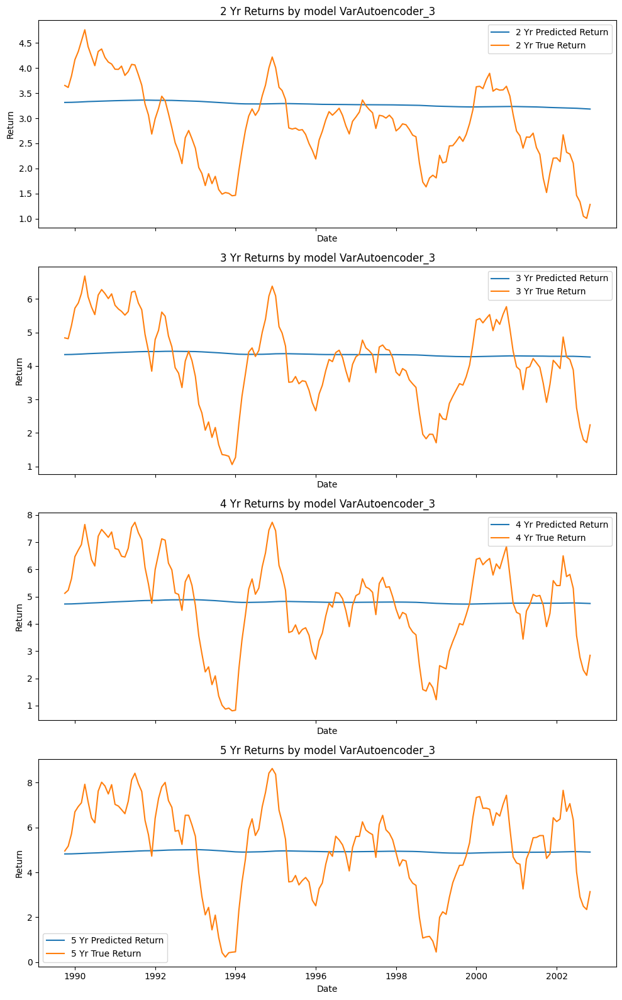

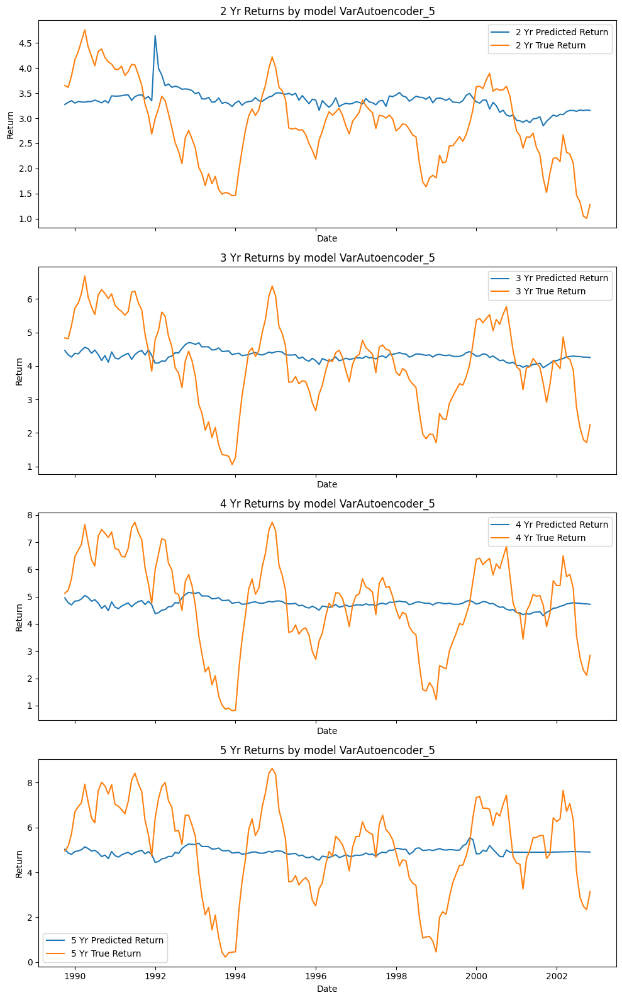

In [17]:
import pandas as pd
from functools import reduce

models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=142, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=142, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=142, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=142, latent_dim=5),
}


y_pred_lst = []

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()
        
    for model_name, model in models.items():
        _, _, y_pred, dateLst = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name} - macro')
        df_i = pd.DataFrame({
            'date': dateLst,
            f'{model_name}_{maturity}_pred_return': y_pred,
        })
        y_pred_lst.append(df_i)

# Assuming your list of DataFrames is named 'dfs'
pred_df = reduce(lambda left, right: pd.merge(left, right, on='date'), y_pred_lst)

excess_ret_df = preprocessed_data_macro[[f'{maturity}_excess_return' for maturity in required_maturities[1:]]].reset_index(drop=False)

pred_df = pd.merge(pred_df, excess_ret_df, how='left', on='date')
pred_df.head()


for model_name, _ in models.items():
    plot_pred_and_true_returns(pred_df, required_maturities[1:], model_name)

In [52]:
results

{'2 Yr': {'Ridge': {'MSPE': 0.6613385093140439,
   'R2_oos': 0.027828131815718304}},
 '3 Yr': {'Ridge': {'MSPE': 1.5837564660720242,
   'R2_oos': 0.07784715647977636}},
 '4 Yr': {'Ridge': {'MSPE': 2.716433874983614, 'R2_oos': 0.08318144891534274}},
 '5 Yr': {'Ridge': {'MSPE': 4.1108331300348135,
   'R2_oos': 0.02043262010968383}}}

In [14]:
plot_results_table_plotly(results)

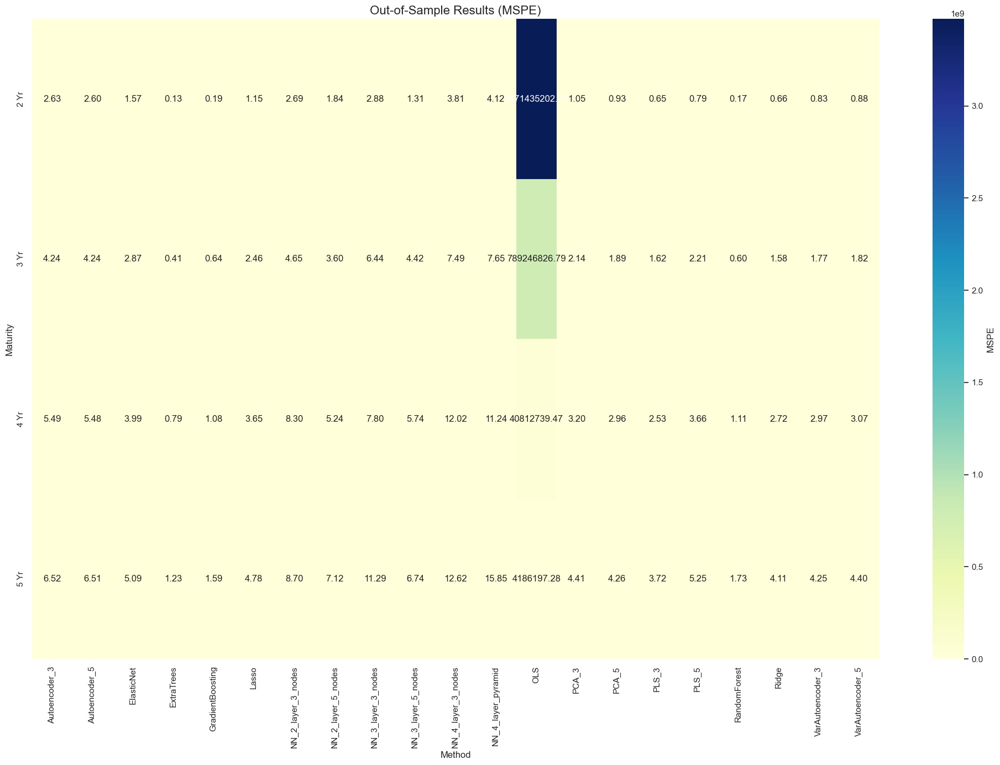

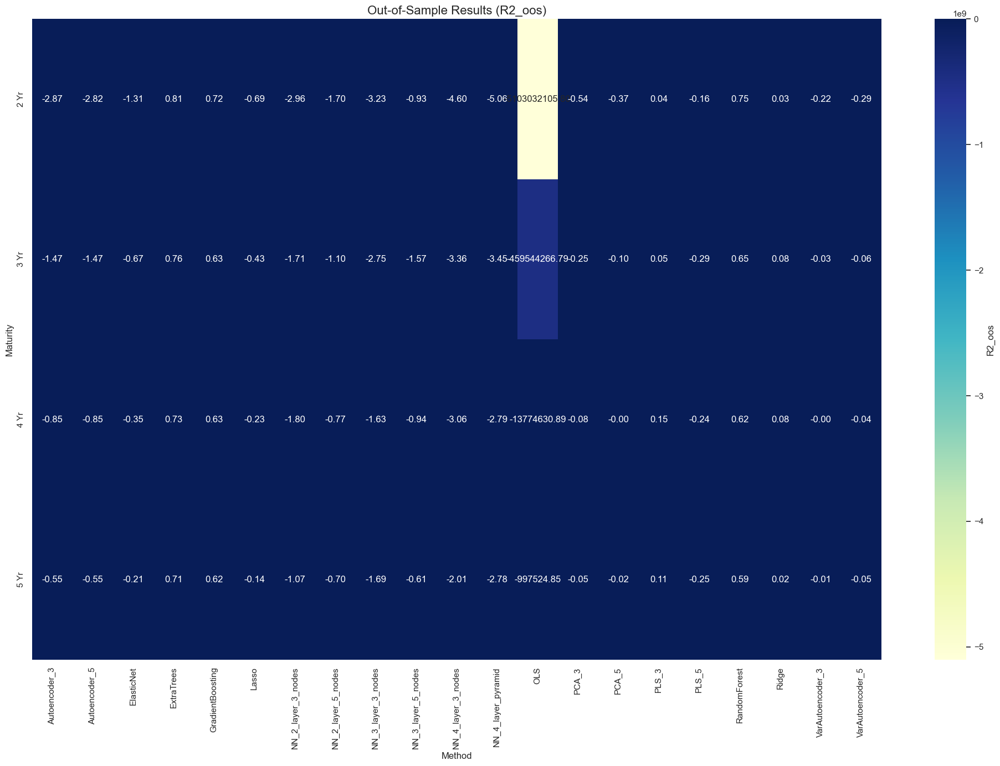

In [15]:
plot_results_table_seaborn(results, desc='macro')

This cell introduces a backtesting framework for a bond trading strategy using predicted excess returns from various machine learning models. The `DirectBondTradeBacktester` class is defined to simulate trades, manage positions, and calculate performance metrics. It includes methods for executing trades based on the model's predictions, calculating cumulative returns, plotting these returns, and printing key performance metrics such as the Sharpe ratio and maximum drawdown. Functions are also provided to generate these predictions and to facilitate the trading backtest over a historical dataset. The approach emphasizes a systematic trading strategy based on quantitative model outputs.

In [9]:
import sys
import re

# Create a regular expression pattern to match special JSON characters
pattern = re.compile(r'[\{\}\[\]:,]')

# Function to get predicted excess returns using only bond features
def get_predicted_excess_returns(data, models, train_size=0.7, epochs=100, lr=1e-3):
    predicted_returns = {}
    # Loop through each maturity except the first one
    for maturity in required_maturities[1:]:
        # Extract features and target for the current maturity
        X = data[feature_cols]
        y = data[f'{maturity}_excess_return']
        predicted_returns[maturity] = {}
        # Loop through each model
        for model_name, model in models.items():
            # Description for the model used in logging
            desc = f'{maturity} - {model_name}'
            # Perform recursive forecasting and get predictions and dates
            _, _, preds, dates = recursive_forecast(X, y, model, train_size, desc, epochs, lr)
            # Store predicted returns for the current model
            predicted_returns[maturity][model_name] = {'pred_return': preds}
    return predicted_returns, dates

# Function to get predicted excess returns using both bond and macro features
def get_predicted_excess_returns_macro(data, models, train_size=0.7, epochs=100, lr=1e-3, change_col=False):
    predicted_returns = {}
    # Loop through each maturity except the first one
    for maturity in required_maturities[1:]:
        # Extract features (bond and macro) and target for the current maturity
        X = data[feature_cols+macro_cols]
        y = data[f'{maturity}_excess_return']

        if change_col:
            # Replace any found characters with an underscore, or just remove them
            X.columns = [pattern.sub('_', col) for col in X.columns]

        predicted_returns[maturity] = {}
        # Loop through each model
        for model_name, model in models.items():
            # Description for the model used in logging
            desc = f'{maturity} - {model_name} - macro'
            # Perform recursive forecasting and get predictions and dates
            _, _, preds, dates = recursive_forecast(X, y, model, train_size, desc, epochs, lr)
            # Store predicted returns for the current model
            predicted_returns[maturity][model_name] = {'pred_return': preds}
    return predicted_returns, dates

# Class for backtesting direct bond trading strategy
class DirectBondTradeBacktester:
    def __init__(self, predicted_returns, dates, commission_rate, bond_prices, initial_capital=1000000, top_n=2):
        # Initialize backtester parameters
        self.predicted_returns = predicted_returns
        self.dates = dates
        self.commission_rate = commission_rate
        self.bond_prices = bond_prices
        self.initial_capital = initial_capital
        self.top_n = top_n
        self.positions = {}
        self.cash = [initial_capital]
        self.total_amount = [initial_capital]
        self.trades = []
        self.log = []
        self.returns = []
        self.flag = True

    # Method to execute trades based on predicted returns
    def execute_trade(self, idx):
        current_date = self.dates[idx]

        # Get predicted returns for the next month
        next_month_returns = {}
        for maturity in required_maturities[1:]:
            next_month_returns[maturity] = self.predicted_returns[maturity][self.model_name]['pred_return'][idx]

        # Sort maturities by predicted returns
        sorted_maturities = sorted(next_month_returns, key=next_month_returns.get, reverse=True)

        # Long top_n maturities and short bottom_n maturities
        long_positions = sorted_maturities[:self.top_n]
        short_positions = sorted_maturities[-self.top_n:]

        # Execute trades
        self.log.append(f"Long Positions: {long_positions}")
        self.log.append(f"Short Positions: {short_positions}")

        total_long_amount = 0
        total_short_amount = 0
        num_closed_positions = 0

        for maturity in required_maturities[1:]:
            current_price = self.bond_prices.loc[current_date, maturity]

            # Close positions that need to be closed
            if maturity in self.positions:
                if (maturity in long_positions and self.positions[maturity]['position'] == 'short') or \
                (maturity in short_positions and self.positions[maturity]['position'] == 'long') or \
                (maturity not in long_positions and maturity not in short_positions):
                    self.close_position(idx, maturity)
                    num_closed_positions += 1

        if num_closed_positions > 0 or self.flag:
            # Calculate the amount to allocate for each long and short position
            amount_per_position = self.cash[-1] / self.top_n

            # Open new long positions
            for maturity in long_positions:
                current_price = self.bond_prices.loc[current_date, maturity]
                if maturity not in self.positions or self.positions[maturity]['position'] == 'short':
                    self.open_position(idx, maturity, 'long', current_price, amount_per_position)
                    total_long_amount += amount_per_position

            # Open new short positions
            for maturity in short_positions:
                current_price = self.bond_prices.loc[current_date, maturity]
                if maturity not in self.positions or self.positions[maturity]['position'] == 'long':
                    self.open_position(idx, maturity, 'short', current_price, -amount_per_position)
                    total_short_amount += amount_per_position
        else:
            total_long_amount = self.last_long_amount
            total_short_amount = self.last_short_amount

        self.log.append(f"Total Long Amount: {total_long_amount:.2f}")
        self.log.append(f"Total Short Amount: {total_short_amount:.2f}")

        self.last_long_amount = total_long_amount
        self.last_short_amount = total_short_amount
        self.flag = False

        # Calculate total amount and return
        bond_value = sum(position['qty'] * self.bond_prices.loc[current_date, maturity] for maturity, position in self.positions.items())
        total_amount = self.cash[-1] + bond_value
        self.log.append(f"Total Amount: {total_amount:.2f}")
        self.total_amount.append(total_amount)

        if len(self.total_amount) > 1:
            current_return = (self.total_amount[-1] - self.total_amount[-2]) / self.total_amount[-2]
            self.returns.append(current_return)
            self.log.append(f"Return: {current_return:.4f}")
        else:
            self.returns.append(0)
            self.log.append("Return: 0.0000")

    # Method to open a new position
    def open_position(self, idx, maturity, position_type, current_price, amount):
        timestamp = self.dates[idx]
        qty = amount / current_price
        commission_fee = abs(qty) * current_price * self.commission_rate

        self.positions[maturity] = {
            'position': position_type,
            'qty': qty,
            'entry_price': current_price,
            'amount': amount
        }

        self.cash[-1] -= amount + commission_fee

        self.trades.append((f'open_{position_type}', idx, maturity, current_price, qty))
        self.log.append(f"Open {position_type.capitalize()} Position in {maturity} at Time {timestamp}")
        self.log.append(f"{'Bought' if position_type == 'long' else 'Sold'} {abs(qty):.2f} units at price {current_price:.4f}")
        self.log.append(f"Commission Fee: {commission_fee:.4f}")
        self.log.append(f"Current Cash: {self.cash[-1]:.2f}")
        self.log.append("---------------------------------------------------------------------")

    # Method to close an existing position
    def close_position(self, idx, maturity):
        timestamp = self.dates[idx]
        current_price = self.bond_prices.loc[timestamp, maturity]
        position_type = self.positions[maturity]['position']
        qty = self.positions[maturity]['qty']
        entry_price = self.positions[maturity]['entry_price']

        commission_fee = abs(qty) * current_price * self.commission_rate
        self.trades.append((f'close_{position_type}', idx, maturity, current_price, qty))

        if position_type == 'long':
            pnl = qty * (current_price - entry_price) - commission_fee
            self.cash[-1] += qty * current_price - commission_fee
        else:
            pnl = qty * (entry_price - current_price) - commission_fee
            self.cash[-1] -= abs(qty) * current_price + commission_fee

        del self.positions[maturity]

        self.log.append(f"Close {position_type.capitalize()} Position in {maturity} at Time {timestamp}")
        self.log.append(f"{'Sold' if position_type == 'long' else 'Bought'} {abs(qty):.2f} units at price {current_price:.4f}")
        self.log.append(f"PnL: {pnl:.2f}")
        self.log.append(f"Commission Fee: {commission_fee:.4f}")
        self.log.append(f"Current Cash: {self.cash[-1]:.2f}")
        self.log.append("---------------------------------------------------------------------")

    # Method to run the backtest for a specific model
    def run(self, model_name):
        self.model_name = model_name
        for idx in tqdm(range(len(self.dates) - 1), desc="Backtest Progress"):
            self.log.append("---------------------------------------------------------------------")
            self.log.append(f"Time {self.dates[idx]}:")
            self.log.append("---------------------------------------------------------------------")
            self.execute_trade(idx)

        self.returns = np.array(self.returns)

    # Method to calculate benchmark returns
    def calculate_benchmark_returns(self):
        benchmark_returns = []
        num_bonds = len(required_maturities[1:])
        amount_per_bond = {}

        for maturity in required_maturities[1:]:
            amount_per_bond[maturity] = self.initial_capital / num_bonds

        for idx in tqdm(range(len(self.dates) - 1), desc="Calculating Benchmark Returns"):
            current_date = self.dates[idx]
            next_date = self.dates[idx + 1]

            current_value = 0
            next_value = 0

            for maturity in required_maturities[1:]:
                current_price = self.bond_prices.loc[current_date, maturity]
                next_price = self.bond_prices.loc[next_date, maturity]

                current_value += amount_per_bond[maturity]
                next_value_i = amount_per_bond[maturity] / current_price * next_price
                next_value += next_value_i

                amount_per_bond[maturity] = next_value_i

            benchmark_return = (next_value - current_value) / current_value
            benchmark_returns.append(benchmark_return)

        benchmark_returns[0] -= self.commission_rate
        self.benchmark_returns = np.array(benchmark_returns)
        self.benchmark_cumulative_returns = np.cumprod(1 + self.benchmark_returns)

    # Method to display the log
    def display_log(self):
        for entry in self.log:
            self.log.append(entry)

    # Method to save the log to a file
    def save_log(self, filename):
        with open(filename, 'w') as f:
            for entry in self.log:
                f.write(entry + '\n')

    # Method to plot cumulative returns
    def plot_cumulative_returns(self, desc):
        self.cumulative_returns = np.cumprod(1 + self.returns)

        plt.figure(figsize=(10, 6))
        plt.plot(self.cumulative_returns, label='Strategy Returns')
        plt.plot(self.benchmark_cumulative_returns, label='Benchmark Returns')
        plt.xlabel('Time')
        plt.ylabel('Cumulative Returns')
        plt.title('Cumulative Returns')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'Graph/{desc} Cumulative Return.png')
        plt.show()

    # Method to calculate performance metrics
    def calculate_metrics(self):
        self.cumulative_return = self.cumulative_returns[-1] - 1
        self.sharpe_ratio = np.sqrt(12) * np.mean(self.returns) / np.std(self.returns)
        self.max_drawdown = np.max(1 - self.cumulative_returns / np.maximum.accumulate(self.cumulative_returns))
        self.win_ratio = np.sum(self.returns > 0) / np.sum(self.returns != 0)

    # Method to print performance metrics
    def print_metrics(self):
        print("----------------------------------------------------------------")
        print(f"Strategy info by model {self.model_name}")
        print(f"Cumulative Return: {self.cumulative_return:.2%}")
        print(f"Sharpe Ratio: {self.sharpe_ratio:.2f}")
        print(f"Max Drawdown: {self.max_drawdown:.2%}")
        print(f"Win Ratio: {self.win_ratio:.2%}")

        # Additional metrics for the strategy
        annual_return = np.mean(self.returns) * 12
        print(f"Annual Return: {annual_return:.2%}")

        volatility = np.std(self.returns) * np.sqrt(12)
        print(f"Annual Volatility: {volatility:.2%}")

        # Calculate and print metrics for the benchmark
        benchmark_cumulative_return = self.benchmark_cumulative_returns[-1] - 1
        benchmark_sharpe_ratio = np.sqrt(12) * np.mean(self.benchmark_returns) / np.std(self.benchmark_returns)
        benchmark_max_drawdown = np.max(1 - self.benchmark_cumulative_returns / np.maximum.accumulate(self.benchmark_cumulative_returns))
        benchmark_win_ratio = np.sum(self.benchmark_returns > 0) / np.sum(self.benchmark_returns != 0)

        print("----------------------------------------------------------------")
        print("Benchmark info")
        print(f"Cumulative Return: {benchmark_cumulative_return:.2%}")
        print(f"Sharpe Ratio: {benchmark_sharpe_ratio:.2f}")
        print(f"Max Drawdown: {benchmark_max_drawdown:.2%}")
        print(f"Win Ratio: {benchmark_win_ratio:.2%}")

        # Additional metrics for the benchmark
        benchmark_annual_return = np.mean(self.benchmark_returns) * 12
        print(f"Annual Return: {benchmark_annual_return:.2%}")

        benchmark_volatility = np.std(self.benchmark_returns) * np.sqrt(12)
        print(f"Annual Volatility: {benchmark_volatility:.2%}")

Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 28219.66it/s]


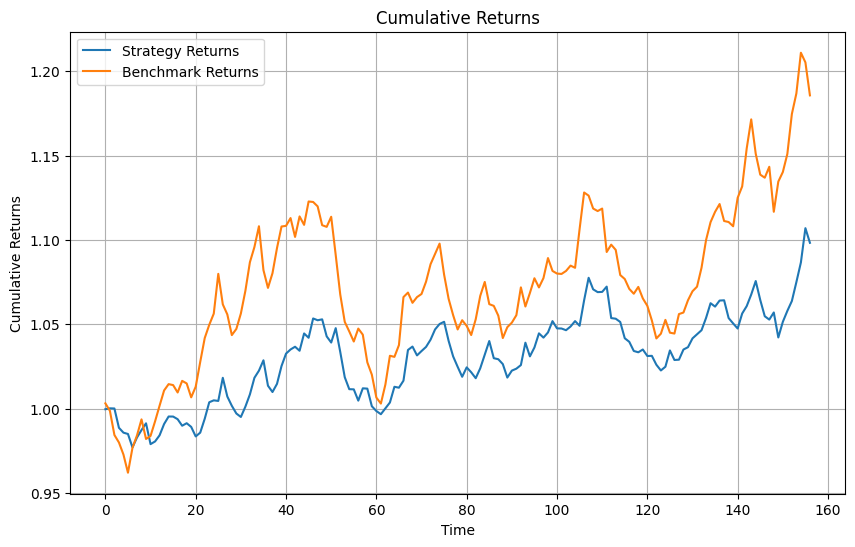

----------------------------------------------------------------
Strategy info by model PCA_3
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 32807.18it/s]


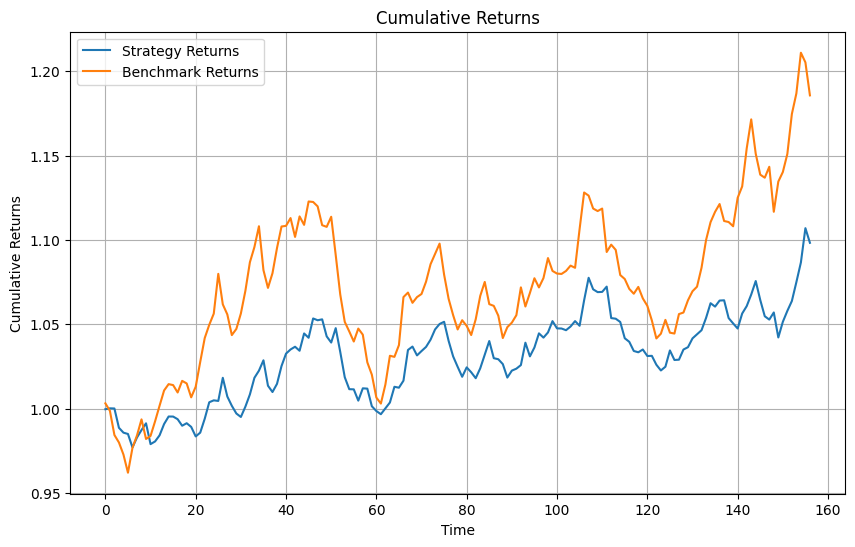

----------------------------------------------------------------
Strategy info by model PCA_5
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31442.76it/s]


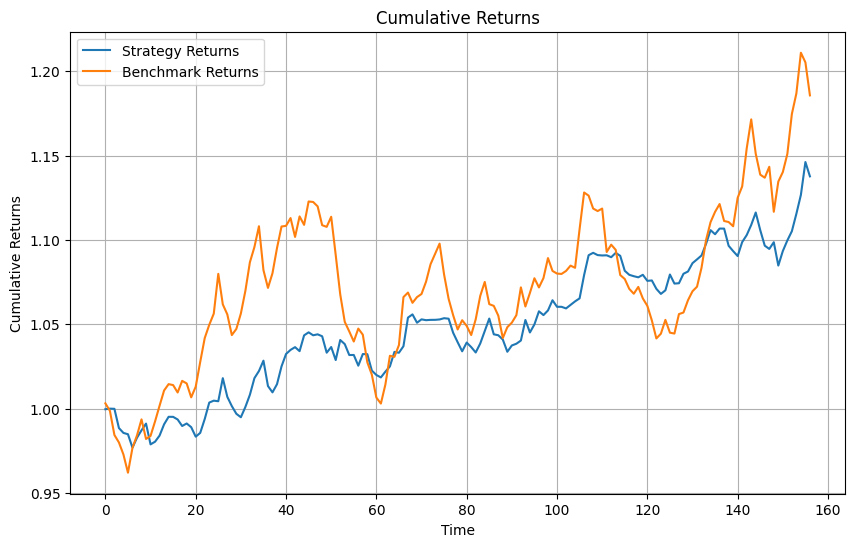

----------------------------------------------------------------
Strategy info by model OLS
Cumulative Return: 13.77%
Sharpe Ratio: 0.50
Max Drawdown: 2.82%
Win Ratio: 54.78%
Annual Return: 1.01%
Annual Volatility: 2.02%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 30915.76it/s]


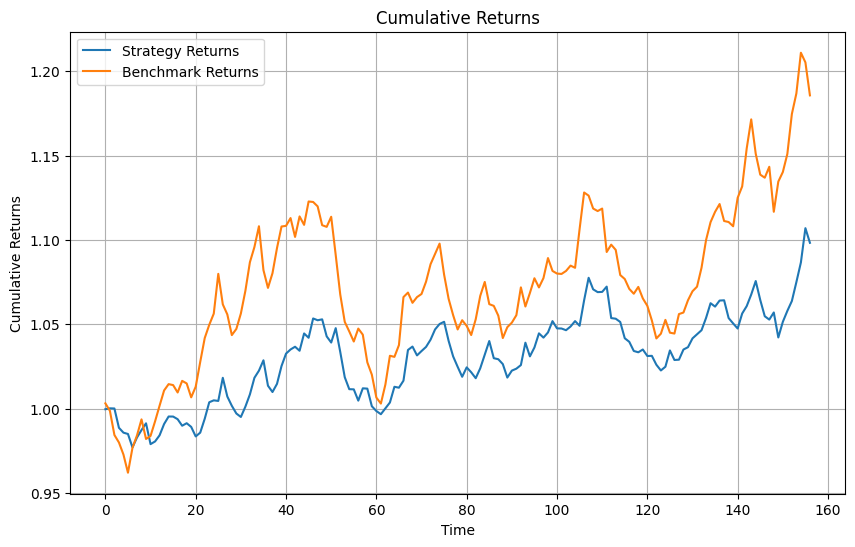

----------------------------------------------------------------
Strategy info by model Ridge
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 33588.66it/s]


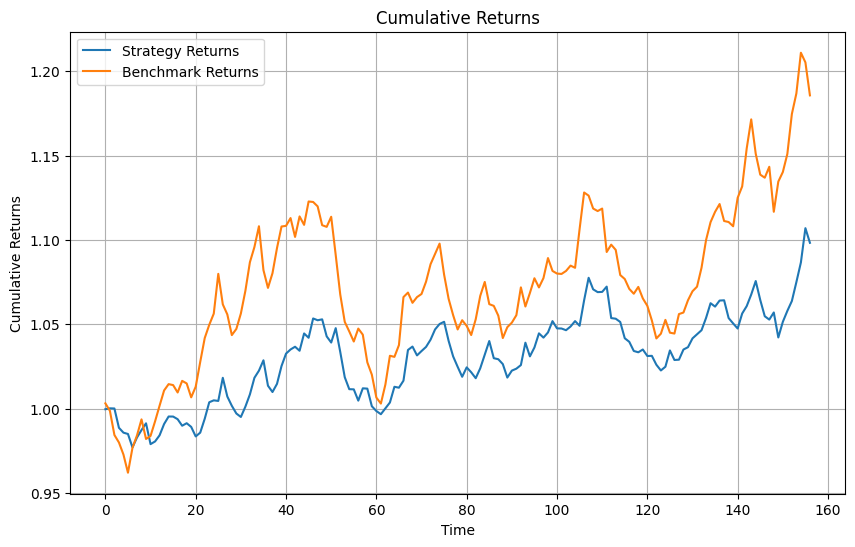

----------------------------------------------------------------
Strategy info by model Lasso
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 42552.87it/s]


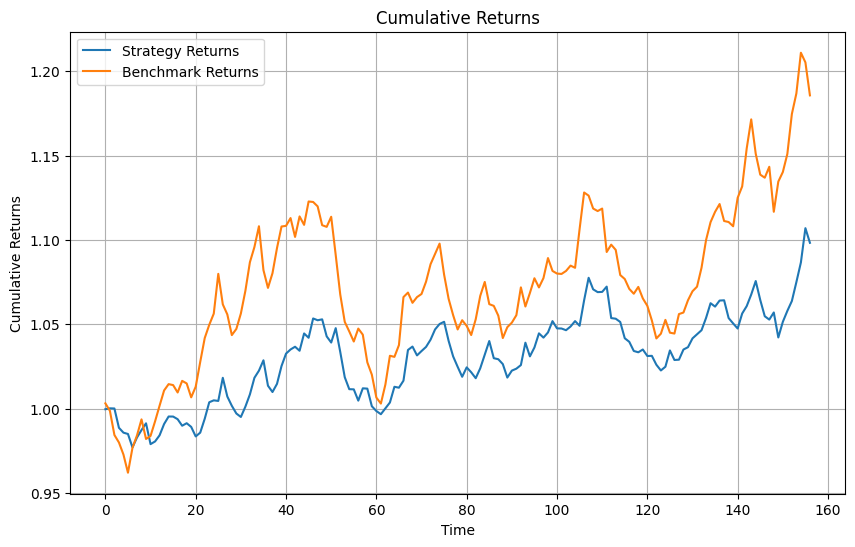

----------------------------------------------------------------
Strategy info by model ElasticNet
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 27928.82it/s]


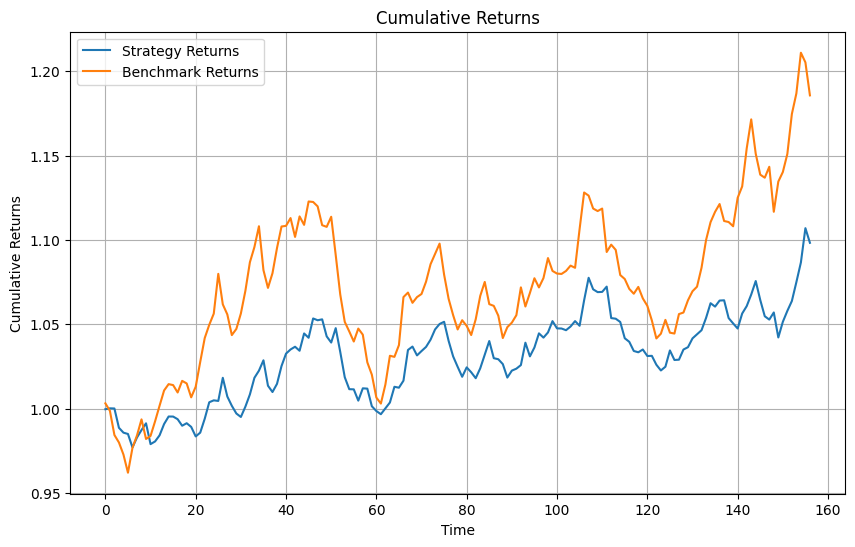

----------------------------------------------------------------
Strategy info by model PLS_3
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 30722.48it/s]


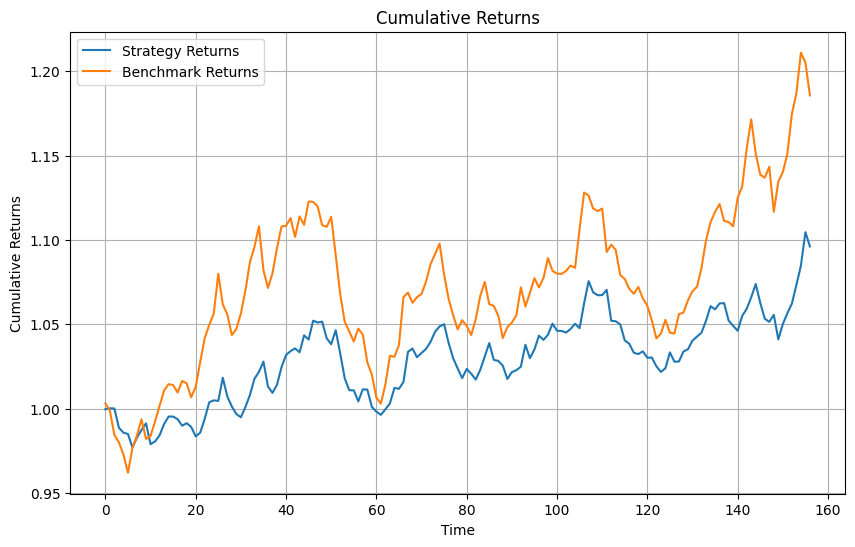

----------------------------------------------------------------
Strategy info by model PLS_5
Cumulative Return: 9.61%
Sharpe Ratio: 0.32
Max Drawdown: 5.31%
Win Ratio: 53.50%
Annual Return: 0.73%
Annual Volatility: 2.30%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31444.26it/s]


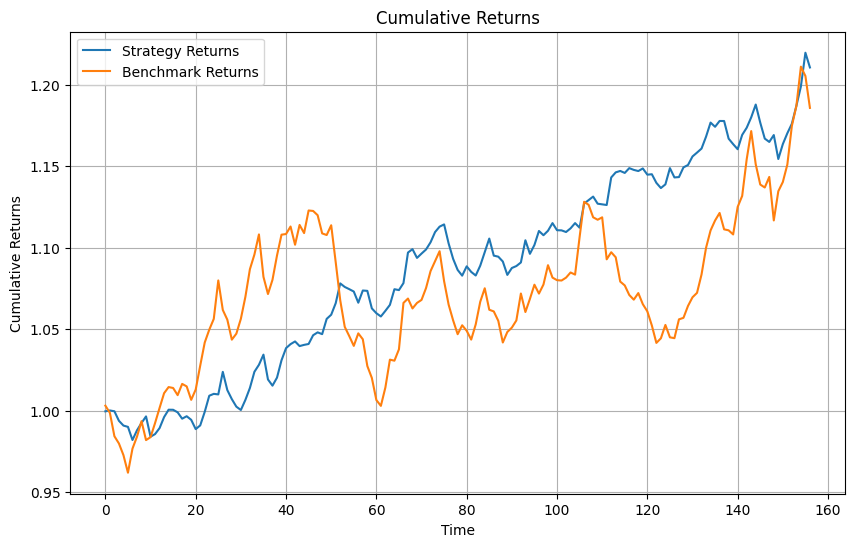

----------------------------------------------------------------
Strategy info by model GradientBoosting
Cumulative Return: 21.05%
Sharpe Ratio: 0.73
Max Drawdown: 2.82%
Win Ratio: 57.32%
Annual Return: 1.48%
Annual Volatility: 2.04%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 33847.63it/s]


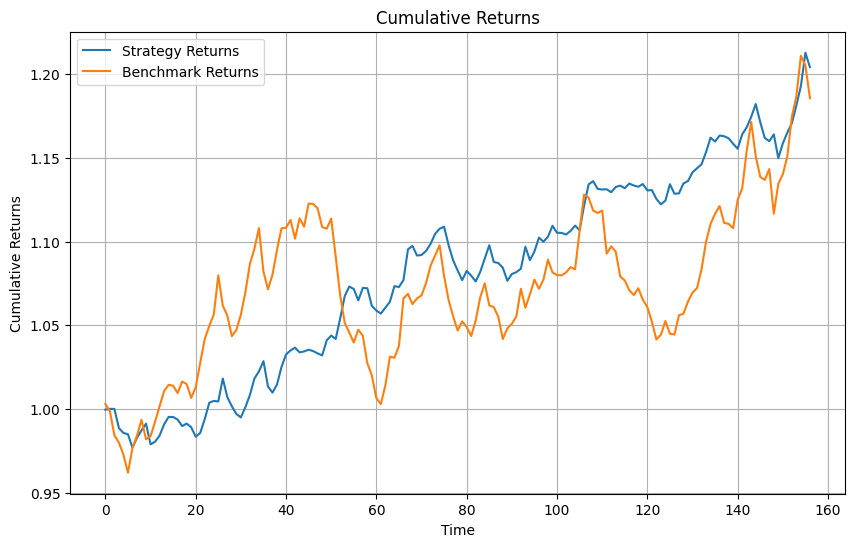

----------------------------------------------------------------
Strategy info by model RandomForest
Cumulative Return: 20.42%
Sharpe Ratio: 0.71
Max Drawdown: 2.95%
Win Ratio: 56.69%
Annual Return: 1.44%
Annual Volatility: 2.02%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31314.17it/s]


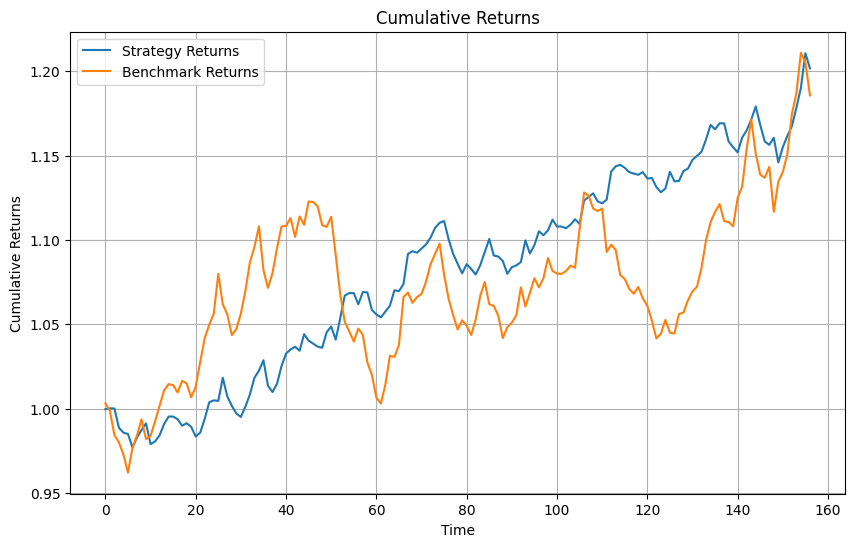

----------------------------------------------------------------
Strategy info by model ExtraTrees
Cumulative Return: 20.18%
Sharpe Ratio: 0.69
Max Drawdown: 2.86%
Win Ratio: 56.05%
Annual Return: 1.43%
Annual Volatility: 2.07%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31466.80it/s]


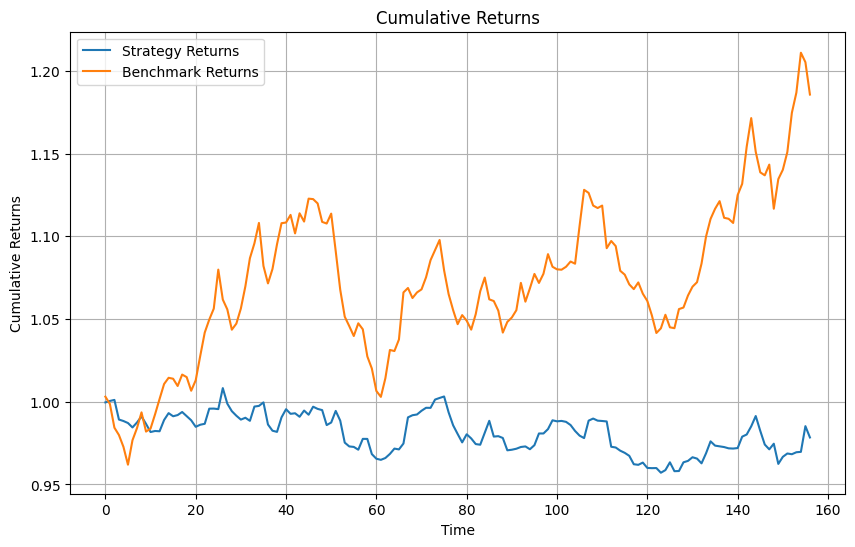

----------------------------------------------------------------
Strategy info by model NN_2_layer_3_nodes
Cumulative Return: -2.16%
Sharpe Ratio: -0.09
Max Drawdown: 5.07%
Win Ratio: 47.13%
Annual Return: -0.15%
Annual Volatility: 1.75%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 30869.39it/s]


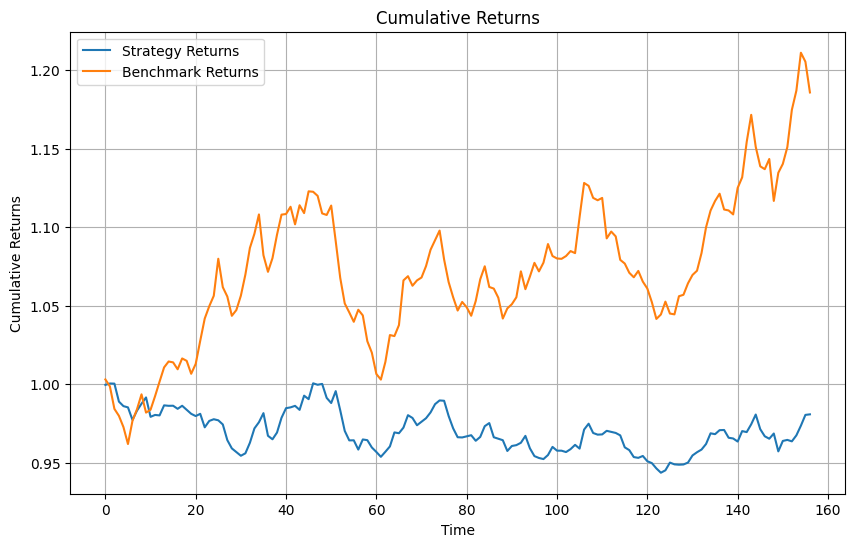

----------------------------------------------------------------
Strategy info by model NN_2_layer_5_nodes
Cumulative Return: -1.92%
Sharpe Ratio: -0.07
Max Drawdown: 5.69%
Win Ratio: 48.41%
Annual Return: -0.13%
Annual Volatility: 1.77%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31211.76it/s]


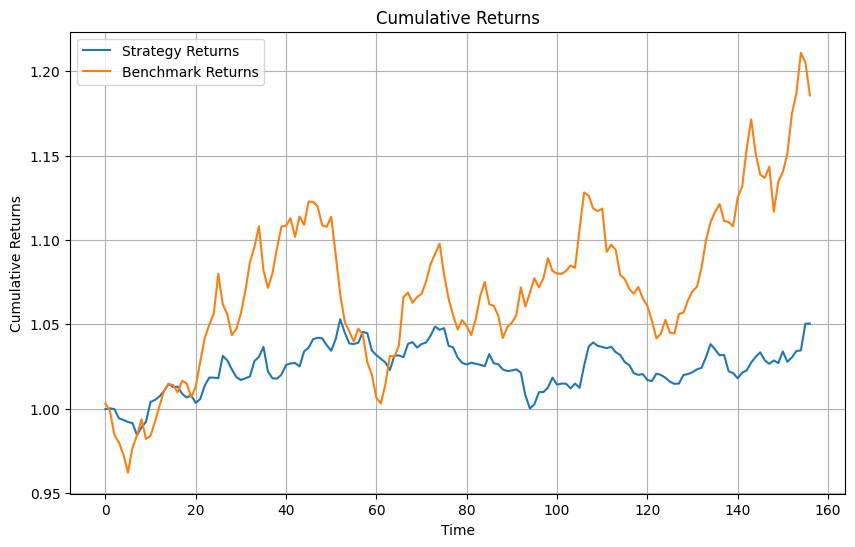

----------------------------------------------------------------
Strategy info by model NN_3_layer_3_nodes
Cumulative Return: 5.03%
Sharpe Ratio: 0.24
Max Drawdown: 5.03%
Win Ratio: 49.04%
Annual Return: 0.39%
Annual Volatility: 1.62%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 26206.05it/s]


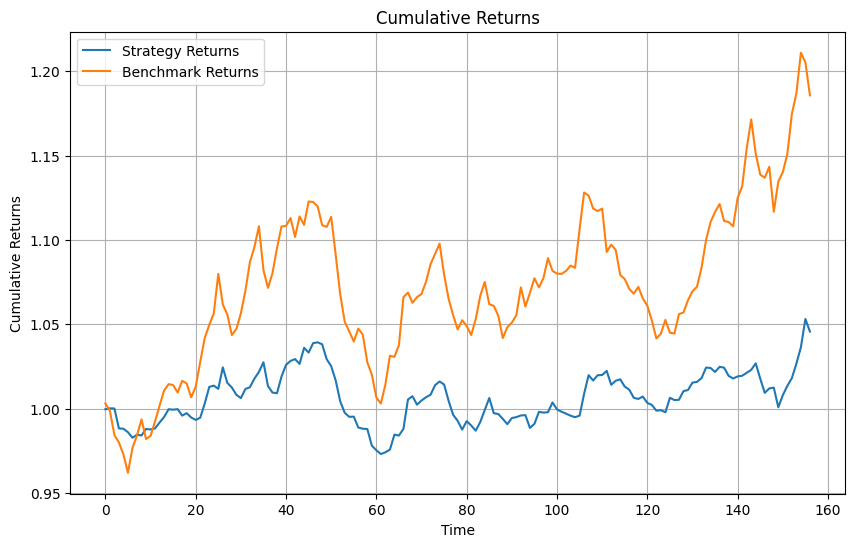

----------------------------------------------------------------
Strategy info by model NN_3_layer_5_nodes
Cumulative Return: 4.56%
Sharpe Ratio: 0.19
Max Drawdown: 6.38%
Win Ratio: 52.23%
Annual Return: 0.36%
Annual Volatility: 1.85%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 34384.93it/s]


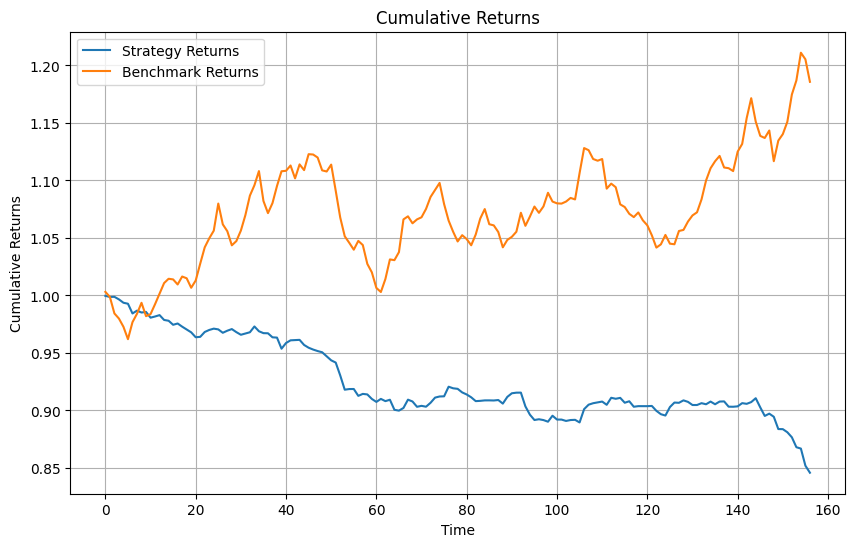

----------------------------------------------------------------
Strategy info by model NN_4_layer_3_nodes
Cumulative Return: -15.42%
Sharpe Ratio: -0.87
Max Drawdown: 15.38%
Win Ratio: 43.31%
Annual Return: -1.27%
Annual Volatility: 1.46%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 39880.43it/s]


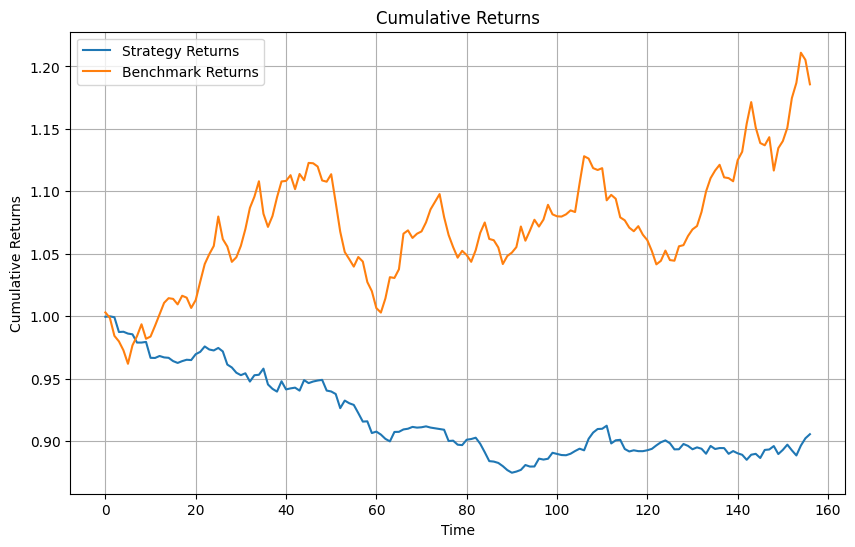

----------------------------------------------------------------
Strategy info by model NN_4_layer_pyramid
Cumulative Return: -9.44%
Sharpe Ratio: -0.48
Max Drawdown: 12.52%
Win Ratio: 47.13%
Annual Return: -0.75%
Annual Volatility: 1.56%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 31651.32it/s]


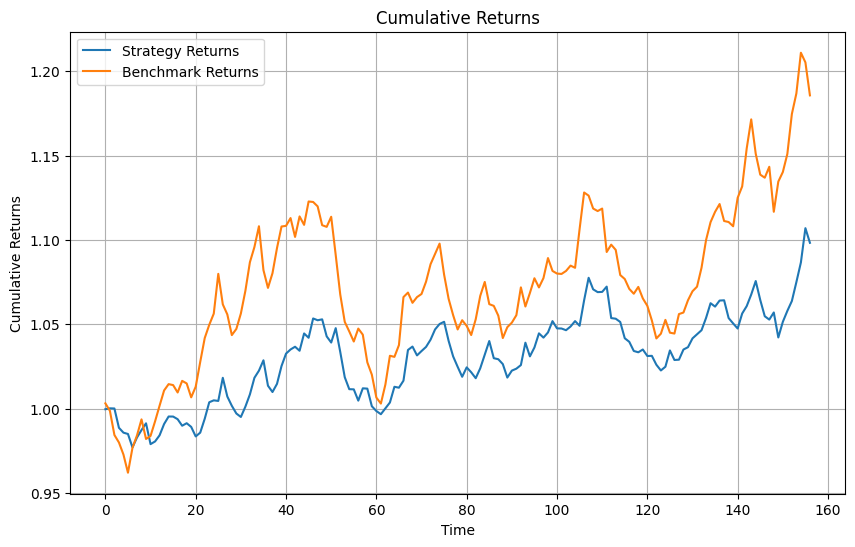

----------------------------------------------------------------
Strategy info by model Autoencoder_3
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 33450.46it/s]


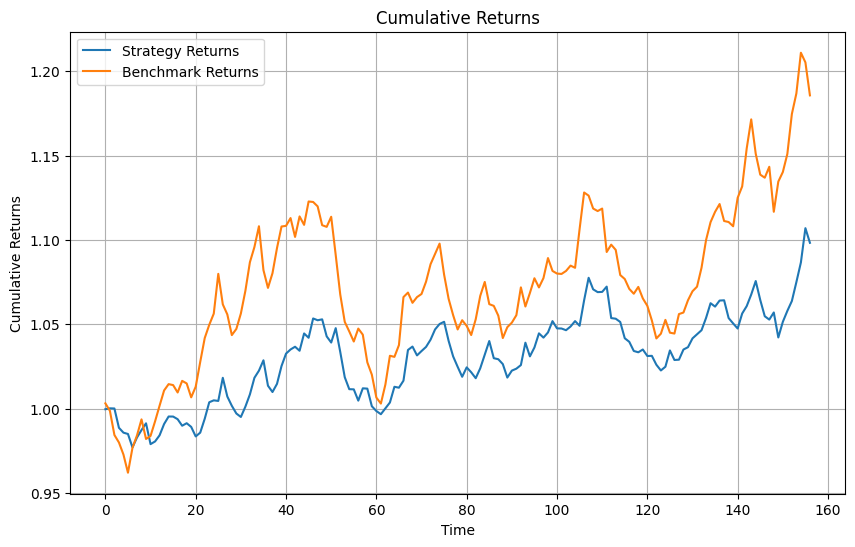

----------------------------------------------------------------
Strategy info by model Autoencoder_5
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 33872.01it/s]


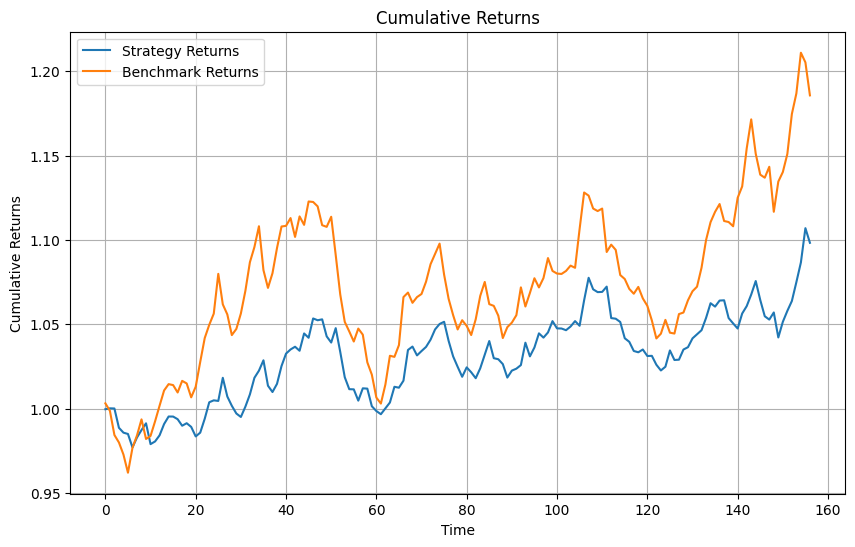

----------------------------------------------------------------
Strategy info by model VarAutoencoder_3
Cumulative Return: 9.83%
Sharpe Ratio: 0.32
Max Drawdown: 5.39%
Win Ratio: 53.50%
Annual Return: 0.74%
Annual Volatility: 2.33%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 40228.83it/s]


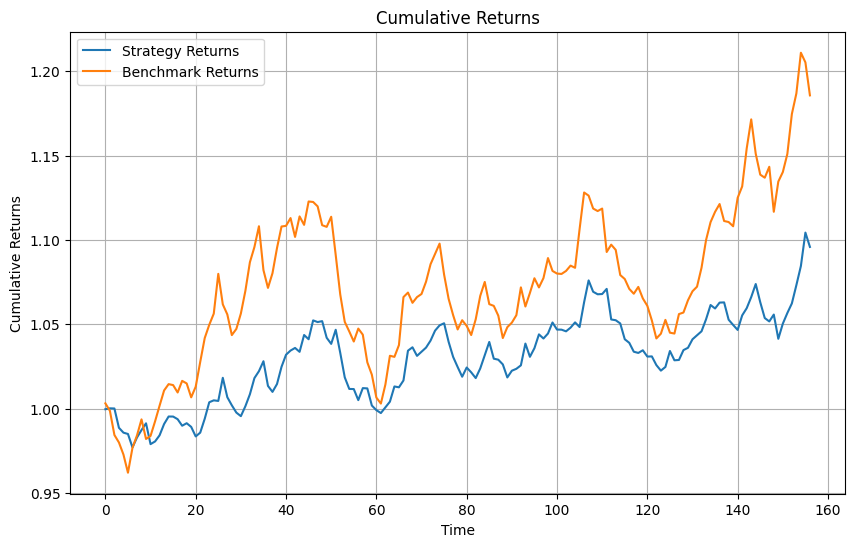

----------------------------------------------------------------
Strategy info by model VarAutoencoder_5
Cumulative Return: 9.58%
Sharpe Ratio: 0.32
Max Drawdown: 5.22%
Win Ratio: 53.50%
Annual Return: 0.73%
Annual Volatility: 2.28%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


In [19]:
# Define your models
models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=142, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=142, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=142, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=142, latent_dim=5),
}

# Get the predicted excess returns
predicted_returns, dates = get_predicted_excess_returns_macro(preprocessed_data_macro, models, train_size=0.7, epochs=100, lr=1e-3)

for model_name, model in models.items():

    # Create an instance of the DirectBondTradeBacktester class
    backtester = DirectBondTradeBacktester(predicted_returns, dates, commission_rate=2e-4, bond_prices=prices, initial_capital=1000000)

    # Run the backtest
    backtester.run(model_name=model_name)

    # Analyze the results
    # backtester.display_log()
    backtester.save_log('backtest_log.txt')
    backtester.calculate_benchmark_returns()
    backtester.plot_cumulative_returns(desc=f'{model_name} macro')
    backtester.calculate_metrics()
    backtester.print_metrics()

Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 23993.65it/s]


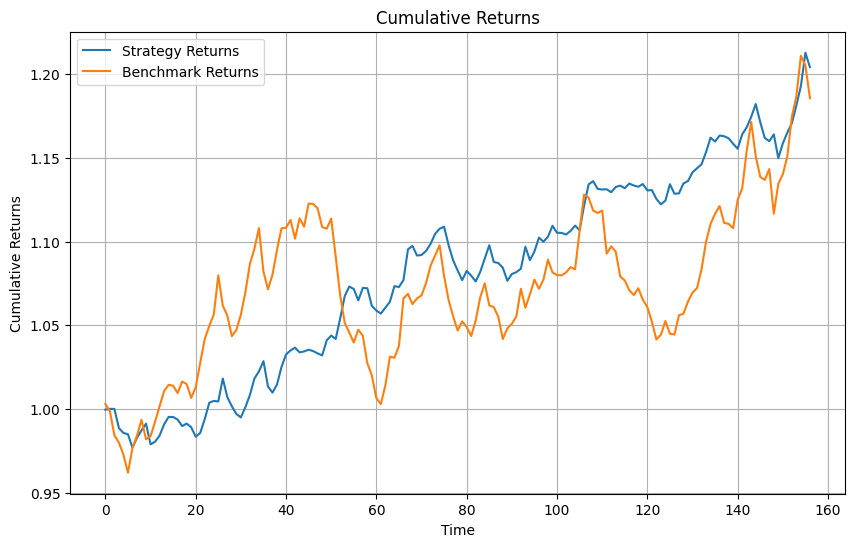

----------------------------------------------------------------
Strategy info by model RandomForest
Cumulative Return: 20.42%
Sharpe Ratio: 0.71
Max Drawdown: 2.95%
Win Ratio: 56.69%
Annual Return: 1.44%
Annual Volatility: 2.02%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


In [57]:
# Define your models
models = {
    # 'PCA_3': PCA(n_components=3),
    # 'PCA_5': PCA(n_components=5),
    # 'OLS': LinearRegression(),
    # 'Ridge': Ridge(),
    # 'Lasso': Lasso(),
    # 'ElasticNet': ElasticNet(),
    # 'PLS_3': PLSRegression(n_components=3),
    # 'PLS_5': PLSRegression(n_components=5),
    # 'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    # 'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    # 'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    # 'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    # 'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    # 'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    # 'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    # 'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    # 'Autoencoder_3': Autoencoder(input_dim=142, encoding_dim=3),
    # 'Autoencoder_5': Autoencoder(input_dim=142, encoding_dim=5),
    # 'VarAutoencoder_3': VAE(input_dim=142, latent_dim=3),
    # 'VarAutoencoder_5': VAE(input_dim=142, latent_dim=5),
}

# Get the predicted excess returns
predicted_returns, dates = get_predicted_excess_returns_macro(preprocessed_data_macro, models, train_size=0.7, epochs=100, lr=1e-3)

# Create an instance of the DirectBondTradeBacktester class
backtester = DirectBondTradeBacktester(predicted_returns, dates, commission_rate=2e-4, bond_prices=prices, initial_capital=1000000)

# model_name = 'Ridge'
# model_name = 'GradientBoosting'
model_name = 'RandomForest'
# model_name = 'ExtraTrees'
# model_name = 'NN_2_layer_3_nodes'
# model_name = 'NN_4_layer_pyramid'
# model_name = 'Autoencoder_3'
# model_name = 'Autoencoder_5'

# Run the backtest
backtester.run(model_name=model_name)

# Analyze the results
# backtester.display_log()
backtester.save_log('backtest_log.txt')
backtester.calculate_benchmark_returns()
backtester.plot_cumulative_returns(desc=f'{model_name} macro')
backtester.calculate_metrics()
backtester.print_metrics()

In [16]:
import pandas as pd
from functools import reduce

models = {
    'PCA_3': PCA(n_components=3),
    'PCA_5': PCA(n_components=5),
    'OLS': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'PLS_3': PLSRegression(n_components=3),
    'PLS_5': PLSRegression(n_components=5),
    'GradientBoosting': GradientBoostingRegressor(),
    'RandomForest': RandomForestRegressor(n_jobs=-1),
    'ExtraTrees': ExtraTreesRegressor(n_jobs=-1),
    'NN_2_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3,)),
    'NN_2_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5,)),
    'NN_3_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3)),
    'NN_3_layer_5_nodes': MLPRegressor(hidden_layer_sizes=(5, 5)),
    'NN_4_layer_3_nodes': MLPRegressor(hidden_layer_sizes=(3, 3, 3)),
    'NN_4_layer_pyramid': MLPRegressor(hidden_layer_sizes=(4, 3, 2)),
    'Autoencoder_3': Autoencoder(input_dim=142, encoding_dim=3),
    'Autoencoder_5': Autoencoder(input_dim=142, encoding_dim=5),
    'VarAutoencoder_3': VAE(input_dim=142, latent_dim=3),
    'VarAutoencoder_5': VAE(input_dim=142, latent_dim=5),
}


y_pred_lst = []

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()
        
    for model_name, model in models.items():
        _, _, y_pred, dateLst = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name} - macro')
        df_i = pd.DataFrame({
            'date': dateLst,
            f'{model_name}_{maturity}_pred_return': y_pred,
        })
        y_pred_lst.append(df_i)

# Assuming your list of DataFrames is named 'dfs'
pred_df = reduce(lambda left, right: pd.merge(left, right, on='date'), y_pred_lst)

excess_ret_df = preprocessed_data_macro[[f'{maturity}_excess_return' for maturity in required_maturities[1:]]].reset_index(drop=False)

pred_df = pd.merge(pred_df, excess_ret_df, how='left', on='date')
pred_df.head()

5 Yr - VarAutoencoder_5 - macro: 100%|██████████| 158/158 [00:02<00:00, 76.75it/s, Month=2002-11]


,date,PCA_3_2 Yr_pred_return,PCA_5_2 Yr_pred_return,OLS_2 Yr_pred_return,Ridge_2 Yr_pred_return,Lasso_2 Yr_pred_return,ElasticNet_2 Yr_pred_return,PLS_3_2 Yr_pred_return,PLS_5_2 Yr_pred_return,GradientBoosting_2 Yr_pred_return,...,NN_4_layer_3_nodes_5 Yr_pred_return,NN_4_layer_pyramid_5 Yr_pred_return,Autoencoder_3_5 Yr_pred_return,Autoencoder_5_5 Yr_pred_return,VarAutoencoder_3_5 Yr_pred_return,VarAutoencoder_5_5 Yr_pred_return,2 Yr_excess_return,3 Yr_excess_return,4 Yr_excess_return,5 Yr_excess_return
0,1989-10,4.201330,4.274871,3.665735,4.277750,4.149506,4.433051,3.744225,4.288642,3.802354,...,0.993032,0.654903,7.503768,7.502726,4.820745,5.026875,3.653176,4.839161,5.124039,4.952801
1,1989-11,4.262489,4.153061,3.842856,4.111774,4.120674,4.396087,3.861642,4.341760,3.699554,...,0.276962,-0.237224,7.403543,7.402623,4.821679,4.862410,3.613801,4.814760,5.237164,5.167073
2,1989-12,4.277829,4.230380,3.647667,4.315614,4.120003,4.395850,3.740430,4.179890,3.586338,...,6.779888,6.695443,7.370818,7.371155,4.824095,4.802765,3.844253,5.213603,5.664529,5.720646
3,1990-01,4.286107,4.335463,4.247190,4.376485,4.113256,4.386100,3.888355,4.472983,3.931678,...,-0.071761,0.535740,7.363336,7.363058,4.829116,4.927811,4.167225,5.726859,6.473913,6.696921
4,1990-02,4.271412,4.352713,4.442507,4.253041,4.111184,4.381979,4.028375,4.711613,4.265930,...,6.595595,5.353977,7.429237,7.429240,4.834753,4.957912,4.331439,5.881881,6.716543,6.937260


In [17]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_pred_and_true_returns(data, maturities, model_name):
    # Convert the 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'])

    # Create a figure with subplots for each maturity
    fig, axes = plt.subplots(len(maturities), 1, figsize=(10, 4*len(maturities)), sharex=True)

    # Iterate over each maturity
    for i, maturity in enumerate(maturities):
        # Get the corresponding predicted return and true return columns
        pred_return_col = f'{model_name}_{maturity}_pred_return'
        true_return_col = f'{maturity}_excess_return'

        # Plot the predicted return and true return for the current maturity
        axes[i].plot(data['date'], data[pred_return_col], label=f'{maturity} Predicted Return')
        axes[i].plot(data['date'], data[true_return_col], label=f'{maturity} True Return')

        # Set the title and labels for the current subplot
        axes[i].set_title(f'{maturity} Returns by model {model_name}')
        axes[i].set_xlabel('Date')
        axes[i].set_ylabel('Return')

        # Add a legend to the current subplot
        axes[i].legend()

    # Adjust the spacing between subplots
    plt.tight_layout()

    # Display the plot
    plt.savefig(f"Graph/{model_name}_fit_curve.png")
    plt.show()

In [ ]:
for model_name, _ in models.items():
    plot_pred_and_true_returns(pred_df, required_maturities[1:], model_name)

## More machine learning models

In [24]:
from sklearn.ensemble import AdaBoostRegressor
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor

import re

# Create a regular expression pattern to match special JSON characters
pattern = re.compile(r'[\{\}\[\]:,]')


models = {
    'AdaBoost': AdaBoostRegressor(),
    'LightGBM': LGBMRegressor(n_jobs=-1),
    'Xgboost': XGBRegressor(n_jobs=-1),
    'CatBoost': CatBoostRegressor(verbose=False),
}


results = {}

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()
    
    results[maturity] = {}
    
    for model_name, model in models.items():
        # Replace any found characters with an underscore, or just remove them
        X.columns = [pattern.sub('_', col) for col in X.columns]
        mse, r2, _, _ = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name} - macro')
        results[maturity][model_name] = {'MSPE': mse, 'R2_oos': r2}

5 Yr - CatBoost - macro: 100%|██████████| 158/158 [00:02<00:00, 56.70it/s, Month=2002-11]


In [25]:
results

{'2 Yr': {'AdaBoost': {'MSPE': 0.3538019405719441,
   'R2_oos': 0.4799088686218942},
  'LightGBM': {'MSPE': 0.18562667974799754, 'R2_oos': 0.7271275852019647},
  'Xgboost': {'MSPE': 0.1438828176486968, 'R2_oos': 0.7884913313482417},
  'CatBoost': {'MSPE': 0.1430912819923037, 'R2_oos': 0.7896548938611948}},
 '3 Yr': {'AdaBoost': {'MSPE': 1.1128713719596888,
   'R2_oos': 0.352023166370953},
  'LightGBM': {'MSPE': 0.6532198727803868, 'R2_oos': 0.6196583401346261},
  'Xgboost': {'MSPE': 0.46509913443003453, 'R2_oos': 0.7291929040093046},
  'CatBoost': {'MSPE': 0.4725545942919857, 'R2_oos': 0.7248519124119661}},
 '4 Yr': {'AdaBoost': {'MSPE': 2.0989146006112565,
   'R2_oos': 0.291599232101885},
  'LightGBM': {'MSPE': 1.1718639750460385, 'R2_oos': 0.6044863666425537},
  'Xgboost': {'MSPE': 0.9212914461648777, 'R2_oos': 0.6890566354004598},
  'CatBoost': {'MSPE': 0.9421213688425876, 'R2_oos': 0.6820263668912738}},
 '5 Yr': {'AdaBoost': {'MSPE': 2.976286091719347,
   'R2_oos': 0.29078299302194

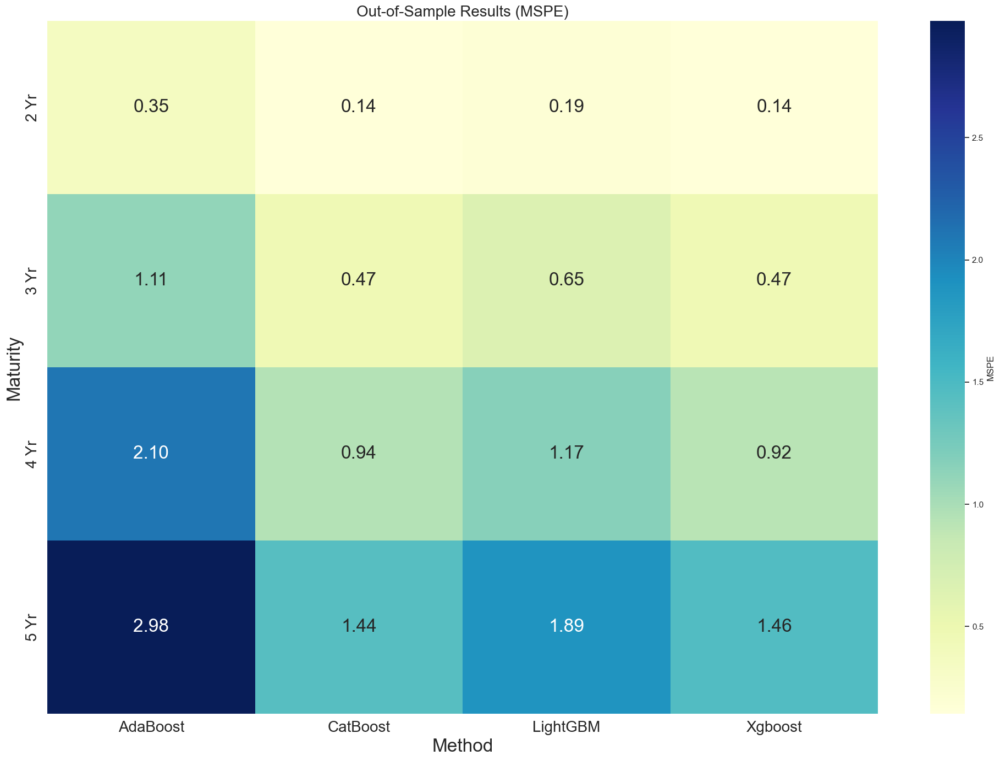

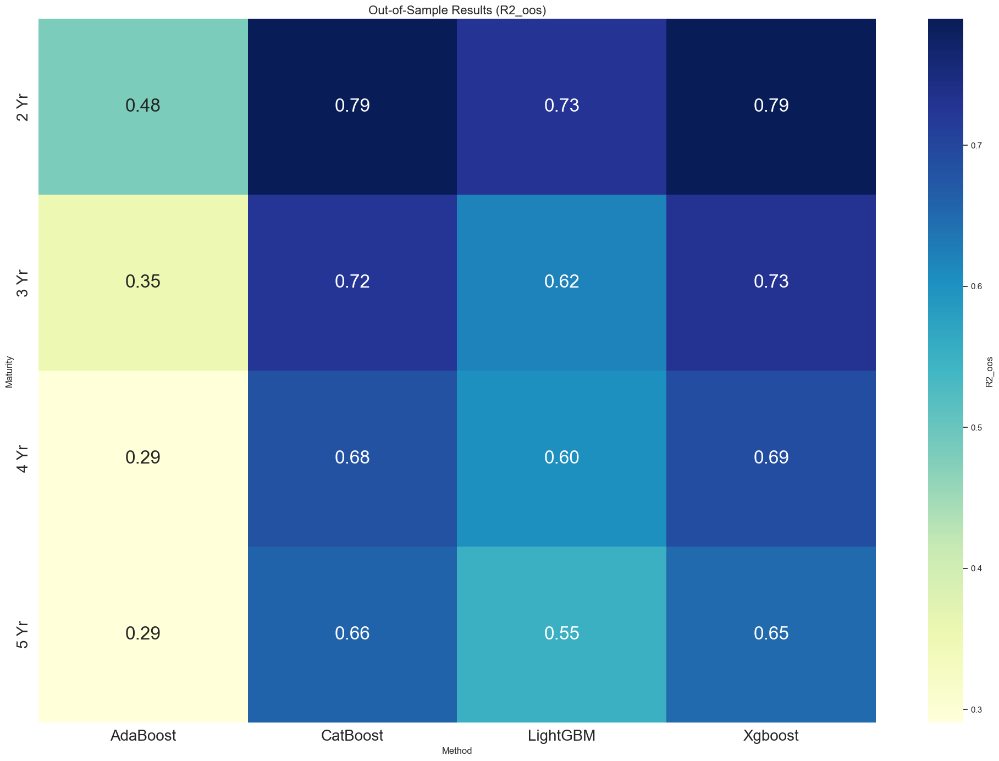

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_results_table_seaborn(results, desc):
    # Create the table data
    table_data = []
    for main_key in results:
        for sub_key in results[main_key]:
            mspe = results[main_key][sub_key]['MSPE']
            r2_oos = results[main_key][sub_key]['R2_oos']
            table_data.append([main_key, sub_key, mspe, r2_oos])

    # Create a DataFrame
    df = pd.DataFrame(table_data, columns=['Maturity', 'Method', 'MSPE', 'R2_oos'])

    # Set the figure size and style
    plt.figure(figsize=(20, 14))
    sns.set(style='whitegrid')

    # Create the heatmap
    ax = sns.heatmap(df.pivot_table(index='Maturity', columns='Method', values='MSPE'),
                cmap='YlGnBu', annot=True, fmt='.2f', cbar_kws={'label': 'MSPE'},
                annot_kws={'size': 24})

    # Set the plot title and labels
    plt.title('Out-of-Sample Results (MSPE)', fontsize=20)  # Larger title font size
    plt.xlabel('Method', fontsize=24)  # Larger axis labels
    plt.ylabel('Maturity', fontsize=24)

    # Here's the part that sets your x and y ticks' label size
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=20)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=20)

    # Adjust the plot layout and display
    plt.tight_layout()
    plt.savefig(f'Graph/{desc}_table_mse.png')
    plt.show()

    # Set the figure size and style
    plt.figure(figsize=(20, 14))
    sns.set(style='whitegrid')

    # Create the heatmap
    ax = sns.heatmap(df.pivot_table(index='Maturity', columns='Method', values='R2_oos'),
                cmap='YlGnBu', annot=True, fmt='.2f', cbar_kws={'label': 'R2_oos'},
                annot_kws={'size': 24})

    # Set the plot title and labels
    plt.title('Out-of-Sample Results (R2_oos)', fontsize=16)
    plt.xlabel('Method')
    plt.ylabel('Maturity')

    # Here's the part that sets your x and y ticks' label size
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=20)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=20)

    # Adjust the plot layout and display
    plt.tight_layout()
    plt.savefig(f'Graph/{desc}_table_results.png')
    plt.show()

plot_results_table_seaborn(results, desc='New_Models')

Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 28490.71it/s]


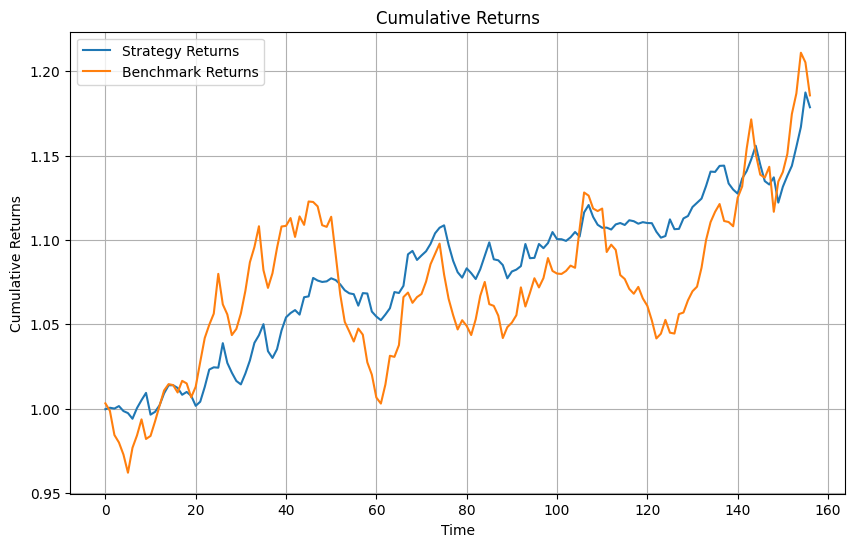

----------------------------------------------------------------
Strategy info by model AdaBoost
Cumulative Return: 17.87%
Sharpe Ratio: 0.63
Max Drawdown: 2.92%
Win Ratio: 56.05%
Annual Return: 1.28%
Annual Volatility: 2.01%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 26147.78it/s]


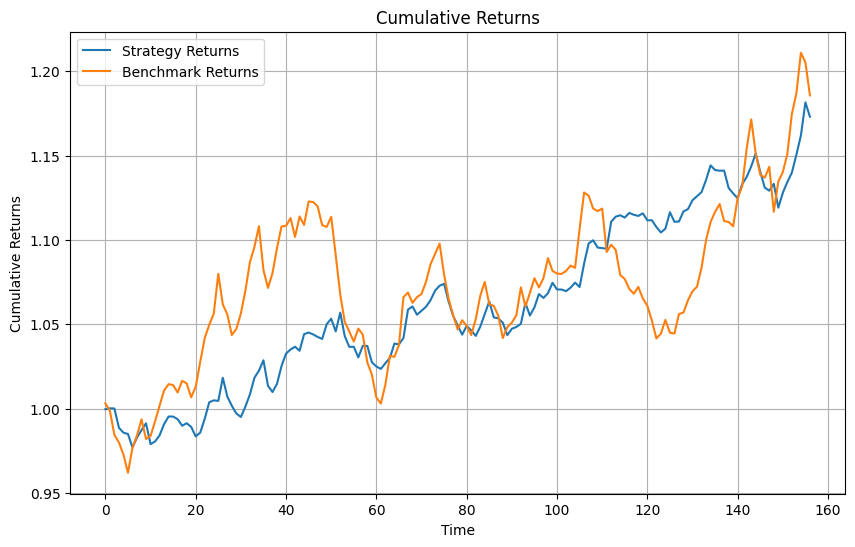

----------------------------------------------------------------
Strategy info by model LightGBM
Cumulative Return: 17.31%
Sharpe Ratio: 0.59
Max Drawdown: 3.16%
Win Ratio: 56.05%
Annual Return: 1.24%
Annual Volatility: 2.09%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 26186.25it/s]


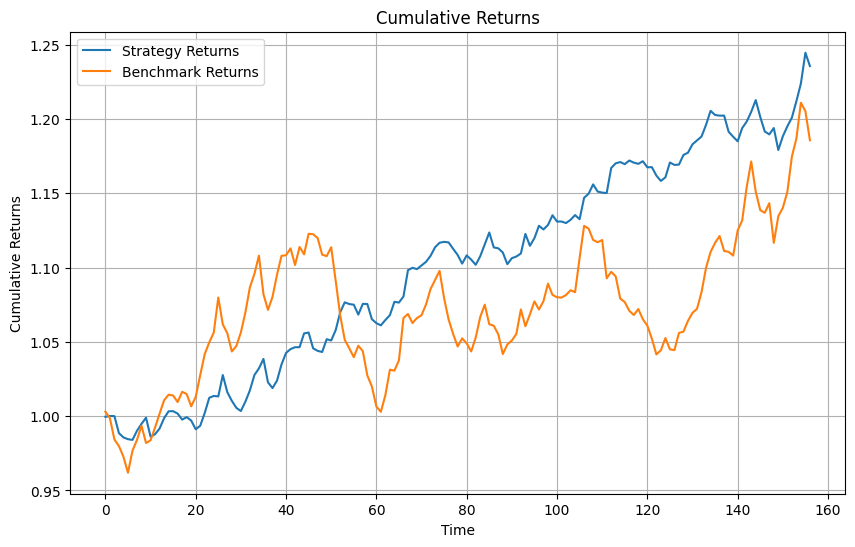

----------------------------------------------------------------
Strategy info by model Xgboost
Cumulative Return: 23.57%
Sharpe Ratio: 0.82
Max Drawdown: 2.77%
Win Ratio: 57.32%
Annual Return: 1.64%
Annual Volatility: 2.01%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 28484.55it/s]


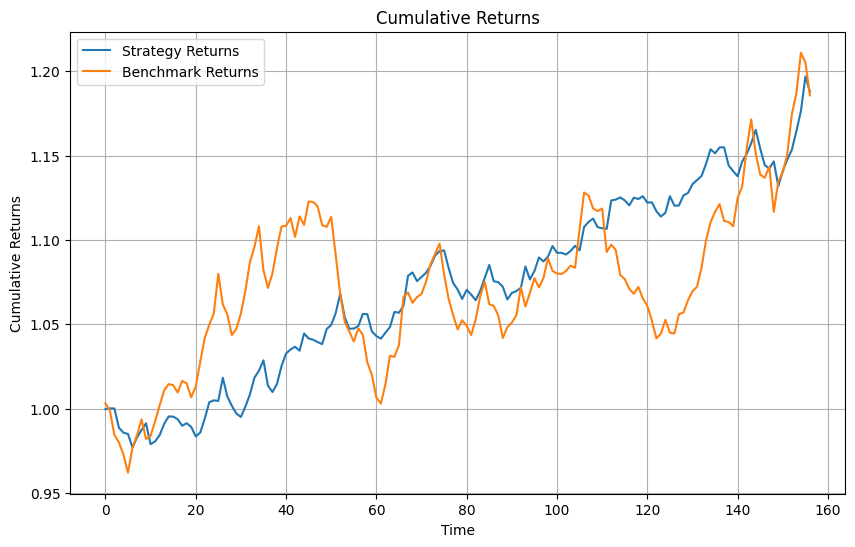

----------------------------------------------------------------
Strategy info by model CatBoost
Cumulative Return: 18.80%
Sharpe Ratio: 0.64
Max Drawdown: 2.86%
Win Ratio: 57.32%
Annual Return: 1.34%
Annual Volatility: 2.09%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.57%
Sharpe Ratio: 0.38
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


In [13]:
# Define your models
models = {
    'AdaBoost': AdaBoostRegressor(),
    'LightGBM': LGBMRegressor(n_jobs=-1),
    'Xgboost': XGBRegressor(n_jobs=-1),
    'CatBoost': CatBoostRegressor(verbose=False),
}

# # Replace any found characters with an underscore, or just remove them
# preprocessed_data_macro.columns = [pattern.sub('_', col) for col in preprocessed_data_macro.columns]

# Get the predicted excess returns
predicted_returns, dates = get_predicted_excess_returns_macro(preprocessed_data_macro, models, train_size=0.7, epochs=100, lr=1e-3, change_col=True)

# model_name = 'AdaBoost'
# model_name = 'LightGBM'
# model_name = 'Xgboost'
# model_name = 'CatBoost'

for model_name, model in models.items():

    # Create an instance of the DirectBondTradeBacktester class
    backtester = DirectBondTradeBacktester(predicted_returns, dates, commission_rate=2e-4, bond_prices=prices, initial_capital=1000000)

    # Run the backtest
    backtester.run(model_name=model_name)

    # Analyze the results
    # backtester.display_log()
    backtester.save_log('backtest_log.txt')
    backtester.calculate_benchmark_returns()
    backtester.plot_cumulative_returns(desc=f'{model_name} macro')
    backtester.calculate_metrics()
    backtester.print_metrics()

In [23]:
import pandas as pd
from functools import reduce

# Define your models
models = {
    'AdaBoost': AdaBoostRegressor(),
    'LightGBM': LGBMRegressor(n_jobs=-1),
    'Xgboost': XGBRegressor(n_jobs=-1),
    'CatBoost': CatBoostRegressor(verbose=False),
}

import re

# Create a regular expression pattern to match special JSON characters
pattern = re.compile(r'[\{\}\[\]:,]')

y_pred_lst = []

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()

    # Replace any found characters with an underscore, or just remove them
    X.columns = [pattern.sub('_', col) for col in X.columns]
        
    for model_name, model in models.items():
        _, _, y_pred, dateLst = recursive_forecast(X, y, model, desc=f'{maturity} - {model_name} - macro')
        df_i = pd.DataFrame({
            'date': dateLst,
            f'{model_name}_{maturity}_pred_return': y_pred,
        })
        y_pred_lst.append(df_i)

# Assuming your list of DataFrames is named 'dfs'
pred_df = reduce(lambda left, right: pd.merge(left, right, on='date'), y_pred_lst)

excess_ret_df = preprocessed_data_macro[[f'{maturity}_excess_return' for maturity in required_maturities[1:]]].reset_index(drop=False)

pred_df = pd.merge(pred_df, excess_ret_df, how='left', on='date')
pred_df.head()

2 Yr - AdaBoost - macro:   0%|          | 0/158 [00:00<?, ?it/s]

5 Yr - CatBoost - macro: 100%|██████████| 158/158 [00:01<00:00, 83.58it/s, Month=2002-11]


,date,AdaBoost_2 Yr_pred_return,LightGBM_2 Yr_pred_return,Xgboost_2 Yr_pred_return,CatBoost_2 Yr_pred_return,AdaBoost_3 Yr_pred_return,LightGBM_3 Yr_pred_return,Xgboost_3 Yr_pred_return,CatBoost_3 Yr_pred_return,AdaBoost_4 Yr_pred_return,...,Xgboost_4 Yr_pred_return,CatBoost_4 Yr_pred_return,AdaBoost_5 Yr_pred_return,LightGBM_5 Yr_pred_return,Xgboost_5 Yr_pred_return,CatBoost_5 Yr_pred_return,2 Yr_excess_return,3 Yr_excess_return,4 Yr_excess_return,5 Yr_excess_return
0,1989-10,4.211235,3.843069,3.688384,3.877057,4.861309,5.010496,4.872015,5.044116,4.756340,...,5.175555,5.314944,4.944502,5.150255,5.518916,5.253310,3.653176,4.839161,5.124039,4.952801
1,1989-11,3.782313,3.784379,3.802657,3.632750,4.736594,5.036989,4.766399,4.647162,4.835000,...,5.757252,4.856303,5.239457,5.061292,5.921967,5.046930,3.613801,4.814760,5.237164,5.167073
2,1989-12,3.768028,3.688058,3.418897,3.706997,4.802438,4.926681,5.097264,4.904239,4.938377,...,5.369021,5.081497,4.778634,5.700011,5.452956,5.045741,3.844253,5.213603,5.664529,5.720646
3,1990-01,4.124085,4.005286,4.079983,3.997063,4.738840,5.469224,5.278295,5.146563,5.261219,...,5.721088,5.690590,4.781508,6.277877,6.069329,5.556460,4.167225,5.726859,6.473913,6.696921
4,1990-02,4.148091,3.922858,4.245700,4.221793,4.841671,5.440091,5.495340,5.533313,5.092685,...,6.397174,5.983713,5.383228,5.874919,6.317507,6.352330,4.331439,5.881881,6.716543,6.937260


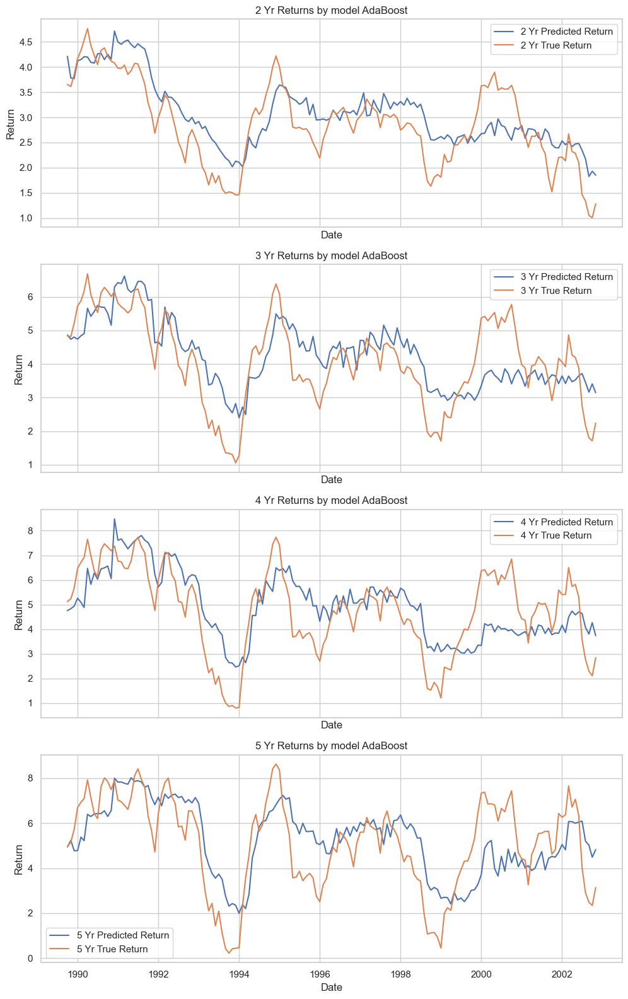

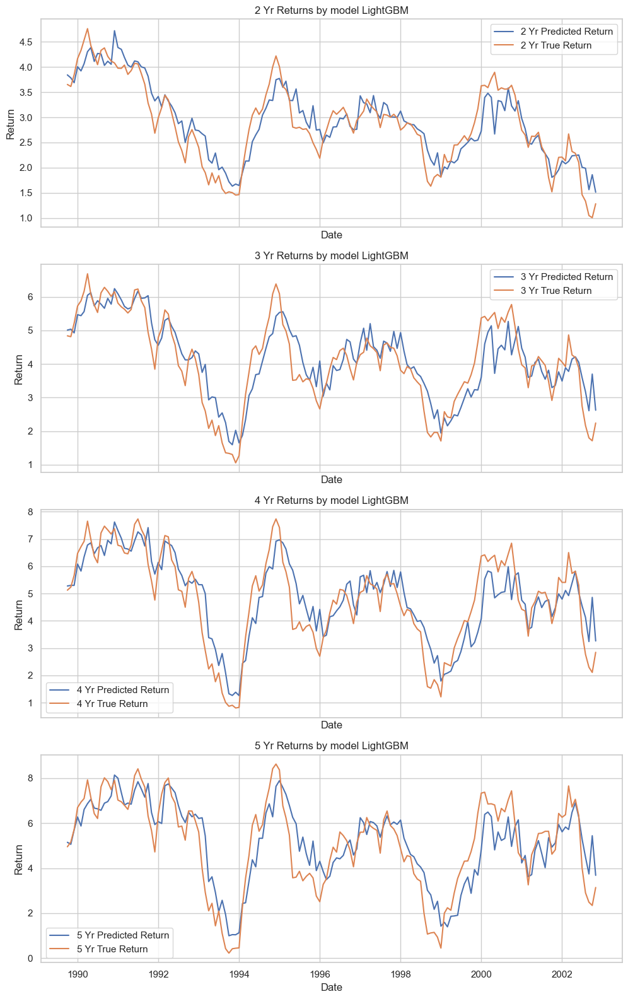

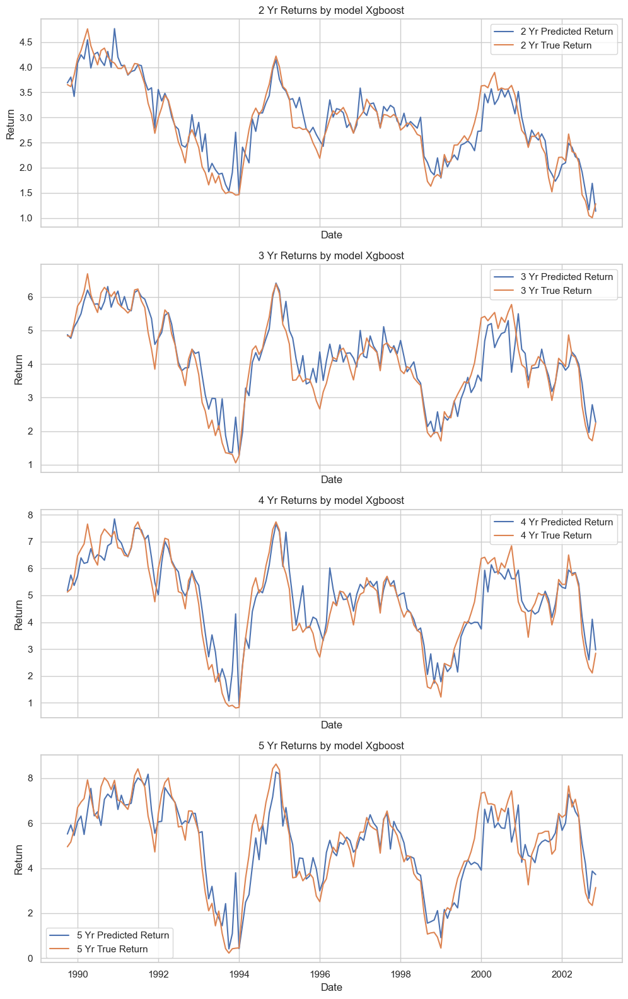

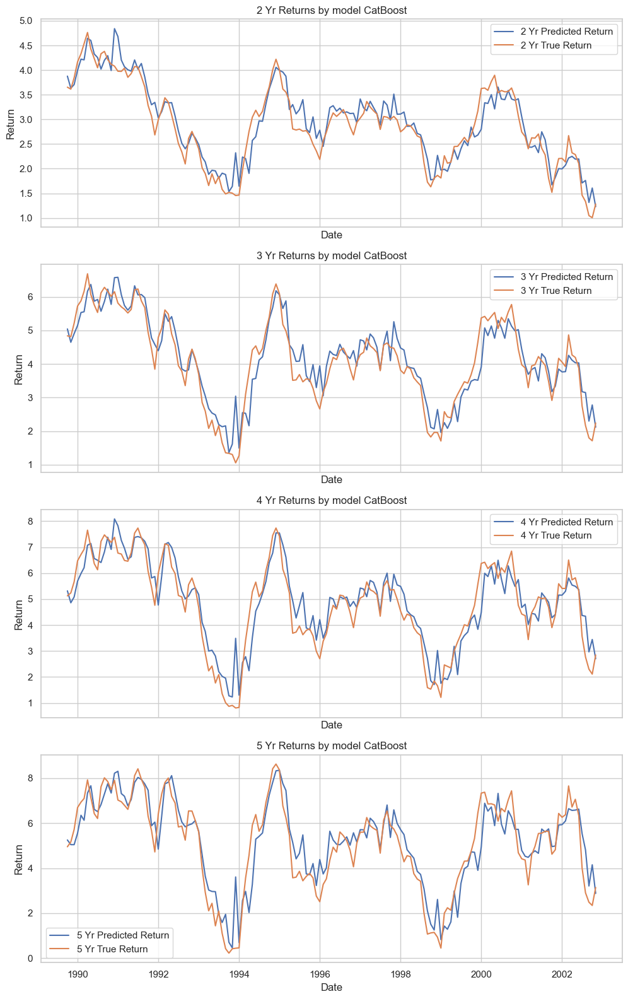

In [24]:
for model_name, _ in models.items():
    plot_pred_and_true_returns(pred_df, required_maturities[1:], model_name)

# Learning to Rank

# Recursive Forecasting with Ranking Models

This code consists of functions to perform recursive forecasting using ranking models such as LightGBM, XGBoost, and CatBoost. The recursive forecasting is applied to predict excess returns for different maturities in a financial dataset.

## Libraries and Preprocessing

- The code imports necessary libraries such as LightGBM, XGBoost, CatBoost, and sklearn.
- A regular expression pattern is created to match special characters commonly found in JSON data.

## Ranking Model Functions

### LightGBM Ranker
- `lightgbm_ranker`: Trains a LightGBM model for ranking based on input features and target variables.
- `lightgbm_ranker_forecast`: Performs recursive forecasting using a trained LightGBM ranker model.

### XGBoost Ranker
- `xgboost_ranker`: Trains an XGBoost model for ranking based on input features and target variables.
- `xgboost_ranker_forecast`: Performs recursive forecasting using a trained XGBoost ranker model.

### CatBoost Ranker
- `catboost_ranker`: Trains a CatBoost model for ranking based on input features and target variables.
- `catboost_ranker_forecast`: Performs recursive forecasting using a trained CatBoost ranker model.

## Recursive Forecasting Functions

These functions apply recursive forecasting using the respective ranking models for predicting excess returns. They take input data, train size, and other parameters to produce predicted returns for each maturity.

### `get_predicted_excess_returns_macro_lightgbm`
- Uses LightGBM ranker for recursive forecasting.
- Produces predicted excess returns for each maturity using bond and macro features.

### `get_predicted_excess_returns_macro_xgboost`
- Uses XGBoost ranker for recursive forecasting.
- Produces predicted excess returns for each maturity using bond and macro features.

### `get_predicted_excess_returns_macro_catboost`
- Uses CatBoost ranker for recursive forecasting.
- Produces predicted excess returns for each maturity using bond and macro features.

## Input Parameters

- `data`: Input DataFrame containing bond and macro features.
- `train_size`: Proportion of data to use for training the models.
- `change_col`: Flag to indicate whether to modify column names.

## Output

- Predicted excess returns and corresponding dates for each maturity using the specified ranking models.

In [20]:
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostRanker, Pool
from sklearn.model_selection import train_test_split
from tqdm import tqdm

import re

# Create a regular expression pattern to match special JSON characters
pattern = re.compile(r'[\{\}\[\]:,]')

def lightgbm_ranker(X, y, model_path):

    X, y = X.copy(), y.copy()
    X.index = pd.to_datetime(X.index)
    y.index = pd.to_datetime(y.index)

    y_ranked = y.groupby(y.index.year).apply(lambda x: pd.qcut(x, q=12, labels=False, duplicates='drop'))
    y_ranked = y_ranked.reset_index(level=0, drop=True)

    # Drop NaN values from y_ranked and the corresponding data points in X
    y_ranked = y_ranked.dropna()
    valid_indices = y_ranked.index
    X = X.loc[valid_indices]

    group_sizes = X.index.year.value_counts().sort_index().tolist()
    
    if os.path.exists(model_path):
        model = lgb.Booster(model_file=model_path)
    else:
        # Prepare data for LightGBM
        train_data = lgb.Dataset(X, label=y_ranked, group=group_sizes)
        
        # Set LightGBM parameters for ranking
        params = {
            'objective': 'lambdarank',
            'metric': 'ndcg',
            'eval_at': [1, 3, 5],
            'verbosity': -1
        }
        
        # Train LightGBM model
        model = lgb.train(params, train_data)
        
        # Save trained model
        model.save_model(model_path)
    
    return model

# Function for XGBoost ranker
def xgboost_ranker(X, y, model_path):

    X, y = X.copy(), y.copy()
    X.index = pd.to_datetime(X.index)
    y.index = pd.to_datetime(y.index)

    y_ranked = y.groupby(y.index.year).apply(lambda x: pd.qcut(x, q=12, labels=False, duplicates='drop'))
    y_ranked = y_ranked.reset_index(level=0, drop=True)

    # Drop NaN values from y_ranked and the corresponding data points in X
    y_ranked = y_ranked.dropna()
    valid_indices = y_ranked.index
    X = X.loc[valid_indices]

    group_sizes = X.index.year.value_counts().sort_index().tolist()

    if os.path.exists(model_path):
        model = xgb.Booster(model_file=model_path)
    else:
        train_data = xgb.DMatrix(X, label=y_ranked)
        train_data.set_group(group_sizes)

        params = {
            'objective': 'rank:ndcg',
            'eval_metric': 'ndcg@1-',
            'verbosity': 0
        }

        model = xgb.train(params, train_data)
        model.save_model(model_path)

    return model

# Function for CatBoost ranker
def catboost_ranker(X, y, model_path):

    X, y = X.copy(), y.copy()
    X.index = pd.to_datetime(X.index)
    y.index = pd.to_datetime(y.index)

    y_ranked = y.groupby(y.index.year).apply(lambda x: pd.qcut(x, q=12, labels=False, duplicates='drop'))
    y_ranked = y_ranked.reset_index(level=0, drop=True)

    # Drop NaN values from y_ranked and the corresponding data points in X
    y_ranked = y_ranked.dropna()
    valid_indices = y_ranked.index
    X = X.loc[valid_indices]

    if os.path.exists(model_path):
        model = CatBoostRanker().load_model(model_path)
    else:
        train_pool = Pool(X, y_ranked, group_id=X.index.year.tolist())

        params = {
            'loss_function': 'YetiRank',
            'verbose': False
        }

        model = CatBoostRanker(**params)
        model.fit(train_pool)
        model.save_model(model_path)

    return model


# def lightgbm_ranker(X, y, model_path):
#     X, y = X.copy(), y.copy()
#     X.index = pd.to_datetime(X.index)
#     y.index = pd.to_datetime(y.index)

#     y = pd.qcut(y, q=10, labels=False, duplicates='drop')

#     if os.path.exists(model_path):
#         model = lgb.Booster(model_file=model_path)
#     else:
#         # Prepare data for LightGBM
#         train_data = lgb.Dataset(X, label=y, group=[X.shape[0]])

#         # Set LightGBM parameters for ranking
#         params = {
#             'objective': 'lambdarank',
#             'metric': 'ndcg',
#             'eval_at': [1, 3, 5],
#             'verbosity': -1
#         }

#         # Train LightGBM model
#         model = lgb.train(params, train_data)

#         # Save trained model
#         model.save_model(model_path)

#     return model

# # Function for XGBoost ranker
# def xgboost_ranker(X, y, model_path):
#     X, y = X.copy(), y.copy()
#     X.index = pd.to_datetime(X.index)
#     y.index = pd.to_datetime(y.index)

#     y = pd.qcut(y, q=10, labels=False, duplicates='drop')

#     if os.path.exists(model_path):
#         model = xgb.Booster(model_file=model_path)
#     else:
#         train_data = xgb.DMatrix(X, label=y)
#         train_data.set_group([X.shape[0]])

#         params = {
#             'objective': 'rank:ndcg',
#             'eval_metric': 'ndcg@1-',
#             'verbosity': 0
#         }

#         model = xgb.train(params, train_data)
#         model.save_model(model_path)

#     return model

# # Function for CatBoost ranker
# def catboost_ranker(X, y, model_path):
#     X, y = X.copy(), y.copy()
#     X.index = pd.to_datetime(X.index)
#     y.index = pd.to_datetime(y.index)

#     y = pd.qcut(y, q=10, labels=False, duplicates='drop')

#     if os.path.exists(model_path):
#         model = CatBoostRanker().load_model(model_path)
#     else:
#         train_pool = Pool(X, y, group_id=[0] * X.shape[0])

#         params = {
#             'loss_function': 'YetiRank',
#             'verbose': False
#         }

#         model = CatBoostRanker(**params)
#         model.fit(train_pool)
#         model.save_model(model_path)

#     return model


# Function for recursive forecasting with LightGBM ranker
def lightgbm_ranker_forecast(X, y, maturity, train_size=0.7):
    # Initialize variables
    n_samples = X.shape[0]
    train_end = int(n_samples * train_size)
    start_month = X.index[train_end]
    monthLst = np.sort(pd.unique(X.index))
    start_idx = np.where(start_month == monthLst)[0][0]
    y_pred_list = []
    dateLst = []
    model_folder = f"Model/{maturity} - LightGBM Rank"
    os.makedirs(model_folder, exist_ok=True)

    # Iterate over months for forecasting
    with tqdm(total=len(monthLst)-start_idx-1, desc=f'{maturity} - LightGBM Rank') as pbar:
        for i in range(start_idx, len(monthLst)-1):
            # Train-test split for each month
            X_train, y_train = X.loc[X.index <= monthLst[i]], y.loc[y.index <= monthLst[i]]
            test_X_current = X.loc[X.index == monthLst[i+1]]
            start_date, end_date = monthLst[0], monthLst[i]
            model_name = f"LightGBM Rank_{start_date}_{end_date}"
            model_path = os.path.join(model_folder, f"{model_name}.txt")
            
            # Load pretrained model if exists, else train a new model
            if os.path.exists(model_path):
                model = lgb.Booster(model_file=model_path)
            else:
                model = lightgbm_ranker(X_train, y_train, model_path)
            
            # Make predictions on test_X_current
            y_pred = model.predict(test_X_current)
            
            # Append predictions and update progress bar
            y_pred_list.append(y_pred)
            dateLst.append(end_date)
            pbar.update(1)

    return np.concatenate(y_pred_list), dateLst


# Function for recursive forecasting with XGBoost ranker
def xgboost_ranker_forecast(X, y, maturity, train_size=0.7):

    # Initialize variables
    n_samples = X.shape[0]
    train_end = int(n_samples * train_size)
    start_month = X.index[train_end]
    monthLst = np.sort(pd.unique(X.index))
    start_idx = np.where(start_month == monthLst)[0][0]
    y_pred_list = []
    dateLst = []
    model_folder = f"Model/{maturity}_XGBoost Rank"
    os.makedirs(model_folder, exist_ok=True)

    # Iterate over months for forecasting
    with tqdm(total=len(monthLst)-start_idx-1, desc=f'{maturity} - XGBoost Rank') as pbar:
        for i in range(start_idx, len(monthLst)-1):
            # Train-test split for each month
            X_train, y_train = X.loc[X.index <= monthLst[i]], y.loc[y.index <= monthLst[i]]
            test_X_current = X.loc[X.index == monthLst[i+1]]
            start_date, end_date = monthLst[0], monthLst[i]
            model_name = f"XGBoost Rank_{start_date}_{end_date}"
            model_path = os.path.join(model_folder, f"{model_name}.json")
            
            # Load pretrained model if exists, else train a new model
            if os.path.exists(model_path):
                model = xgb.Booster(model_file=model_path)
            else:
                model = xgboost_ranker(X_train, y_train, model_path)
            
            # Make predictions on test_X_current
            test_data = xgb.DMatrix(test_X_current)
            y_pred = model.predict(test_data)
            
            # Append predictions and update progress bar
            y_pred_list.append(y_pred)
            dateLst.append(end_date)
            pbar.update(1)
    
    return np.concatenate(y_pred_list), dateLst


# Function for recursive forecasting with CatBoost ranker
def catboost_ranker_forecast(X, y, maturity, train_size=0.7):
    # Initialize variables
    n_samples = X.shape[0]
    train_end = int(n_samples * train_size)
    start_month = X.index[train_end]
    monthLst = np.sort(pd.unique(X.index))
    start_idx = np.where(start_month == monthLst)[0][0]
    y_pred_list = []
    dateLst = []
    model_folder = f"Model/{maturity}_CatBoost Rank"
    os.makedirs(model_folder, exist_ok=True)

    # Iterate over months for forecasting
    with tqdm(total=len(monthLst)-start_idx-1, desc=f'{maturity} - CatBoost Rank') as pbar:
        for i in range(start_idx, len(monthLst)-1):
            # Train-test split for each month
            X_train, y_train = X.loc[X.index <= monthLst[i]], y.loc[y.index <= monthLst[i]]
            test_X_current = X.loc[X.index == monthLst[i+1]]
            start_date, end_date = monthLst[0], monthLst[i]
            model_name = f"CatBoost Rank_{start_date}_{end_date}"
            model_path = os.path.join(model_folder, f"{model_name}.cbm")
            
            # Load pretrained model if exists, else train a new model
            if os.path.exists(model_path):
                model = CatBoostRanker().load_model(model_path)
            else:
                model = catboost_ranker(X_train, y_train, model_path)
            
            # Make predictions on test_X_current
            y_pred = model.predict(test_X_current)
            
            # Append predictions and update progress bar
            y_pred_list.append(y_pred)
            dateLst.append(end_date)
            pbar.update(1)
    
    return np.concatenate(y_pred_list), dateLst


def get_predicted_excess_returns_macro_lightgbm(data, train_size=0.7, change_col=True):
    
    predicted_returns = {}
    
    # Loop through each maturity except the first one
    for maturity in required_maturities[1:]:
        # Extract features (bond and macro) and target for the current maturity
        X = data[feature_cols+macro_cols]
        y = data[f'{maturity}_excess_return']
        
        if change_col:
            # Replace any found characters with an underscore, or just remove them
            X.columns = [pattern.sub('_', col) for col in X.columns]
        
        predicted_returns[maturity] = {}
        
        # Perform recursive forecasting and get predictions and dates
        preds, dates = lightgbm_ranker_forecast(X, y, maturity, train_size)
        
        # Store predicted returns for the current model
        predicted_returns[maturity]['LightGBM Rank'] = {'pred_return': preds}
    
    return predicted_returns, dates


def get_predicted_excess_returns_macro_xgboost(data, train_size=0.7, change_col=False):

    predicted_returns = {}
    
    # Loop through each maturity except the first one
    for maturity in required_maturities[1:]:
        # Extract features (bond and macro) and target for the current maturity
        X = data[feature_cols+macro_cols]
        y = data[f'{maturity}_excess_return']
        
        if change_col:
            # Replace any found characters with an underscore, or just remove them
            X.columns = [pattern.sub('_', col) for col in X.columns]
        
        predicted_returns[maturity] = {}
        
        # Perform recursive forecasting and get predictions and dates
        preds, dates = xgboost_ranker_forecast(X, y, maturity, train_size)
        
        # Store predicted returns for the current model
        predicted_returns[maturity]['XGBoost Rank'] = {'pred_return': preds}
    
    return predicted_returns, dates


def get_predicted_excess_returns_macro_catboost(data, train_size=0.7, change_col=False):
    predicted_returns = {}
    
    # Loop through each maturity except the first one
    for maturity in required_maturities[1:]:
        # Extract features (bond and macro) and target for the current maturity
        X = data[feature_cols+macro_cols]
        y = data[f'{maturity}_excess_return']
        
        if change_col:
            # Replace any found characters with an underscore, or just remove them
            X.columns = [pattern.sub('_', col) for col in X.columns]
        
        predicted_returns[maturity] = {}
        
        # Perform recursive forecasting and get predictions and dates
        preds, dates = catboost_ranker_forecast(X, y, maturity, train_size)
        
        # Store predicted returns for the current model
        predicted_returns[maturity]['CatBoost Rank'] = {'pred_return': preds}
    
    return predicted_returns, dates

In [18]:
# Dictionary to store results
results = {}

# Iterate over required maturities for bond excess returns
for maturity in required_maturities[1:]:
    # Copying target variable and feature columns
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()

    # Replace any found characters with an underscore, or just remove them
    X.columns = [pattern.sub('_', col) for col in X.columns]

    # Initialize results dictionary for current maturity
    results[maturity] = {}
    
    # Assuming 'date' column represents the query groups
    query_col = 'date'
    
    # Perform recursive forecasting for each ranker model
    # results[maturity]['LightGBM Rank'] = lightgbm_ranker_forecast(X, y, maturity)
    results[maturity]['XGBoost Rank'] = xgboost_ranker_forecast(X, y, maturity)
    # results[maturity]['CatBoost Rank'] = catboost_ranker_forecast(X, y, maturity)

5 Yr - XGBoost Rank: 100%|██████████| 158/158 [00:13<00:00, 11.83it/s]


Calculating Benchmark Returns: 100%|██████████| 157/157 [00:00<00:00, 33976.87it/s]


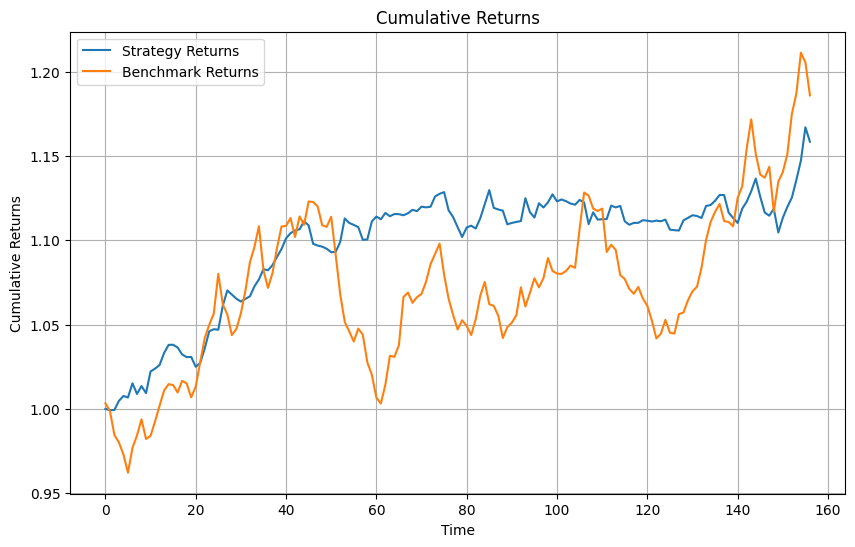

----------------------------------------------------------------
Strategy info by model CatBoost Rank
Cumulative Return: 15.85%
Sharpe Ratio: 0.66
Max Drawdown: 2.81%
Win Ratio: 56.41%
Annual Return: 1.14%
Annual Volatility: 1.74%
----------------------------------------------------------------
Benchmark info
Cumulative Return: 18.60%
Sharpe Ratio: 0.39
Max Drawdown: 10.67%
Win Ratio: 53.50%
Annual Return: 1.37%
Annual Volatility: 3.55%


In [22]:
# Get the predicted excess returns
# predicted_returns, dates = get_predicted_excess_returns_macro_lightgbm(preprocessed_data_macro, train_size=0.7, change_col=True)
# predicted_returns, dates = get_predicted_excess_returns_macro_xgboost(preprocessed_data_macro, train_size=0.7, change_col=True)
predicted_returns, dates = get_predicted_excess_returns_macro_catboost(preprocessed_data_macro, train_size=0.7, change_col=True)

# Create an instance of the DirectBondTradeBacktester class
# backtester = DirectBondTradeBacktester(predicted_returns, dates, commission_rate=0, bond_prices=prices, initial_capital=1000000)

# model_name = 'LightGBM Rank'
# model_name = 'XGBoost Rank'
model_name = 'CatBoost Rank'

# Run the backtest
backtester.run(model_name=model_name)

# Analyze the results
# backtester.display_log()
backtester.save_log('backtest_log.txt')
backtester.calculate_benchmark_returns()
backtester.plot_cumulative_returns(desc=f'{model_name} macro')
backtester.calculate_metrics()
backtester.print_metrics()

In [23]:
import pandas as pd
from functools import reduce

import re

# Create a regular expression pattern to match special JSON characters
pattern = re.compile(r'[\{\}\[\]:,]')

y_pred_lst = []

predicted_returns, dates = get_predicted_excess_returns_macro_lightgbm(preprocessed_data_macro, train_size=0.7, change_col=True)
# predicted_returns, dates = get_predicted_excess_returns_macro_xgboost(preprocessed_data_macro, train_size=0.7, change_col=True)
# predicted_returns, dates = get_predicted_excess_returns_macro_catboost(preprocessed_data_macro, train_size=0.7, change_col=True)

model_name = 'LightGBM Rank'
# model_name = 'XGBoost Rank'
# model_name = 'CatBoost Rank'

for maturity in required_maturities[1:]:
    y = preprocessed_data_macro[f'{maturity}_excess_return'].copy()
    X = preprocessed_data_macro[feature_cols+macro_cols].copy()

    # Replace any found characters with an underscore, or just remove them
    X.columns = [pattern.sub('_', col) for col in X.columns]

    df_i = pd.DataFrame({
        'date': dates,
        f'{model_name}_{maturity}_pred_return': predicted_returns[maturity][model_name]['pred_return'],
    })
    y_pred_lst.append(df_i)

# Assuming your list of DataFrames is named 'dfs'
pred_df = reduce(lambda left, right: pd.merge(left, right, on='date'), y_pred_lst)

excess_ret_df = preprocessed_data_macro[[f'{maturity}_excess_return' for maturity in required_maturities[1:]]].reset_index(drop=False)

pred_df = pd.merge(pred_df, excess_ret_df, how='left', on='date')
pred_df.head()

5 Yr - LightGBM Rank: 100%|██████████| 158/158 [00:03<00:00, 41.90it/s]


,date,LightGBM Rank_2 Yr_pred_return,LightGBM Rank_3 Yr_pred_return,LightGBM Rank_4 Yr_pred_return,LightGBM Rank_5 Yr_pred_return,2 Yr_excess_return,3 Yr_excess_return,4 Yr_excess_return,5 Yr_excess_return
0,1989-10,-2.085924,-2.125047,-2.916517,-3.187129,3.653176,4.839161,5.124039,4.952801
1,1989-11,-0.805513,-0.965488,-1.591482,-1.617677,3.613801,4.814760,5.237164,5.167073
2,1989-12,-2.508049,-2.816447,-1.791158,-2.102933,3.844253,5.213603,5.664529,5.720646
3,1990-01,-2.905493,-2.511389,-1.247992,-1.898893,4.167225,5.726859,6.473913,6.696921
4,1990-02,-1.337536,-1.885102,-2.742863,-2.143107,4.331439,5.881881,6.716543,6.937260


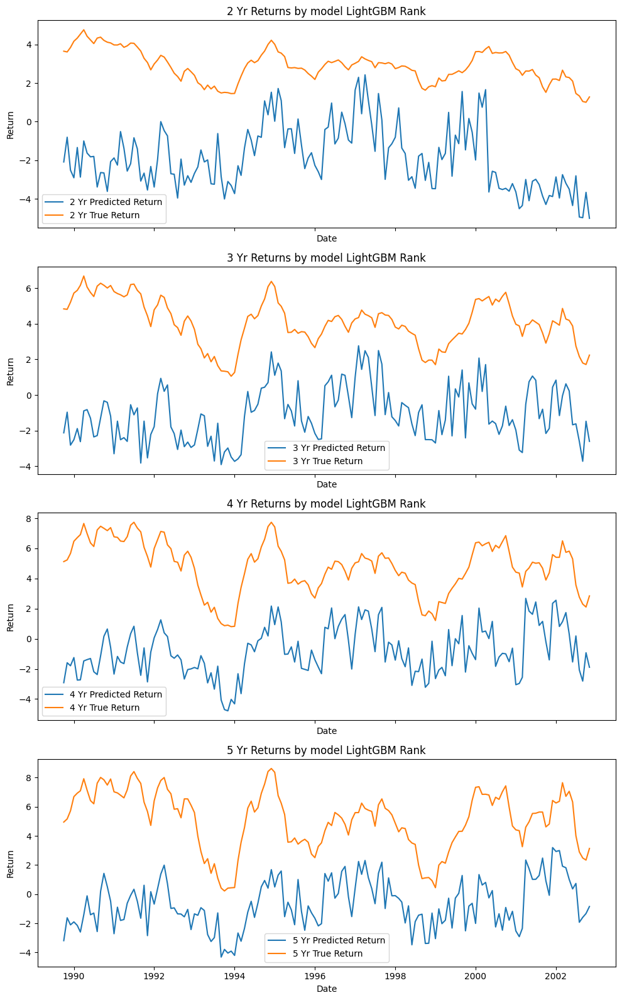

In [24]:
plot_pred_and_true_returns(pred_df, required_maturities[1:], model_name)

In [13]:
import os
import shutil

def delete_folders_with_substring(path, substring):
    # Check if the path exists
    if not os.path.exists(path):
        print(f"The path '{path}' does not exist.")
        return

    # Get a list of all folders under the specified path
    folders = [folder for folder in os.listdir(path) if os.path.isdir(os.path.join(path, folder))]

    # Iterate over each folder
    for folder in folders:
        # Check if the folder name contains the specified substring
        if substring in folder:
            folder_path = os.path.join(path, folder)
            try:
                # Delete the folder and its contents
                shutil.rmtree(folder_path)
                print(f"Deleted folder: {folder_path}")
            except OSError as e:
                print(f"Error deleting folder '{folder_path}': {e}")

    print("Folder deletion complete.")

In [31]:
delete_folders_with_substring('Model/', 'Rank')

Deleted folder: Model/2 Yr - LightGBM Rank
Folder deletion complete.
